# swave_stereo(v2)
This program reads each mono wav file from the data_path and store the dual channel stereo wav in the stereo_path. Then each stereo wav file is read again and the channels are seperated. Each channel can then be visualized.

# Importing packages

In [174]:
import matplotlib
#matplotlib.use("TkAgg")
from scipy.io import wavfile
from scipy import signal
from scipy.signal import blackman
#from matplotlib import mlab
from matplotlib import pyplot as plt
import numpy as np
#from numpy.lib import stride_tricks
from pylab import *
from struct import pack
#import pywt
from scipy.fftpack import dct
#from struct import pack
import wave
from scipy.io import wavfile
import os
#import glob

import gc
import multiprocessing as mp
import resource 
import csv
import itertools

import pandas as pd
import ipywidgets as widgets

gc.enable()

flag = 0
date = '20211112'#'20210401'
data_path = 'data/'
mono_path = data_path + "wav/"
stereo_path = data_path + "stereo/"

mono_file_path = mono_path + date + "/"
stereo_file_path = stereo_path + date + "/"

sweep_path = data_path + "sweep/"
sweep_time_path = sweep_path + date + "/"

aud_path = data_path + "aud_times/"
aud_time_path = aud_path + date + "/"

visual_path = 'visual/'

#print os.path.splitext("20171025/data/")[0]

In [175]:
from IPython.core.display import display, HTML 
display(HTML("<style>.container { width:75% !important; }</style>"))

%config IPCompleter.greedy=True

# Checking memory usage

In [176]:
def mem():
    print('Memory usage  : %2.2f MB' %round(resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1024.0,1))

# Converting data to stereo

In [177]:
if not os.path.exists(stereo_file_path):
    os.mkdir(stereo_file_path,0o777)

for filename in os.listdir(mono_file_path):
    print (filename)
    samplerate, data = wavfile.read(mono_file_path + filename)
    rate = samplerate
    samples = len(data) 
    
    data_l = data.reshape(int(samples/2),2)[::2]
    data_r = data.reshape(int(samples/2),2)[1::2]
    
    wv = wave.open(stereo_file_path + filename,'w')
    wv.setparams((2, 2, rate, 0, 'NONE', 'Uncompressed'))
    
    wvData = np.hstack((data_l.reshape(-1, 1), data_r.reshape(-1,1)))
    
    wv.writeframes(wvData)
    wv.close()
    gc.collect()
    
print ('All wav files have been converted to dual channel stereo')

20211112_184744_338.wav
20211112_175136_959.wav
20211112_175144_479.wav
20211112_184628_022.wav
20211112_184701_935.wav
20211112_184609_930.wav
20211112_184617_452.wav
20211112_184654_419.wav
20211112_175153_694.wav
20211112_184736_836.wav
20211112_184754_336.wav
20211112_184710_415.wav
All wav files have been converted to dual channel stereo


In [178]:
gc.collect()

0

# Read capture times

In [179]:
sessions = []
f = open(data_path + "capture_time.txt")
for rows in f.read().splitlines():
    sessions.append(rows.split('-'))
    
f.close()

# Select the desired session for analysis

In [180]:
session_list = []
line_no = 0
for row in sessions:
    if row[0] != '' and row[1] != '':
        starttime = datetime.datetime.strptime(row[0],'%Y/%m/%d %H:%M:%S.%f')
        endtime = datetime.datetime.strptime(row[1],'%Y/%m/%d %H:%M:%S.%f')
    #print starttime
    if starttime.date() == datetime.datetime.strptime(date,'%Y%m%d').date() : #Check if sessions available which matches the experiment date
        line_no = line_no + 1
        print ("(", line_no, ")", "\t", starttime, "-", endtime)
        #session_list.append(row[0] + "-" + row[1])
        session_list.append([starttime,endtime])
        
#print ("Plese register", str(ex[0]))
print ("Please input the session numbers. Separate them with commas. Confirm the start and end times using the experiment note.")
session = input("Session ") 
print ("You have chosen the sessions ", session)
#session = list(map(int, session))
#selected_session = session_list[int(session)-1]

( 1 ) 	 2021-11-12 17:51:36.922000 - 2021-11-12 17:51:53.668000
( 2 ) 	 2021-11-12 18:46:09.867000 - 2021-11-12 18:46:27.976000
( 3 ) 	 2021-11-12 18:46:54.170000 - 2021-11-12 18:47:10.353000
( 4 ) 	 2021-11-12 18:47:36.599000 - 2021-11-12 18:47:54.273000
Please input the session numbers. Separate them with commas. Confirm the start and end times using the experiment note.
Session 2
You have chosen the sessions  2


In [181]:
session = session.split(",")

In [182]:
session = list(map(int,session))

In [183]:
selected_session =[]
for s in session:
    selected_session.append(session_list[s-1])

In [184]:
selected_session

[[datetime.datetime(2021, 11, 12, 18, 46, 9, 867000),
  datetime.datetime(2021, 11, 12, 18, 46, 27, 976000)]]

# Make a list of wav files in the selected session

In [185]:
def wav_list_maker():
    file_list = []
    for s in selected_session:
        for filename in os.listdir(stereo_file_path):
            t = filename.split('.')[0]
            filetime = datetime.datetime.strptime(t,'%Y%m%d_%H%M%S_%f')
            if filetime >= s[0]- datetime.timedelta(seconds=1) and filetime <= s[1] + datetime.timedelta(seconds=1):#add seconds occationally
                file_list.append(filename)
    return file_list

In [186]:
wav_filelist = wav_list_maker()

In [187]:
wav_filelist #= ['20211014_175217_996.wav']

['20211112_184628_022.wav',
 '20211112_184609_930.wav',
 '20211112_184617_452.wav']

In [188]:
selected_session

[[datetime.datetime(2021, 11, 12, 18, 46, 9, 867000),
  datetime.datetime(2021, 11, 12, 18, 46, 27, 976000)]]

In [189]:
wav_filelist.sort()

In [190]:
data_left = []
data_right = []

for audio_file in wav_filelist:#os.listdir(stereo_file_path):
    #audio_file = "20210906_171503_622.wav"
    #print(audio_file)
    #samplerate, data = wavfile.read('20171025/data/' + filename)
    audio_name = os.path.splitext(audio_file)[0]
    
     
    samplerate, data = wavfile.read(stereo_file_path + audio_file)

    data_left.extend(data[:, 0])
    data_right.extend(data[:, 1])
    #break
data_left = np.array(data_left)
data_right = np.array(data_right)
    
    #data_left = data[:, 0]
    #data_right = data[:, 1]

    #data_left = np.append(data_left[0],data_left[1:] - 0.97*data_left[:-1])
    #data_right = np.append(data_right[0],data_right[1:] - 0.97*data_right[:-1])
    #data_left = np.square(data_left)
    #data_right = np.square(data_right)


    #data = np.subtract(data_left,data_right)

    #data1 = np.absolute(data)

    #data2 = np.sqrt(data1)
    #data_left = filter_signal(data_left)
    #data_right = filter_signal(data_right)
    #break

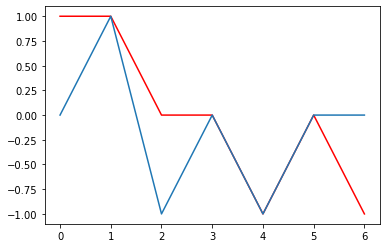

In [191]:
plt.plot(data_left[6020:6027],color="red")
plt.plot(data_right[6020:6027])
plt.show()

In [193]:
# Bandpass filter

from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=2):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

def filter_signal(sweep_signal):
    #filtered_sweep_signals = []
    #print sweep_signals
    #for sig in sweep_signals:
    filtered_sweep_signals = butter_bandpass_filter(sweep_signal,17000,22000,samplerate)
    return filtered_sweep_signals

In [194]:
#data_left = filter_signal(data_left)
#data_right = filter_signal(data_right)

In [195]:
def visualize_fft(data):
    times = np.arange(len(data))/float(samplerate)

    plt.close("all")

    Fs = 192000#5000*2.#10000.
    NFFT = 4096#int(16384/2)#min(4096, len(data))#32768
    noverlap = NFFT - NFFT/10#NFFT /2 #fft size
    pad_to = NFFT * 16
    dynamicRange = 30#30 #change this to change the color scale. 
    vmin = 20*np.log10(np.max(data)) - dynamicRange

    #window=blackman(NFFT)
    #window=signal.nuttall(NFFT)
    #window=np.hamming(NFFT)
    window = np.hanning(NFFT)

    cmap = plt.get_cmap('magma')

    vmin = data_right.min()
    vmax = data_right.max()

    Pxx, freqs, times, cax = plt.specgram(data, NFFT=NFFT, window=window,vmin=-50, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', pad_to=pad_to, cmap=cmap)
    #print(len(Pxx))
    #Pxx_left, freqs_left, times_left, cax_left = plt.specgram(data_left, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx_right, freqs_right, times_right, cax_right = plt.specgram(data_right, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx = np.absolute(np.subtract(Pxx_left,Pxx_left))
    #print Pxx
    #f, t, Sxx = signal.spectrogram(data_right, Fs)

    #print type(Pxx)
    #plt.figure(figsize=(20,10))
    #plt.figure(figsize=(20,10))
    axes_spec = plt.gca()
    #axes_spec.set_xlim([2.8, 7.5])
    axes_spec.set_ylim([17000, 22000])#18500])

    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    #plt.pcolormesh(t, f, Sxx, vmax = 1e-6)
    #plt.show()

    plt.colorbar(cax, label='(dB)').ax.yaxis.set_label_position('left')

    plt.tight_layout()
    plt.show()
    #plt.savefig('swave_sweep.png',dpi=600)
    return Pxx, freqs, times

# Signal segmentation v1.0

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:7555: RuntimeWarning: divide by zero encountered in log10
  Z = 20. * np.log10(spec)


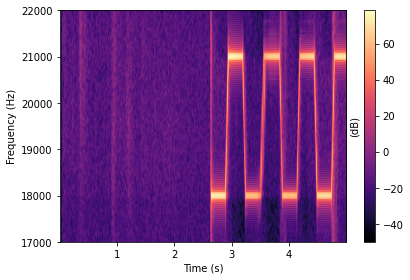

In [196]:
selected_data = data_right[int(0*192000):5*192000]
Pxx,freqs,times = visualize_fft(selected_data)

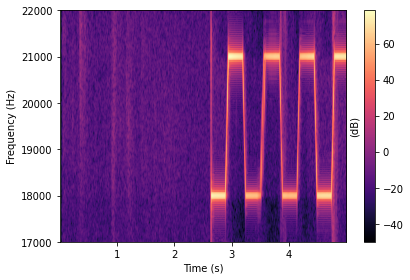

In [197]:
selected_data = data_left[int(0*192000):5*192000]
Pxx,freqs,times = visualize_fft(selected_data)

In [81]:
gc.collect()

4467

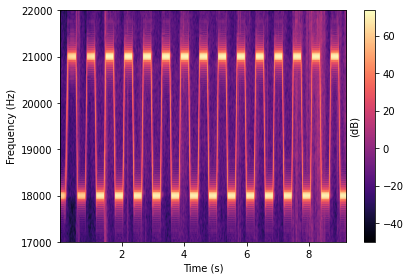

In [198]:
selected_data = data_right[int(3.3*192000):int(12.5*192000)]
Pxx,freqs,times = visualize_fft(selected_data)

In [199]:
gc.collect()

16242

In [200]:
gc.collect()

0

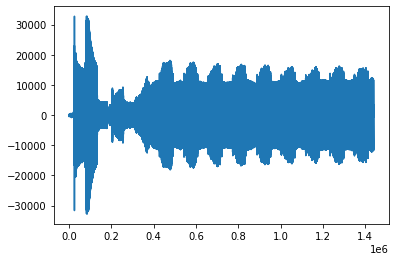

In [201]:
plt.plot(data_left[int(2.5*192000):int(10*192000)])

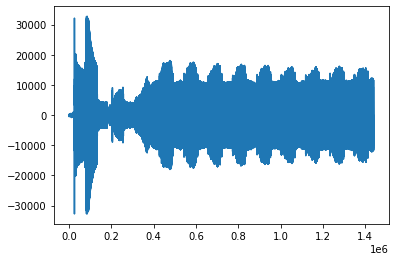

In [202]:
plt.plot(data_right[int(2.5*192000):int(10*192000)])

In [203]:
gc.collect()

0

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:7555: RuntimeWarning: divide by zero encountered in log10
  Z = 20. * np.log10(spec)


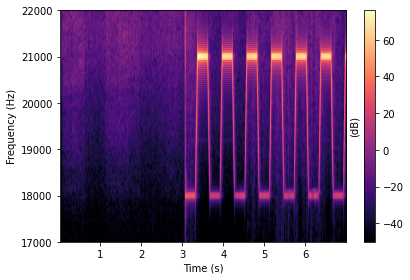

In [1130]:
selected_data = data_left[0*192000:7*192000]
_,_,_ = visualize_fft(selected_data)

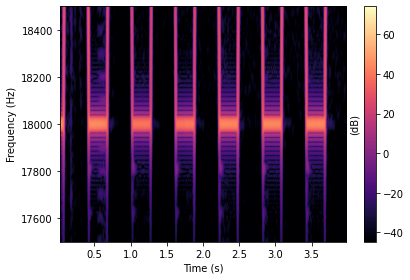

In [939]:
selected_data = data_left[3*192000:7*192000]
_,_,_ = visualize_spec(selected_data,10000,17500,18500,125)

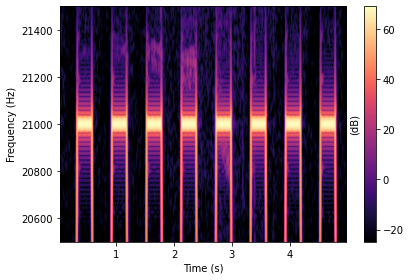

In [928]:
selected_data = data_left[7*192000:12*192000]
_,_,_ = visualize_spec(selected_data,10000,20500,21500,100)

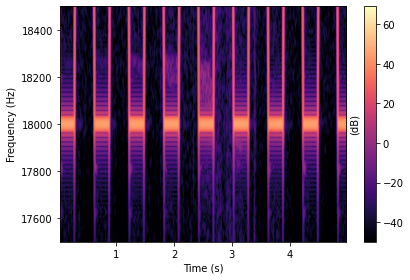

In [938]:
selected_data = data_left[7*192000:12*192000]
_,_,_ = visualize_spec(selected_data,10000,17500,18500,125)

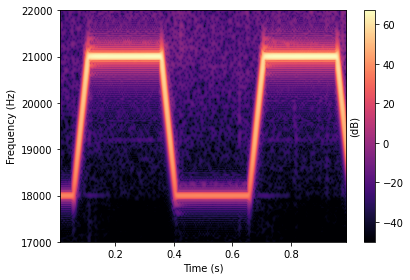

In [30]:
selected_data = data_left[int(10.5*192000):int(11.5*192000)]
Pxx,freqs,times = visualize_fft(selected_data)

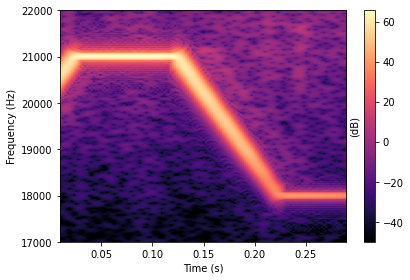

In [1969]:
selected_data = data_left[int(19*192000):int(19.3*192000)]
Pxx,freqs,times = visualize_fft(selected_data)

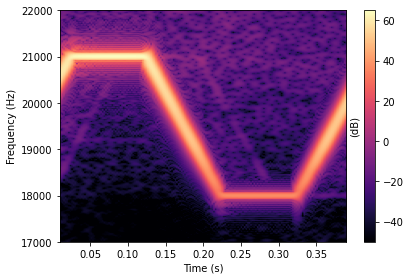

In [1963]:
selected_data = data_left[13*192000:int(13.4*192000)]
Pxx,freqs,times = visualize_fft(selected_data)

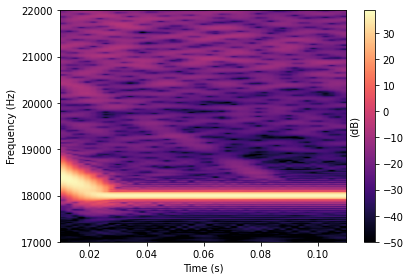

In [1939]:
selected_data = data_left[int(13.2*192000):int(13.32*192000)]
Pxx,freqs,times = visualize_fft(selected_data)

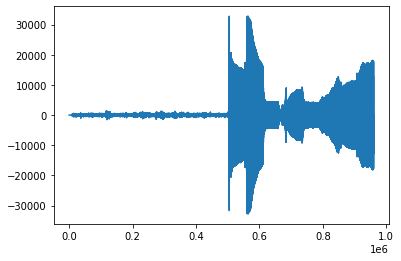

In [231]:
plt.plot(selected_data)

In [1057]:
df_pxx = pd.DataFrame(Pxx, index=freqs)

diff_pxx_1 = df_pxx.loc[17500:21500].diff(axis=1)
diff_pxx_0 = df_pxx.loc[17500:21500].diff(axis=0)

#normalize
diff_pxx_1=(diff_pxx_1-diff_pxx_1.min())/(diff_pxx_1.max()-diff_pxx_1.min())
diff_pxx_0=(diff_pxx_0-diff_pxx_0.min())/(diff_pxx_0.max()-diff_pxx_0.min())

In [1058]:
df = diff_pxx_0.idxmax()#pd.DataFrame(Pxx).max()
normalized_df=(df-df.min())/(df.max()-df.min())

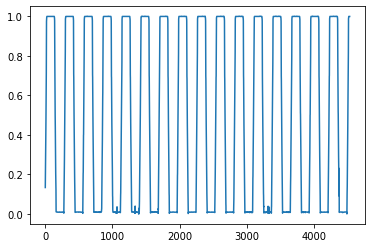

In [1059]:
plt.plot(normalized_df)

In [1060]:
#normalized_df = np.repeat(normalized_df,420).values

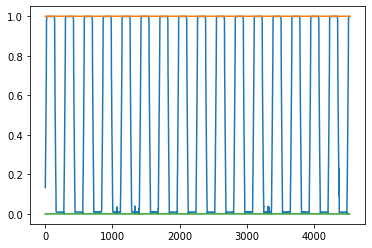

In [1061]:
upper_threshold = 1
lower_threshold = 0
plt.plot(normalized_df)
plt.plot(np.full(len(Pxx.T),upper_threshold))
plt.plot(np.full(len(Pxx.T),lower_threshold))

In [49]:
des_sweep = np.concatenate((np.full(118,1),np.arange(0,1,0.0434782609)[::-1],np.full(118,0),np.arange(0,1,0.0434782609))) 

In [53]:
designed_signal = np.tile(des_sweep,int(np.ceil(len(normalized_df)/len(des_sweep))))

In [57]:
from scipy.stats import pearsonr
corr_list = []
for j in range(len(normalized_df)):
    if (len(designed_signal)>=len(normalized_df)+j):
        selected_seg = designed_signal[j:len(normalized_df)+j]
        corr,_ = pearsonr(normalized_df,selected_seg)
        corr_list.append(corr)
        print(corr)

0.29521208523176873
0.2806216288127193
0.2660619216873266
0.25153189336454385
0.23703048445393093
0.22255664624259647
0.20810934028131806
0.19368753797943747
0.17929022020813695
0.16491637691172203
0.15056500672654105
0.13623511660719068
0.12192572145966302
0.10763584378110047
0.09336451330583763
0.07911076665741668
0.0648736470062701
0.05065220373277663
0.03644549209540153
0.022252572903640196
0.00807251219549112
-0.006095619080807128
-0.02025274538103913
-0.03439978687552766
-0.04853765975615391
-0.06266727654012443
-0.07678954637072807
-0.0909053753153165
-0.10501566666074115
-0.11912132120647523
-0.13322323755564497
-0.147322312404193
-0.16141944082839194
-0.17551551657092637
-0.18961143232575772
-0.2037080800219836
-0.21780635110690563
-0.23190713682851402
-0.24601132851759927
-0.2601198178696985
-0.2742334972270869
-0.28835325986101923
-0.3024800002544337
-0.3166146143853231
-0.33075800001098526
-0.3449110569533629
-0.3590746873856826
-0.3732497961206109
-0.3874368626131151
-0.40

In [58]:
j = np.argmax(corr_list)
selected_seg = designed_signal[j:len(normalized_df)+j]

In [59]:
np.argmax(corr_list)

0

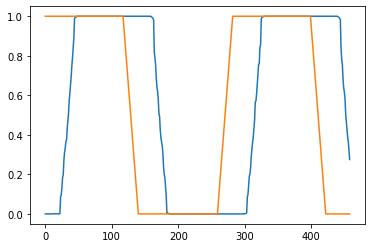

In [60]:
plt.plot(normalized_df)
plt.plot(selected_seg)

In [283]:
sine18 = []
s18 = []
sw = []
sweep =[]
s21 = []
sine21 = []
for x in range(len(selected_seg)):    
    #try:
    if(selected_seg[x]==0):
        s18.extend([x])
    else:
        if s18:
            sine18.append(s18)
        s18 = []
        
    if(selected_seg[x]>0 and selected_seg[x]<1):
        sw.extend([x])
    else:
        if sw:
            sweep.append(sw)
        sw = []
    
    if(selected_seg[x]==1):
        s21.extend([x])
    else:
        if s21:
            sine21.append(s21)
        s21 = []

In [63]:
for y in sine18:
    print(len(y))

120


In [64]:
for y in sweep:
    print(len(y))

22
22
22


In [65]:
for y in sine21:
    print(len(y))

118
118


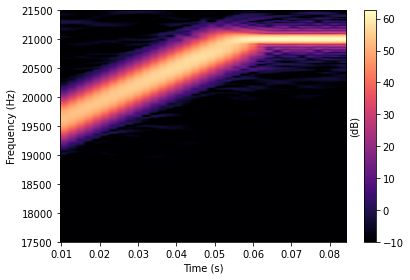

18260


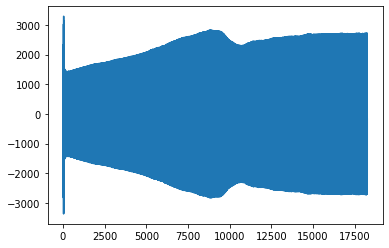

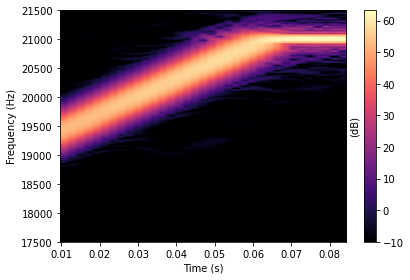

18260


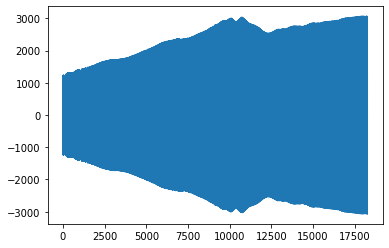

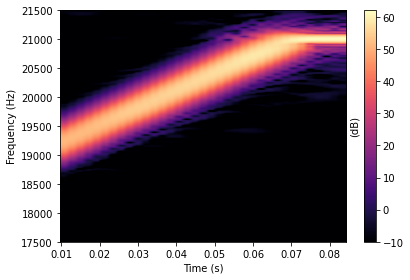

18260


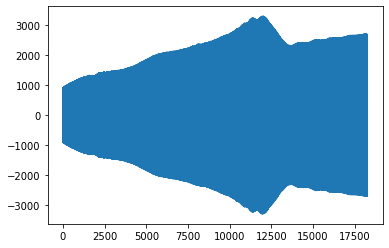

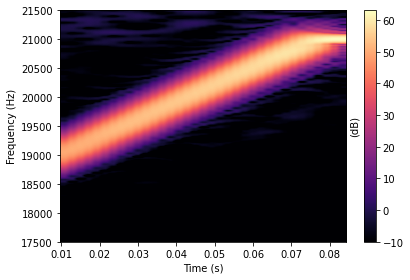

18260


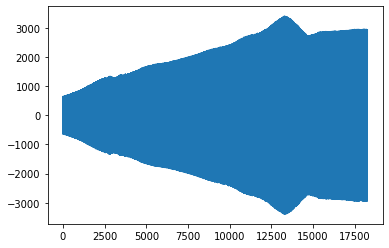

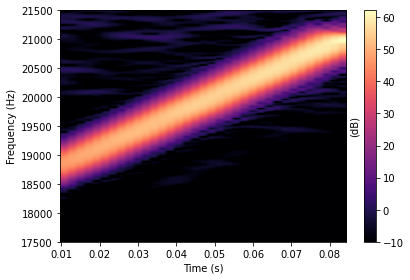

18260


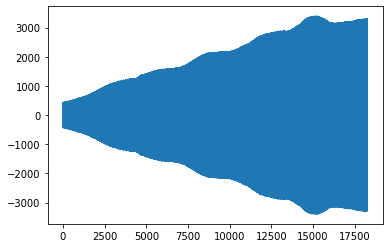

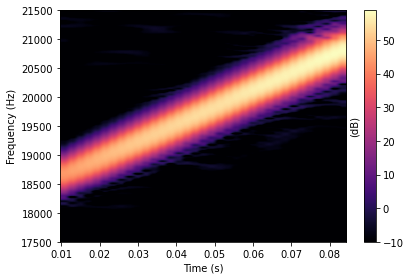

18260


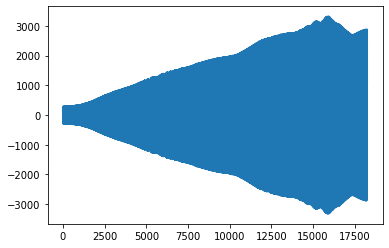

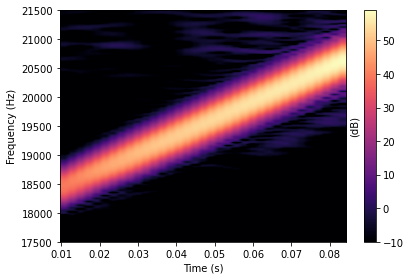

18260


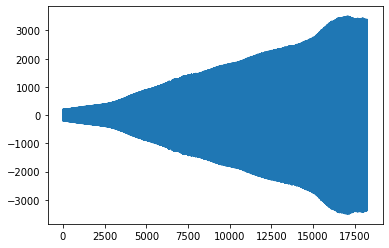

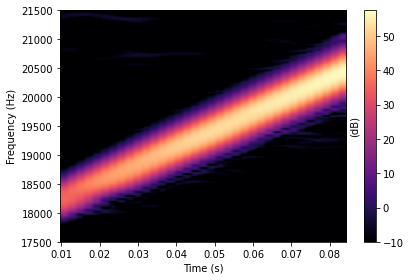

18260


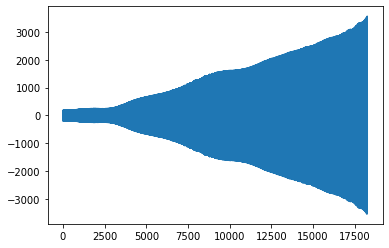

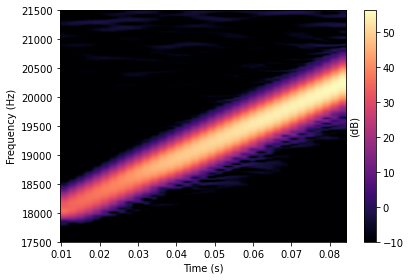

18260


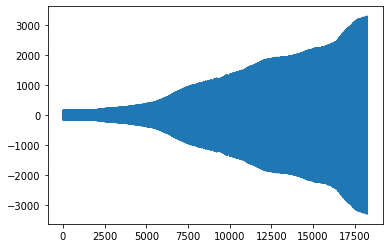

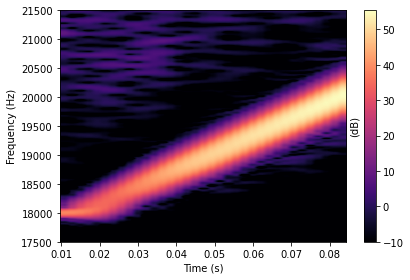

18260


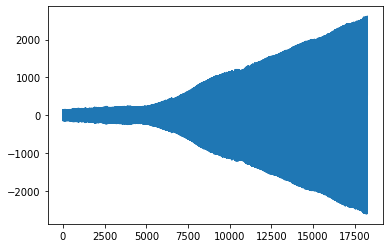

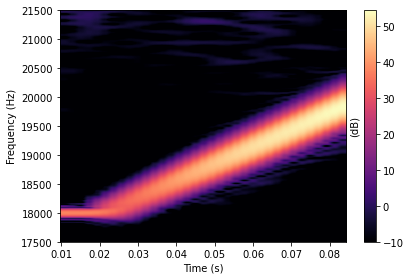

18260


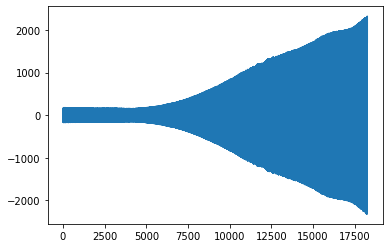

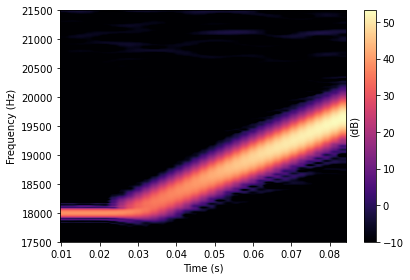

18260


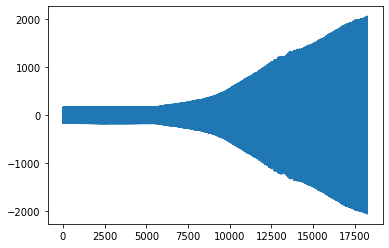

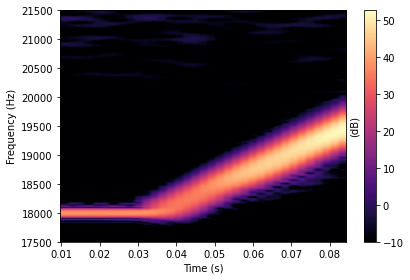

18260


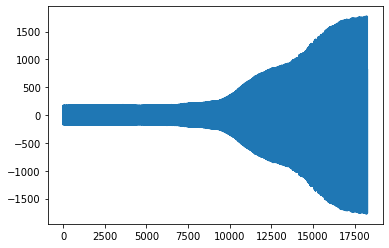

In [1834]:
for y in sine21:
    _,_,_ = visualize_fft(selected_data[y[0]*410:y[-1]*415])
    plt.plot(selected_data[y[0]*415:y[-1]*415])
    print(len(selected_data[y[0]*415:y[-1]*415]))
    plt.show()

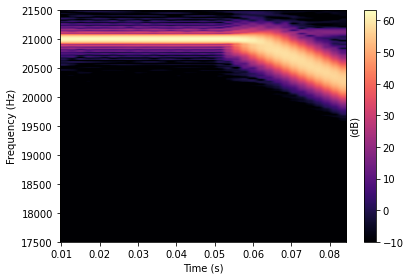

18260


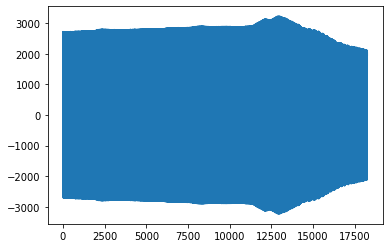

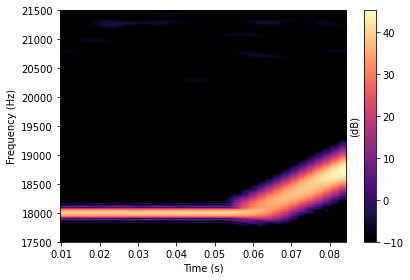

18260


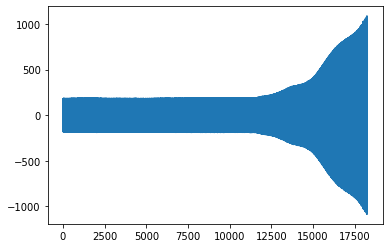

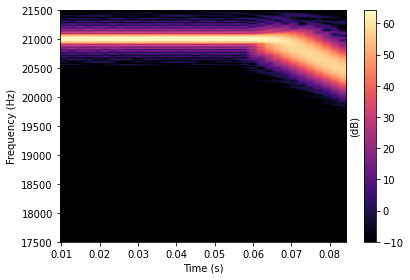

18260


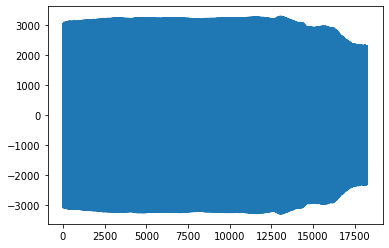

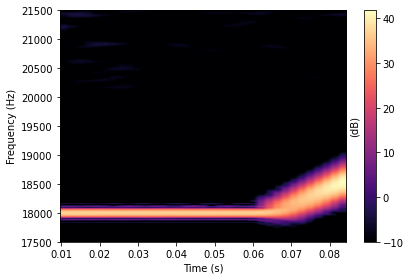

18260


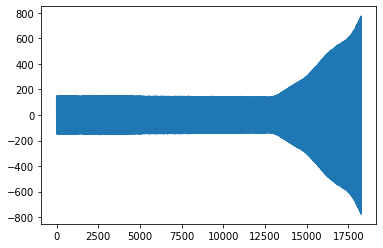

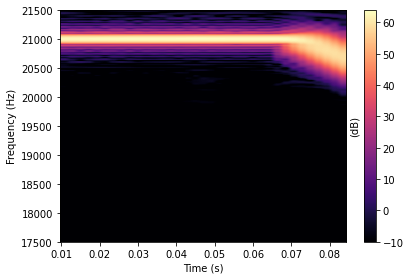

18260


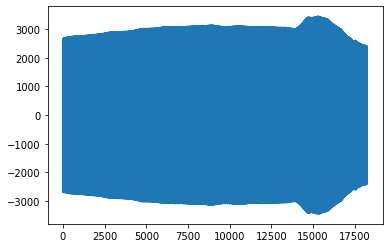

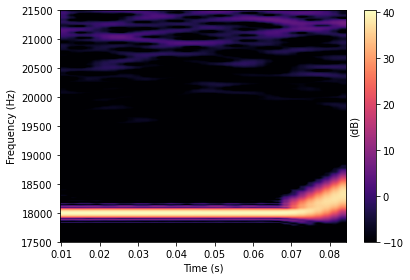

18260


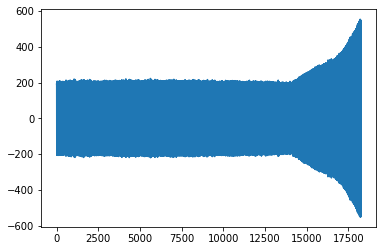

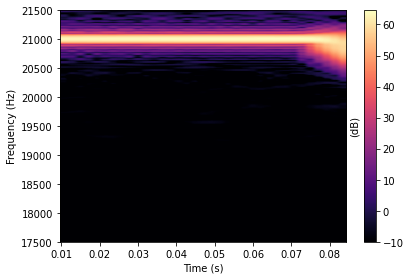

18260


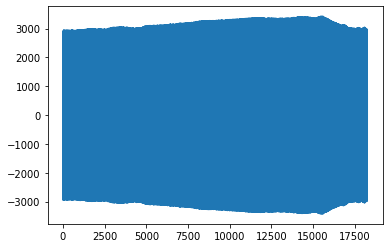

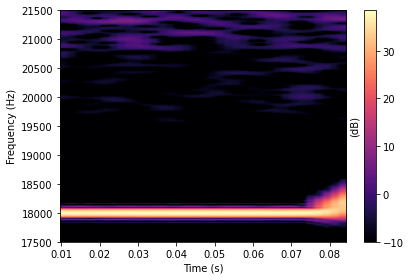

18260


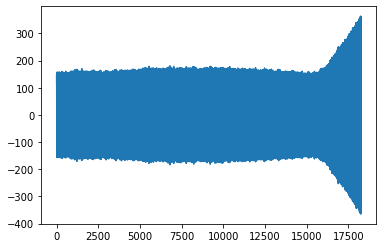

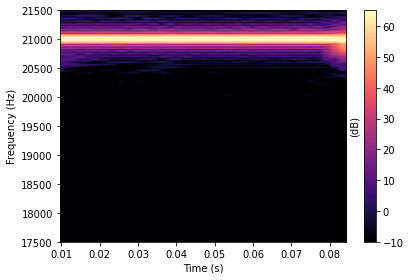

18260


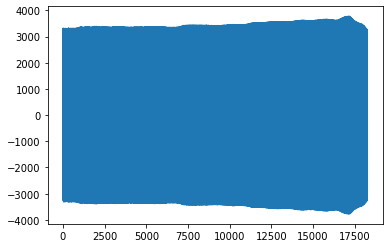

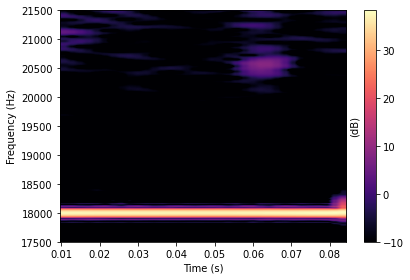

18260


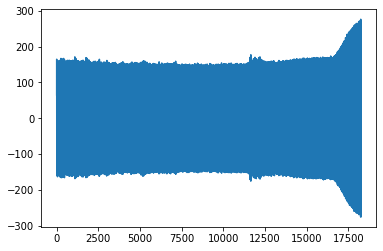

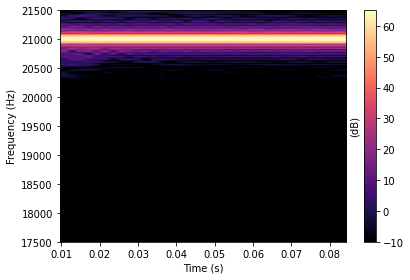

18260


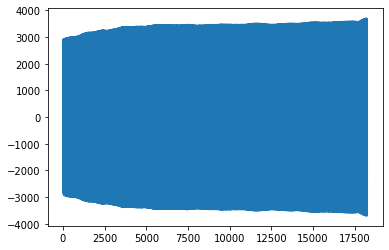

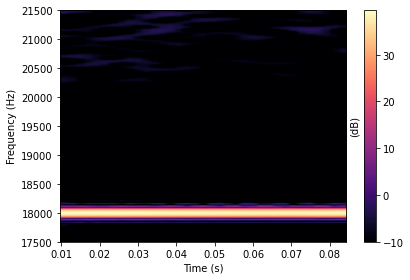

18260


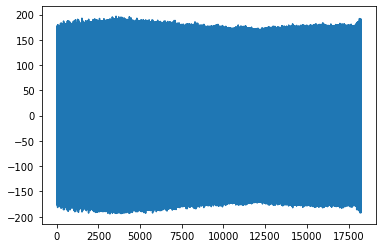

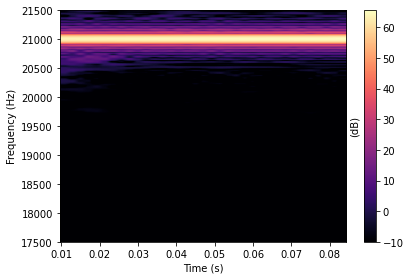

18260


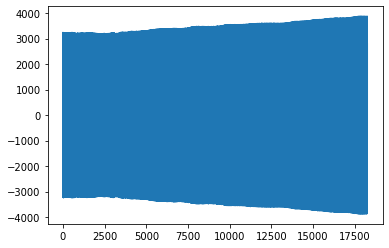

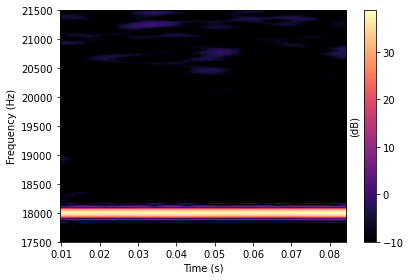

18260


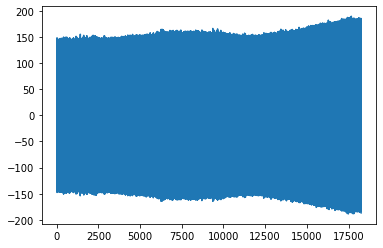

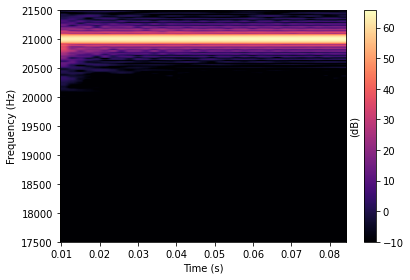

18260


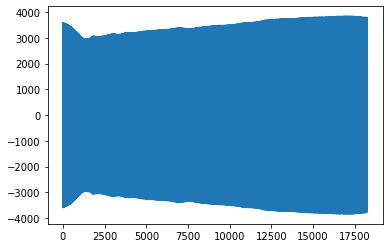

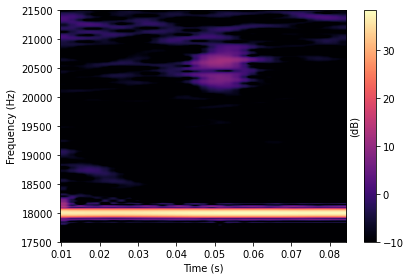

18260


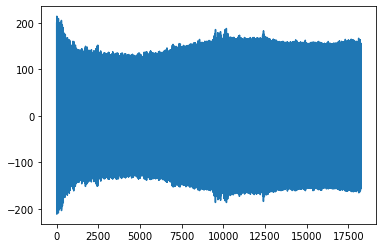

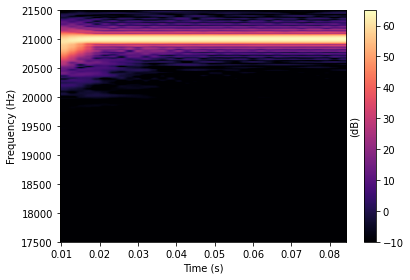

18260


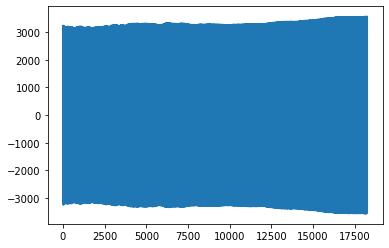

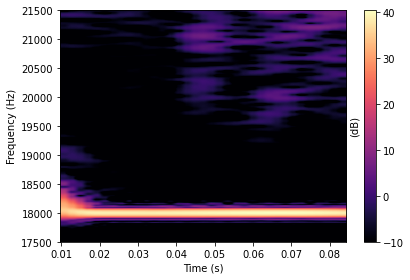

18260


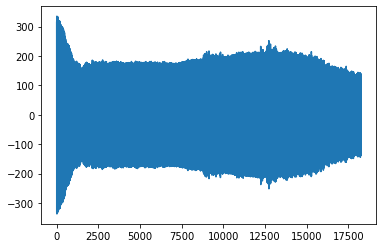

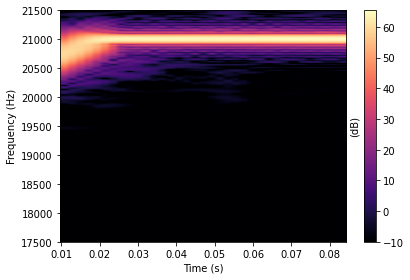

18260


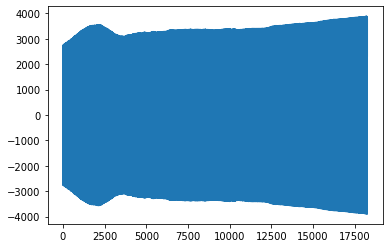

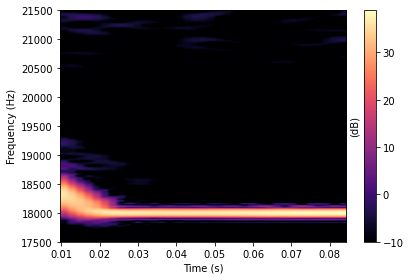

18260


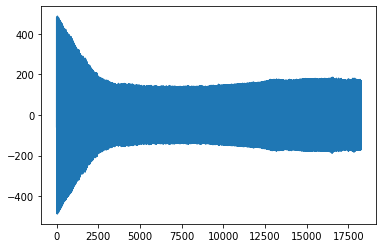

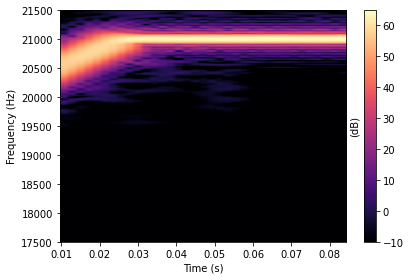

18260


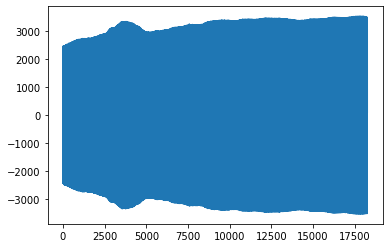

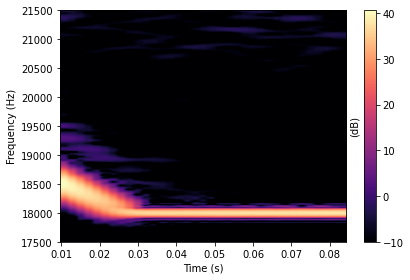

18260


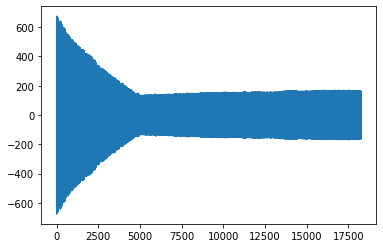

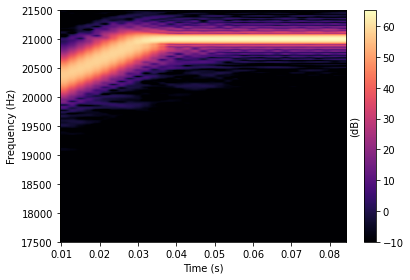

18260


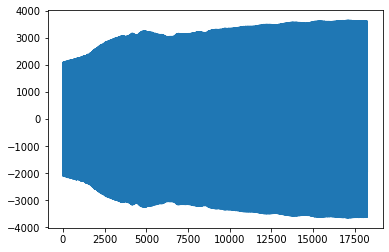

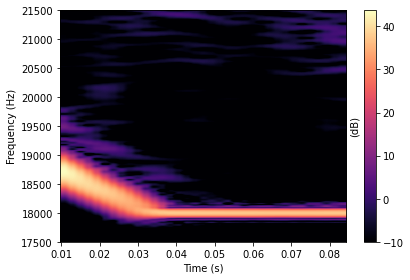

18260


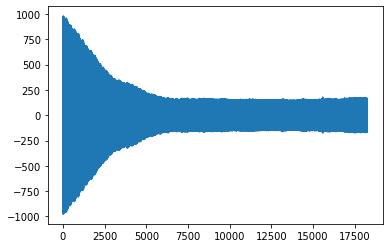

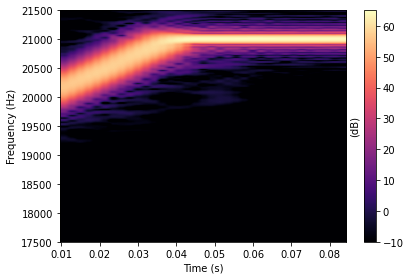

18260


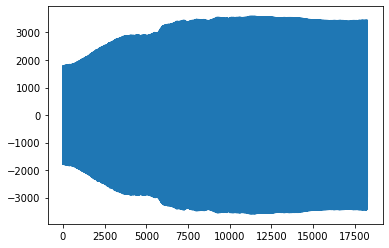

In [1835]:
for y in sweep:
    _,_,_ = visualize_fft(selected_data[y[0]*415:y[-1]*415])
    plt.plot(selected_data[y[0]*415:y[-1]*415])
    print(len(selected_data[y[0]*415:y[-1]*415]))
    plt.show()

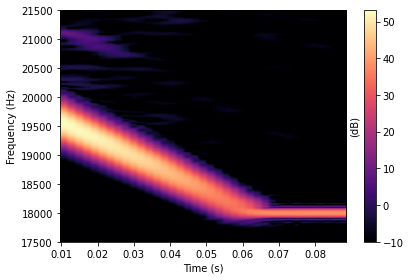

19090


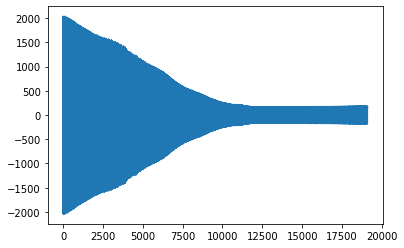

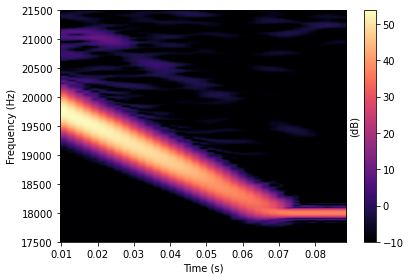

19090


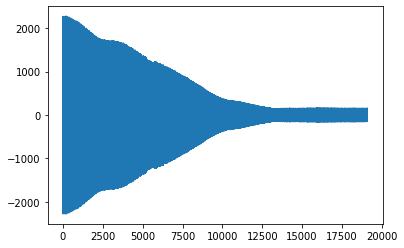

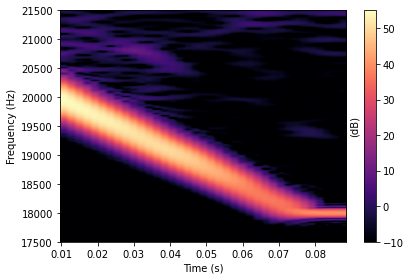

19090


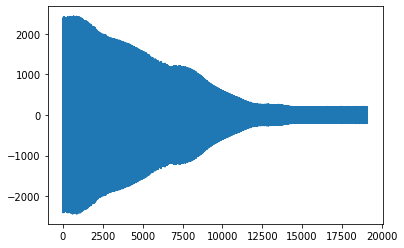

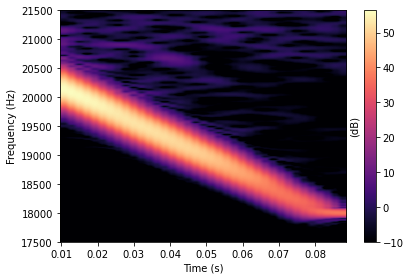

19090


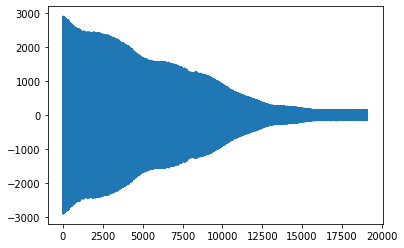

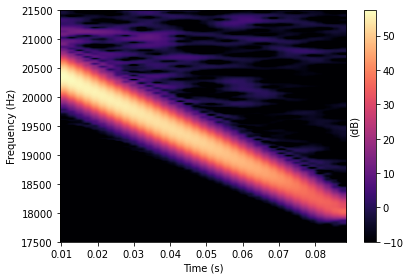

19090


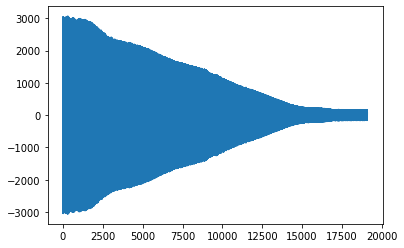

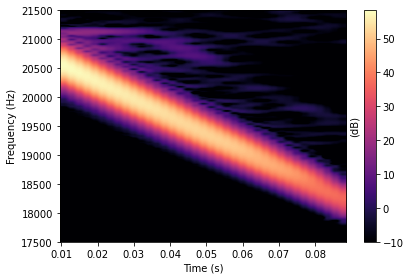

19090


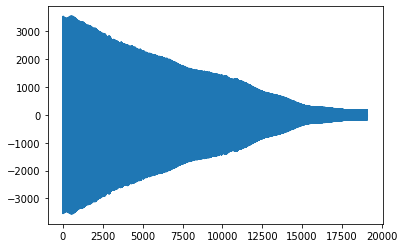

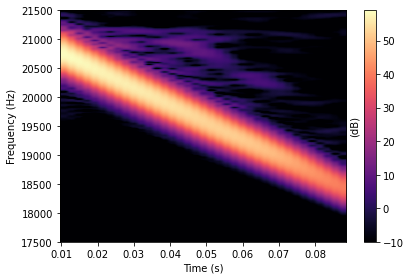

19090


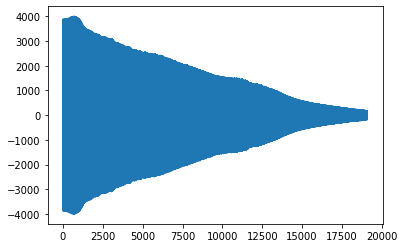

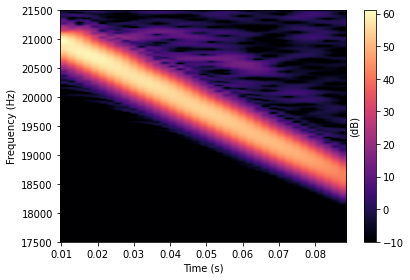

19090


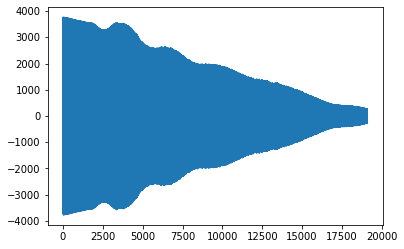

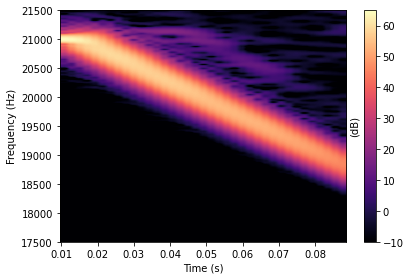

19090


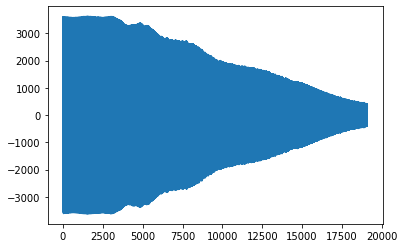

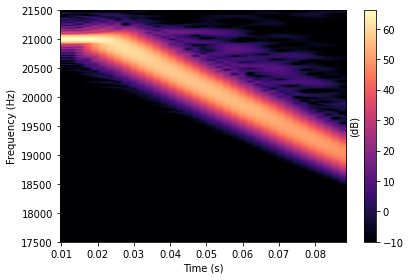

19090


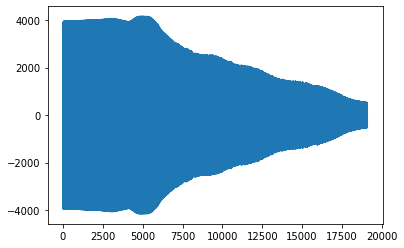

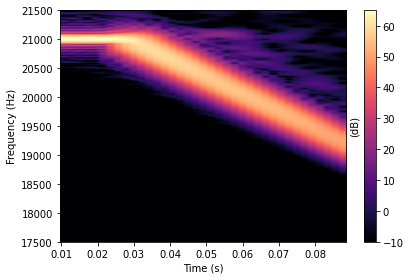

19090


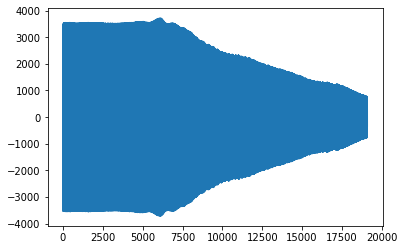

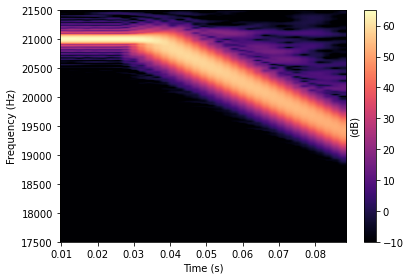

19090


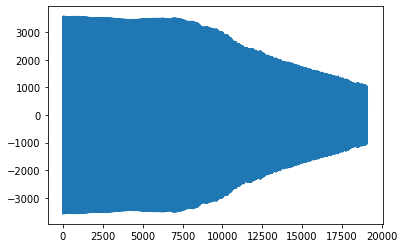

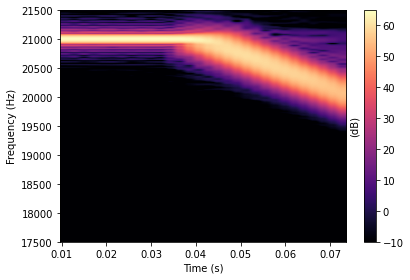

16290


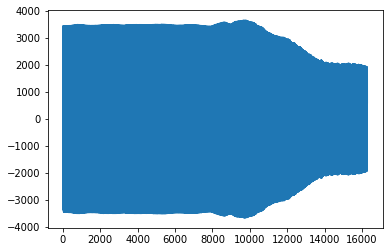

In [1836]:
for y in sine18:
    _,_,_ = visualize_fft(selected_data[y[0]*415:y[-1]*415])
    plt.plot(selected_data[y[0]*415:y[-1]*415])
    print(len(selected_data[y[0]*415:y[-1]*415]))
    plt.show()

# Data segmentation V1.1

In [682]:
selected_data = data_left[5*192000:12*192000]
Pxx,freqs,times = visualize_fft(selected_data)

ValueError: zero-size array to reduction operation maximum which has no identity

In [32]:
df_pxx = pd.DataFrame(Pxx, index = freqs)

In [33]:
diff_pxx_1 = df_pxx.loc[17500:21500].diff(axis=1)
diff_pxx_0 = df_pxx.loc[17500:21500].diff(axis=0)

#normalize
diff_pxx_1=(diff_pxx_1-diff_pxx_1.min())/(diff_pxx_1.max()-diff_pxx_1.min())
diff_pxx_0=(diff_pxx_0-diff_pxx_0.min())/(diff_pxx_0.max()-diff_pxx_0.min())

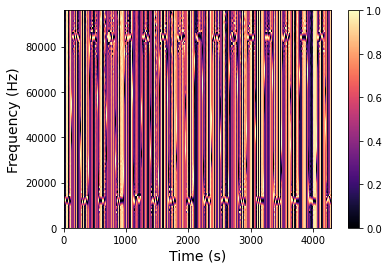

In [34]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx_1,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

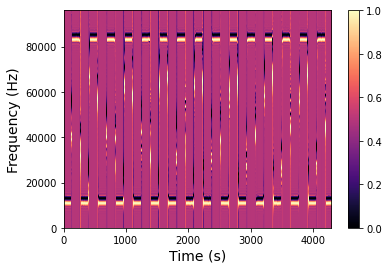

In [35]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx_0,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

In [36]:
diff_pxx = (diff_pxx_0 + diff_pxx_1)/2

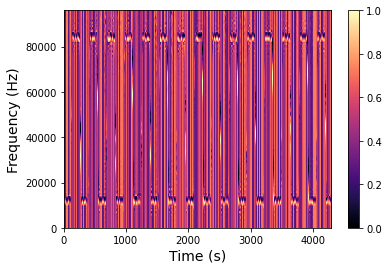

In [37]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

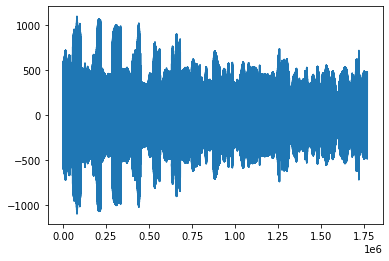

In [38]:
plt.plot(selected_data)

In [39]:
df = diff_pxx_0.idxmax()#pd.DataFrame(Pxx).max()
normalized_df=(df-df.min())/(df.max()-df.min())

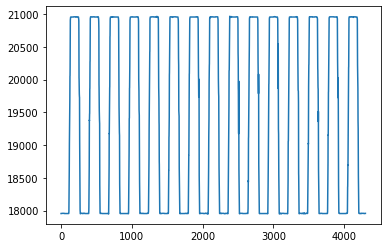

In [40]:
plt.plot(diff_pxx_0.idxmax())

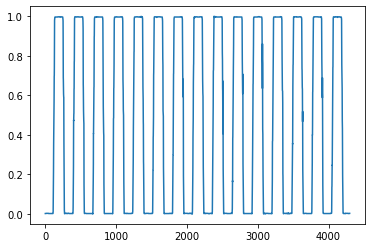

In [41]:
plt.plot(normalized_df)

In [1156]:
#normalized_df = np.repeat(normalized_df,420).values

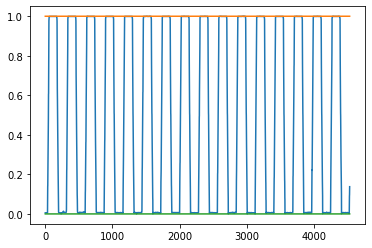

In [1157]:
upper_threshold = 1
lower_threshold = 0
plt.plot(normalized_df)
plt.plot(np.full(len(Pxx.T),upper_threshold))
plt.plot(np.full(len(Pxx.T),lower_threshold))

In [1158]:
des_sweep = np.concatenate((np.full(118,1),np.arange(0,1,0.0434782609)[::-1],np.full(118,0),np.arange(0,1,0.0434782609),np.full(118,1),np.arange(0,1,0.0434782609)[::-1],np.full(118,0),np.arange(0,1,0.0434782609))) 

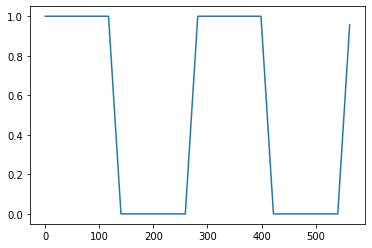

In [1159]:
plt.plot(des_sweep)

In [586]:
len(normalized_df)

3269

In [587]:
len(selected_seg)

411

In [588]:
designed_signal = np.tile(des_sweep,int(np.ceil(len(normalized_df)/len(des_sweep))))
designed_signal = des_sweep

In [589]:
len(normalized_df)

3269

In [590]:
int(np.ceil(len(normalized_df)/len(des_sweep)))

6

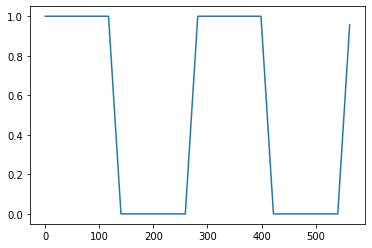

In [591]:
plt.plot(designed_signal)

In [592]:
gc.collect()

4554

In [593]:
select_len

90

In [594]:
nor_df

900    1.0
901    1.0
902    1.0
903    1.0
904    1.0
905    1.0
906    1.0
907    1.0
908    1.0
909    1.0
910    1.0
911    1.0
912    1.0
913    1.0
914    1.0
915    1.0
916    1.0
917    1.0
918    1.0
919    1.0
920    1.0
921    1.0
922    1.0
923    1.0
924    1.0
925    1.0
926    1.0
dtype: float64

In [595]:
len(np.arange(0.000001,1,0.022223)[::-1])

45

In [596]:
len(np.full(45,1))

45

In [597]:
np.arange(0.000001,1,0.022223)[::-1]

array([9.77813e-01, 9.55590e-01, 9.33367e-01, 9.11144e-01, 8.88921e-01,
       8.66698e-01, 8.44475e-01, 8.22252e-01, 8.00029e-01, 7.77806e-01,
       7.55583e-01, 7.33360e-01, 7.11137e-01, 6.88914e-01, 6.66691e-01,
       6.44468e-01, 6.22245e-01, 6.00022e-01, 5.77799e-01, 5.55576e-01,
       5.33353e-01, 5.11130e-01, 4.88907e-01, 4.66684e-01, 4.44461e-01,
       4.22238e-01, 4.00015e-01, 3.77792e-01, 3.55569e-01, 3.33346e-01,
       3.11123e-01, 2.88900e-01, 2.66677e-01, 2.44454e-01, 2.22231e-01,
       2.00008e-01, 1.77785e-01, 1.55562e-01, 1.33339e-01, 1.11116e-01,
       8.88930e-02, 6.66700e-02, 4.44470e-02, 2.22240e-02, 1.00000e-06])

In [598]:
np.full(45,1)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1])

In [599]:
des_sweep = np.concatenate((np.full(118,1),np.arange(0.000001,1,0.0434782609)[::-1],np.full(118,0),np.arange(0.000001,1,0.0434782609),np.full(118,1),np.arange(0.000001,1,0.0434782609)[::-1],np.full(118,0),np.arange(0.000001,1,0.0434782609))) 

In [600]:
len(des_sweep)/4

141.0

In [601]:
from scipy.signal import savgol_filter
def smooth(data):
    smooth_data = savgol_filter(data, 11, 3)
    return smooth_data

In [602]:
normalized_df = smooth(normalized_df)

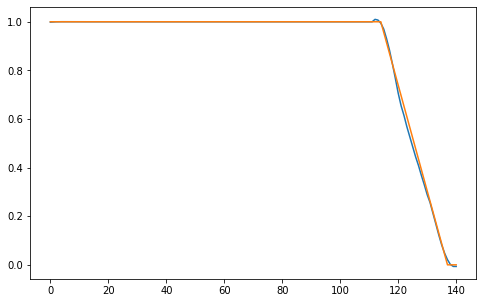

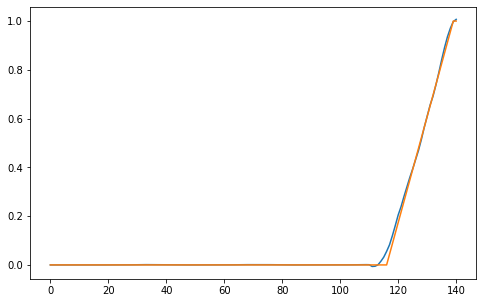

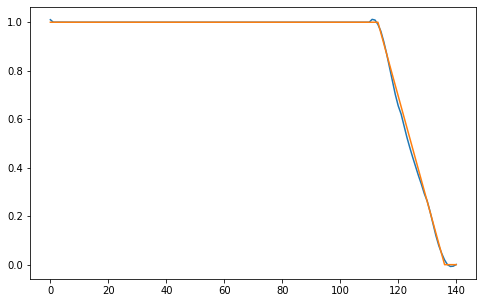

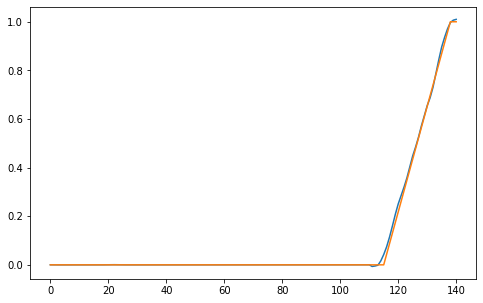

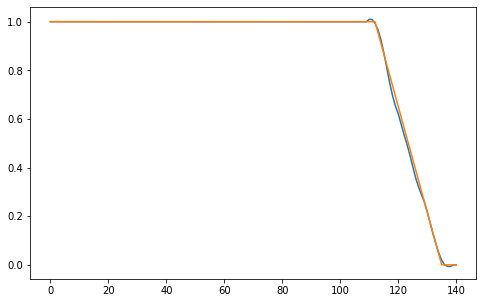

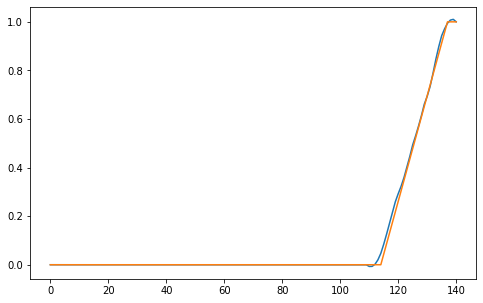

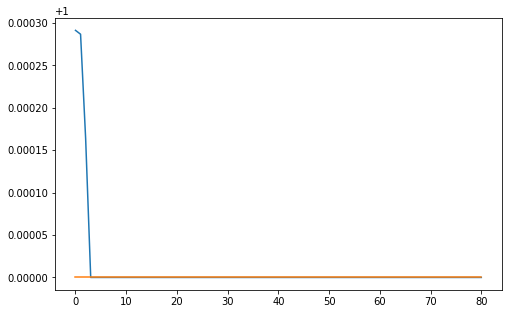

In [100]:
# from scipy.stats import pearsonr
from fastdtw import fastdtw
from scipy.spatial import distance
select_len = int(len(designed_signal)/4)
i = 0
p = 0
approx_sig = []
while select_len*(p)<len(normalized_df):
    corr_list = []
    if(len(normalized_df[i:len(normalized_df)])>len(normalized_df[i:select_len*(p+1)])):
        nor_df = normalized_df[i:select_len*(p+1)]
    else:
        nor_df = normalized_df[i:len(normalized_df)]
    #normalized_df = normalized_df[:int(len(designed_signal)/2)]
    for j in range(len(designed_signal)):
        if (len(designed_signal)>=len(nor_df)+j):
            selected_seg = designed_signal[j:len(nor_df)+j]
            #corr,_ = pearsonr(nor_df,selected_seg)
            #corr, _ = fastdtw(selected_seg,nor_df)
            corr = distance.euclidean(selected_seg,nor_df)
            corr_list.append(corr)
            #print(corr)
            #plt.plot(nor_df)
            #plt.plot(selected_seg)
    i = select_len*(p+1)
    p=p+1
    #print(i)
    
    max_cor = np.argmin(corr_list)
    #print(max_cor)
    segment = designed_signal[max_cor:len(nor_df)+max_cor]
    plt.figure(figsize=(8,5))
    plt.plot(nor_df)
    plt.plot(segment)
    approx_sig.extend(segment)
    #plt.plot()

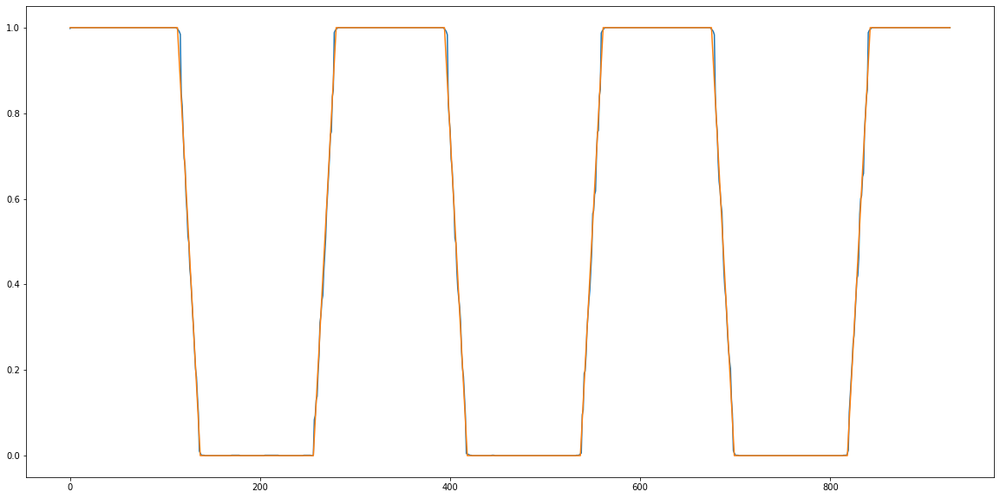

In [327]:
plt.figure(figsize=(20,10))
plt.plot(normalized_df)
plt.plot(approx_sig)

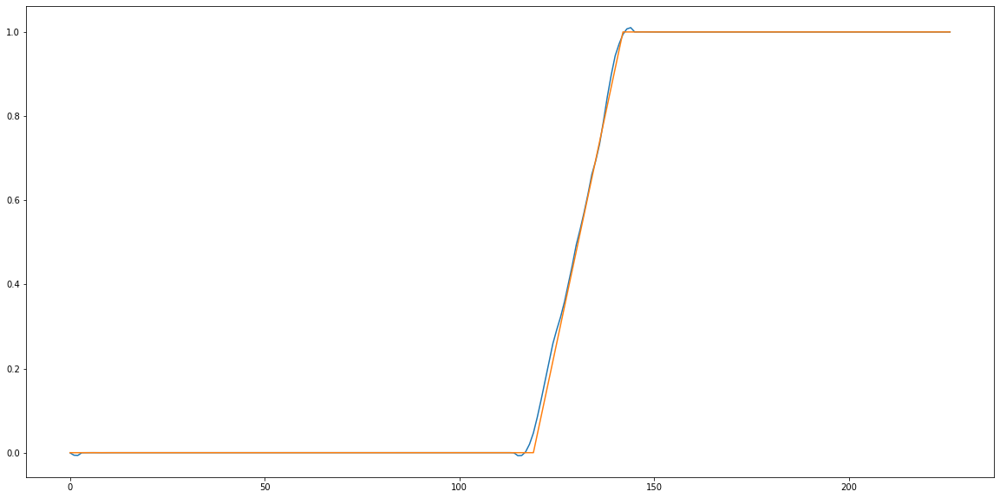

In [102]:
plt.figure(figsize=(20,10))
plt.plot(normalized_df[700:1000])
plt.plot(approx_sig[700:1000])

In [103]:
plt.figure(figsize=(20,10))
plt.plot(yhat)

NameError: name 'yhat' is not defined

<Figure size 1440x720 with 0 Axes>

# Data segmentation v1.2

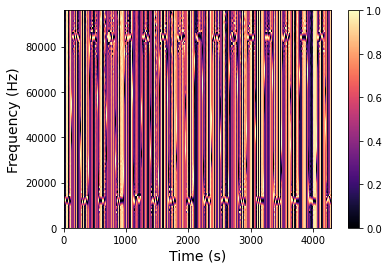

In [132]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx_1,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

In [204]:
df_pxx = pd.DataFrame(Pxx, index = freqs)

In [205]:
diff_pxx_1 = df_pxx.loc[17500:21500].diff(axis=1)
diff_pxx_0 = df_pxx.loc[17500:21500].diff(axis=0)

#normalize
diff_pxx_1=(diff_pxx_1-diff_pxx_1.min())/(diff_pxx_1.max()-diff_pxx_1.min())
diff_pxx_0=(diff_pxx_0-diff_pxx_0.min())/(diff_pxx_0.max()-diff_pxx_0.min())

df = diff_pxx_0.idxmax()#pd.DataFrame(Pxx).max()
normalized_df=(df-df.min())/(df.max()-df.min())

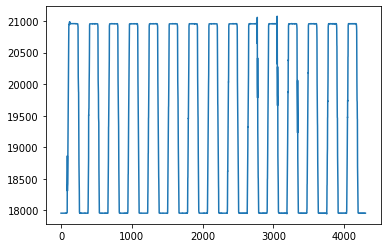

In [215]:
plt.plot(df)

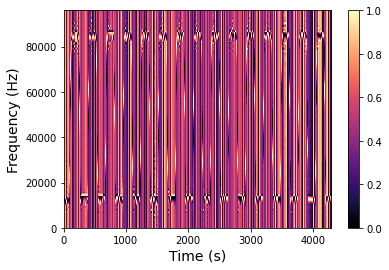

In [206]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx_1,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

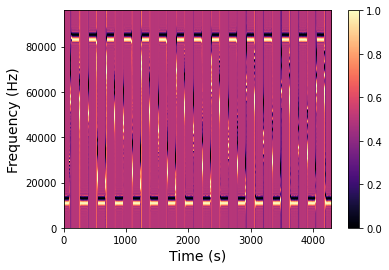

In [207]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx_0,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

In [208]:
diff_pxx = (diff_pxx_0 + diff_pxx_1)/2

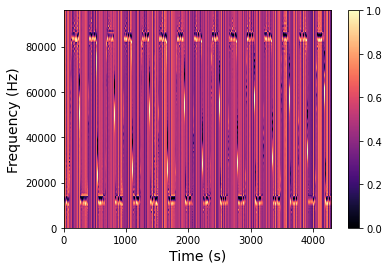

In [209]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

20
21
22
23
24


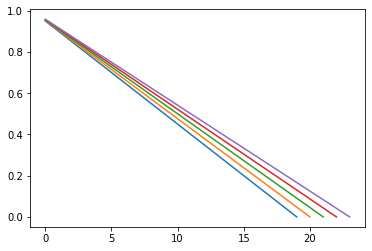

In [210]:
for t in range(20,25): #[23.14,23.24,23.44,23.64,23.74]:
    print(t)
    plt.plot(np.arange(0,1,1/t)[::-1])

In [211]:
def design_comp_wave(u,x,y,z):
    des_sweep = np.concatenate((np.full(u,1),np.arange(0.000001,1,1/x)[::-1],np.full(u,0),np.arange(0.000001,1,1/y),np.full(u,1),np.arange(0.000001,1,1/z)[::-1],np.full(u,0)))
    return des_sweep


# Normalize data

In [212]:
def normalize_data(data):
    norm_data = data/np.max(data)
    return norm_data

In [213]:
def detect_segments(data):
    data = normalize_data(data)
    

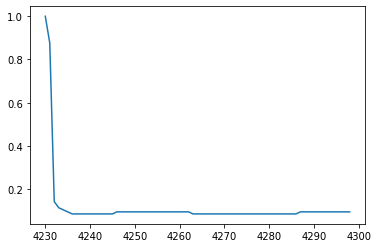

In [214]:
plt.plot(normalize_data(nor_df))

# Parallelizing signal estimation

In [144]:
import multiprocessing

multiprocessing.cpu_count()

32

In [145]:
len(os.sched_getaffinity(0))

32

In [ ]:
import multiprocessing
import pandas as pd

import time
start_time = time.time()


def f(nor_df):
    corr_list = []
    for u in range(114,122):
        for x in range(20,25):
            for y in range(20,25):
                for z in range(20,25):
                    designed_signal = design_comp_wave(u,x,y,z)
                    corr_list = []
                    #if(len(normalized_df[i:len(normalized_df)])>len(normalized_df[i:select_len*(p+1)])):
                    #    nor_df = normalized_df[i:select_len*(p+1)]
                    #else:
                    #    nor_df = normalized_df[i:len(normalized_df)]
                    #normalized_df = normalized_df[:int(len(designed_signal)/2)]
                    #nor_df = normalize_data(nor_df)
                    for j in range(len(designed_signal)):
                        if (len(designed_signal)>=len(nor_df)+j):
                            selected_seg = designed_signal[j:len(nor_df)+j]
                            #corr,_ = pearsonr(nor_df,selected_seg)
                            #corr, _ = fastdtw(selected_seg,nor_df)
                            corr = distance.euclidean(selected_seg,nor_df)
                            corr_list.append(corr)
                            #print(corr)
                            #plt.plot(nor_df)
                            #plt.plot(selected_seg)
                            
    max_cor = np.argmin(corr_list)##np.argmax(corr_list)#
    #print(max_cor)
    segment = designed_signal[max_cor:len(nor_df)+max_cor]
    plt.figure(figsize=(8,5))
    plt.plot(nor_df)
    plt.plot(segment)
    plt.show()
    return corr_list



if __name__ == '__main__':
    # Create pool with 4 processors
    pool = multiprocessing.Pool(len(os.sched_getaffinity(0)))
    print("check")
    jobs = []
    #for group in data['some_group']:
    i = 0
    p = 0
    approx_sig = []   
    select_len = 90#int(len(designed_signal)/4)
    data = []
    while select_len*(p)<len(normalized_df):
        # Create asynchronous jobs that will be submitted once a processor is ready
        if(len(normalized_df[i:len(normalized_df)])>len(normalized_df[i:select_len*(p+1)])):
            nor_df = normalized_df[i:select_len*(p+1)]
        else:
            nor_df = normalized_df[i:len(normalized_df)]
        #normalized_df = normalized_df[:int(len(designed_signal)/2)]
        nor_df = normalize_data(nor_df)
        data.append([nor_df])#data[data.some_group == group]
        
        
        i = select_len*(p+1)
        p=p+1
        
    for seg in data:
        jobs.append(pool.apply_async(f, (seg, )))
#print(i)
    # Submit jobs
    approx_sig.extend([job.get() for job in jobs])
    
    
# Combine results
#approx_sig.extend(results)
print("--- %s seconds ---" % (time.time() - start_time))

In [1549]:
j = job[0].get()

In [1550]:
j

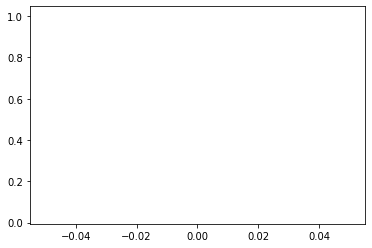

In [1506]:

for job in jobs:
    plt.plot(job.get())

In [64]:
len(data)

5760000

In [1546]:
plt.plot(data[0])
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


0

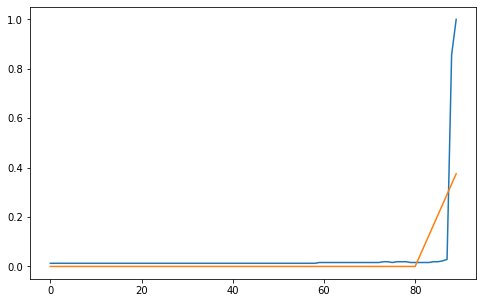

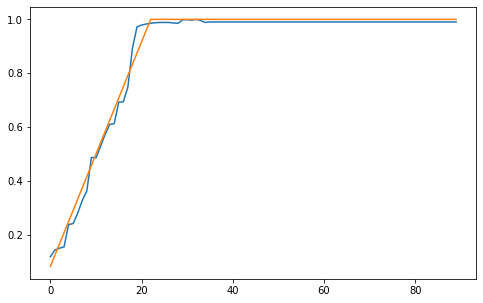

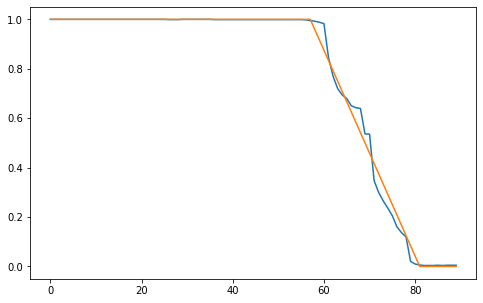

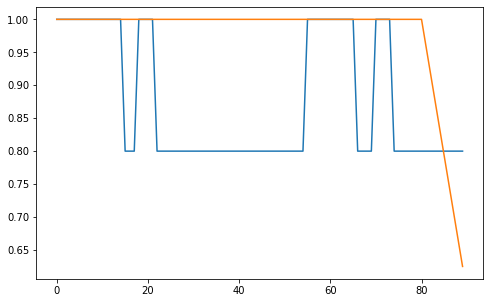

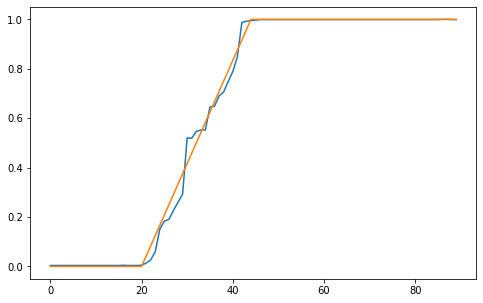

...

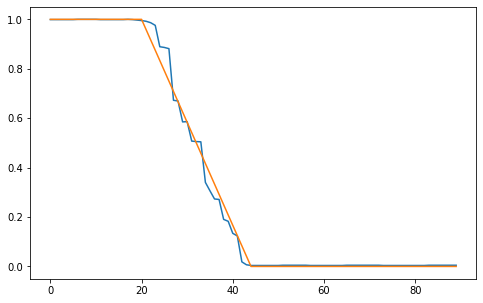

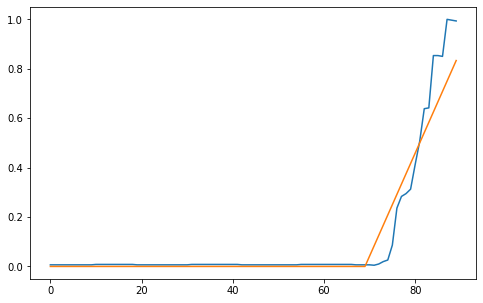

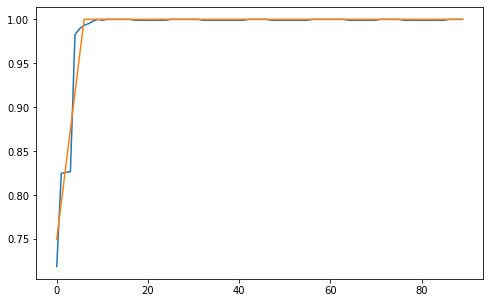

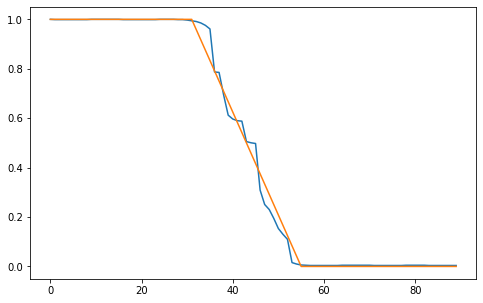

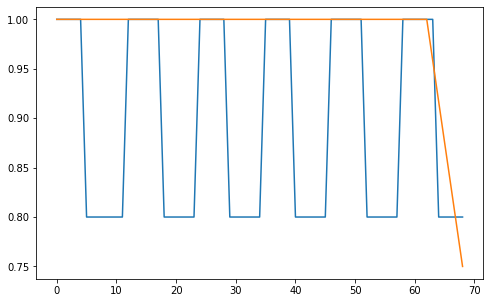

In [216]:
from fastdtw import fastdtw
from scipy.spatial import distance

i = 0
p = 0
approx_sig = []    


select_len = 90#int(len(designed_signal)/4)
while select_len*(p)<len(normalized_df):
    for u in range(114,122):
        for x in range(20,25):
            for y in range(20,25):
                for z in range(20,25):
                    designed_signal = design_comp_wave(u,x,y,z)
                    corr_list = []
                    if(len(normalized_df[i:len(normalized_df)])>len(normalized_df[i:select_len*(p+1)])):
                        nor_df = normalized_df[i:select_len*(p+1)]
                    else:
                        nor_df = normalized_df[i:len(normalized_df)]
                    #normalized_df = normalized_df[:int(len(designed_signal)/2)]
                    nor_df = normalize_data(nor_df)
                    for j in range(len(designed_signal)):
                        if (len(designed_signal)>=len(nor_df)+j):
                            selected_seg = designed_signal[j:len(nor_df)+j]
                            #corr,_ = pearsonr(nor_df,selected_seg)
                            #corr, _ = fastdtw(selected_seg,nor_df)
                            corr = distance.euclidean(selected_seg,nor_df)
                            corr_list.append(corr)
                            #print(corr)
                            #plt.plot(nor_df)
                            #plt.plot(selected_seg)
    i = select_len*(p+1)
    p=p+1
    #print(i)

    max_cor = np.argmin(corr_list)##np.argmax(corr_list)#
    #print(max_cor)
    segment = designed_signal[max_cor:len(nor_df)+max_cor]
    plt.figure(figsize=(8,5))
    plt.plot(nor_df.values)
    plt.plot(segment)
    approx_sig.extend(segment)
    #plt.plot()
    
gc.collect()

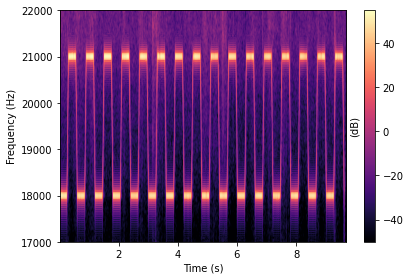

In [1533]:
selected_data = data_right[int(3.3*192000):13*192000]
Pxx,freqs,times = visualize_fft(selected_data)

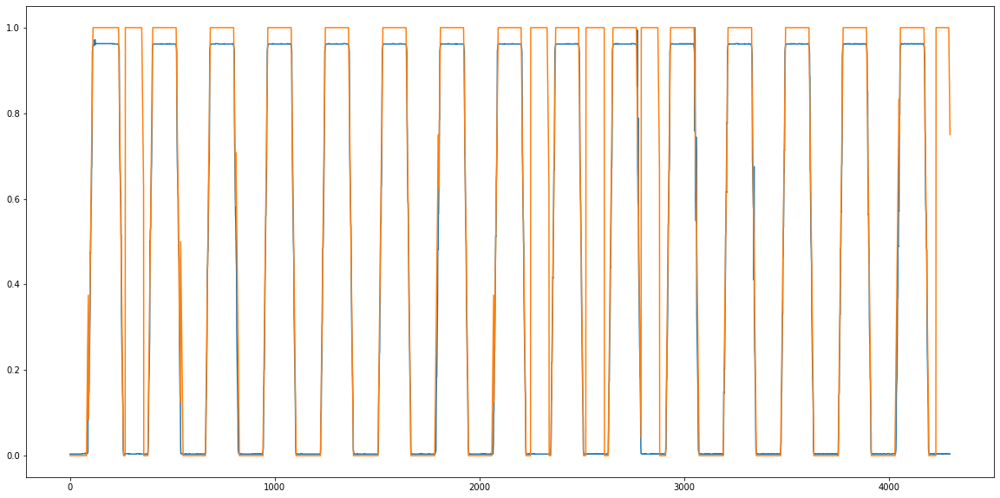

In [217]:
plt.figure(figsize=(20,10))
plt.plot(normalized_df)
plt.plot(approx_sig)

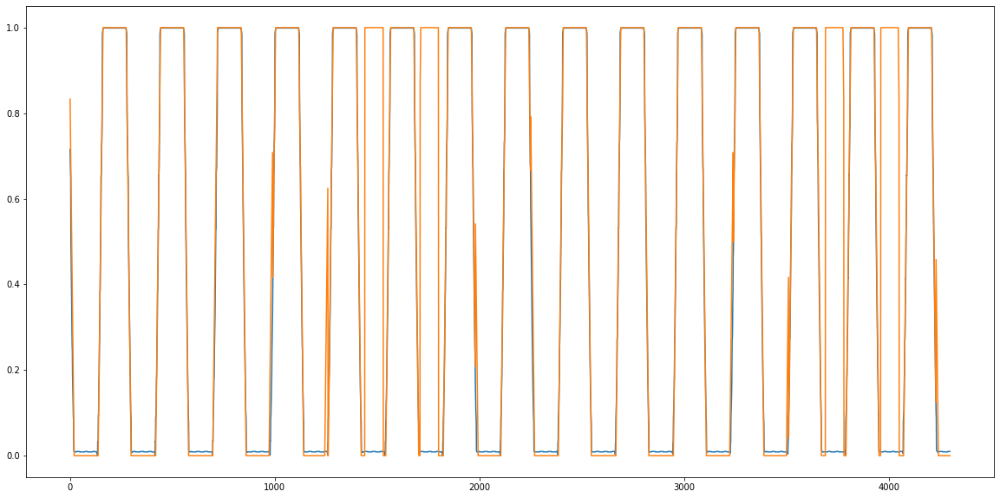

In [148]:
plt.figure(figsize=(20,10))
plt.plot(normalized_df)
plt.plot(approx_sig)

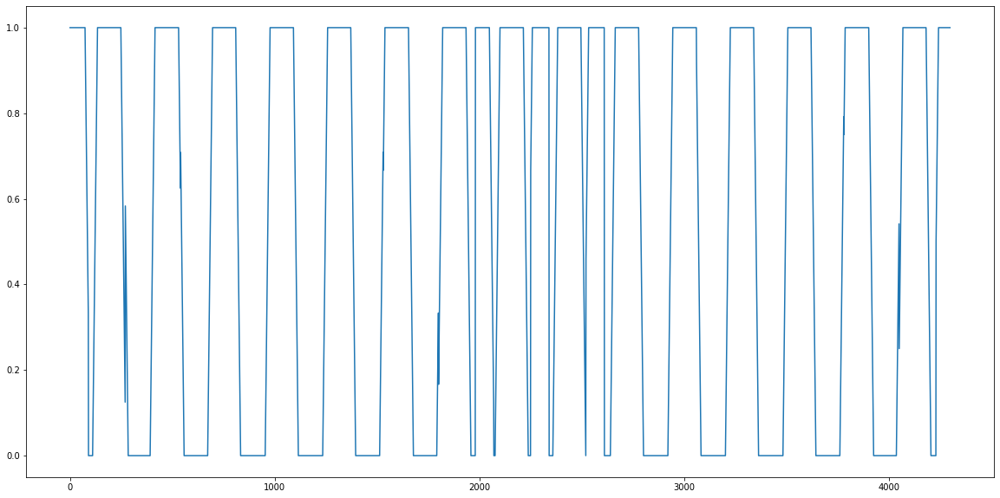

In [61]:
plt.figure(figsize=(20,10))
#plt.plot(normalized_df[2000:])
plt.plot(approx_sig)

In [1074]:
#j = np.argmax(corr_list)
j = np.argmax(corr_list)
selected_seg = designed_signal[j:len(normalized_df)+j]

In [1075]:
np.argmax(corr_list)

145

In [1076]:
len(normalized_df)

4533

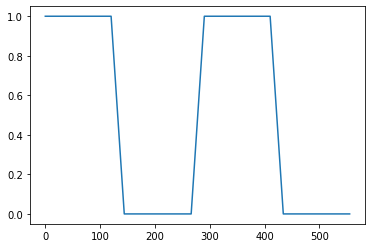

In [1077]:
plt.plot(designed_signal)

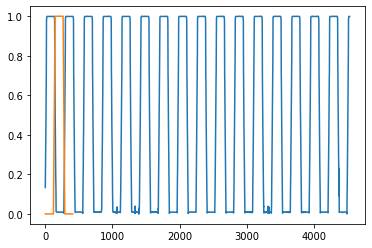

In [1078]:
plt.plot(normalized_df)
plt.plot(selected_seg)

In [218]:
sine18 = []
s18 = []
sw = []
sweep =[]
s21 = []
sine21 = []
#approx_sig = smooth(approx_sig)
for x in range(len(approx_sig)):    
    #try:
    if(approx_sig[x]==0):
        s18.extend([x])
    else:
        if s18:
            sine18.append(s18)
        s18 = []
        
    if(approx_sig[x]>0 and approx_sig[x]<1):
        sw.extend([x])
    else:
        if sw:
            sweep.append(sw)
        sw = []
    
    if(approx_sig[x]==1):
        s21.extend([x])
    else:
        if s21:
            sine21.append(s21)
        s21 = []

In [219]:
for y in sine18:
    print(len(y))

80
8
20
108
114
118
119
115
113
22
8
11
18
29
116
118
118
114
34


In [220]:
for y in sweep:
    print(len(y))

32
24
9
24
34
24
28
24
24
24
24
24
24
28
24
31
24
9
24
24
24
23
8
24
25
24
23
24
24
24
24
27
24


In [221]:
sweep = [x for x in sweep if len(x)>20]

In [222]:
for y in sine21:
    print(len(y))

126
81
115
115
115
114
114
114
113
81
113
90
115
82
116
116
115
115
116
63


In [223]:
import pylab as pl

def calculate_spectrum(signal):
    rate = samplerate
    t = np.arange(0, 10, 1/rate)
    x = signal
    p = 20*np.log10(np.abs(np.fft.rfft(x)))
    f = np.linspace(0, rate/2, len(p))
    #print(len(p))
    #print(len(f))
    #print(f)
    #plt.plot(p[500:750])
    spectrum = pd.DataFrame(p)
    spectrum.index = f
    #display(spectrum[18000:21000])
    #spectrum[18000:21000].plot()
    #plot(f[18000:21000], p[18000:21000])
    #plt.show()
    return spectrum[17500:21500].T

In [224]:
def visualize_spec(data,NFFT,low,high,dynamicRange):#,name,n):
    times = np.arange(len(data))/float(samplerate)

    plt.close("all")

    Fs = 192000#5000*2.#10000.
    NFFT = NFFT#int(16384/2)#min(4096, len(data))#32768
    noverlap = NFFT - NFFT/10#NFFT /2 #fft size
    pad_to = NFFT * 16
    dynamicRange = dynamicRange#30 #change this to change the color scale. 
    #vmin = 20*np.log10(np.max(data)) - dynamicRange

    #window=blackman(NFFT)
    #window=signal.nuttall(NFFT)
    #window=np.hamming(NFFT)
    window = np.hanning(NFFT)

    cmap = plt.get_cmap('magma')

    #vmin = data_right.min()
    #vmax = data_right.max()

    Pxx, freqs, times, cax = plt.specgram(data, NFFT=NFFT, window=window,vmin=-50, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', pad_to=pad_to, cmap=cmap)
    #print(len(Pxx))
    #Pxx_left, freqs_left, times_left, cax_left = plt.specgram(data_left, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx_right, freqs_right, times_right, cax_right = plt.specgram(data_right, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx = np.absolute(np.subtract(Pxx_left,Pxx_left))
    #print Pxx
    #f, t, Sxx = signal.spectrogram(data_right, Fs)

    #print type(Pxx)
    #plt.figure(figsize=(20,10))
    #plt.figure(figsize=(20,10))
    axes_spec = plt.gca()
    #axes_spec.set_xlim([2.8, 7.5])
    axes_spec.set_ylim([low, high])#18500])

    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    #plt.pcolormesh(t, f, Sxx, vmax = 1e-6)
    #plt.show()

    plt.colorbar(cax, label='(dB)').ax.yaxis.set_label_position('left')

    plt.tight_layout()
    #plt.savefig("visual/20211021/us_bicycle_approaching/" + name + "_" +str(n)+".png")
    plt.show()
    return Pxx, freqs, times



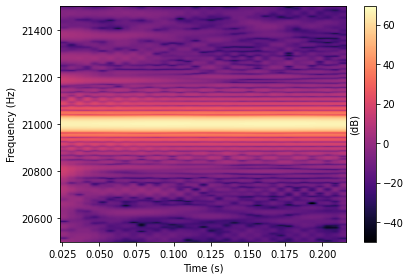

46330


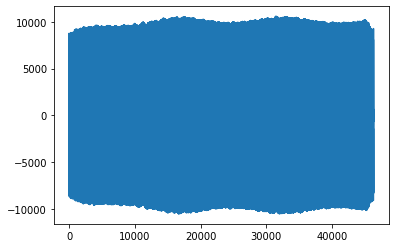

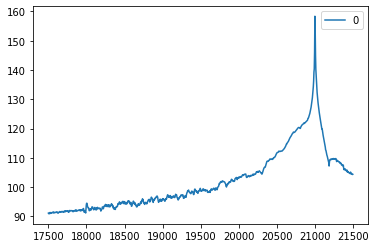

0.21354166666666666


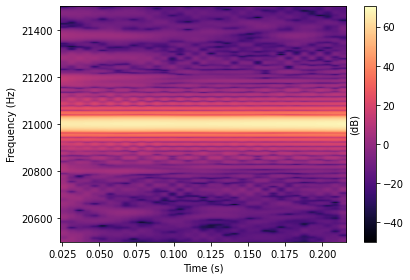

46330


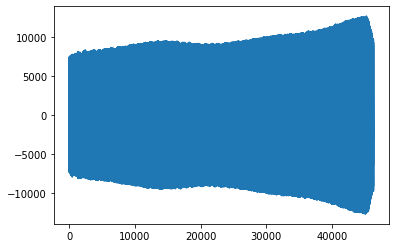

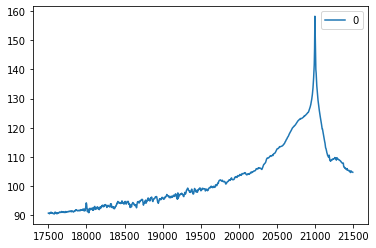

0.21354166666666666


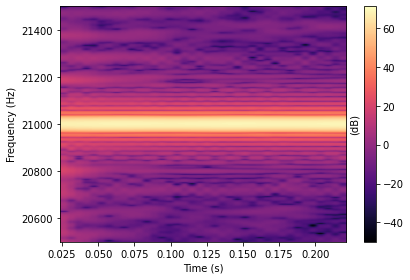

47560


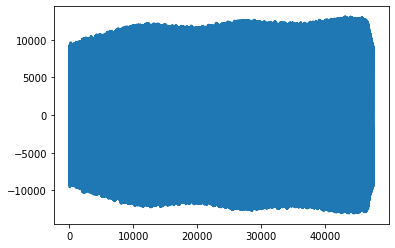

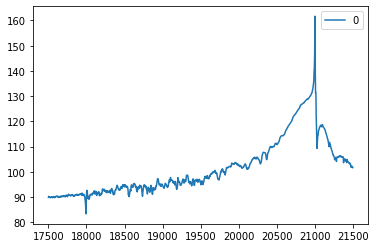

0.21875


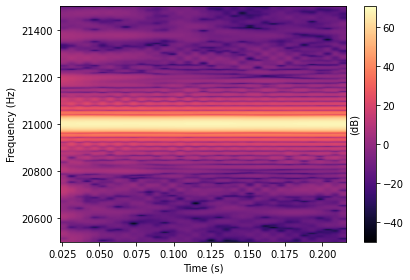

46330


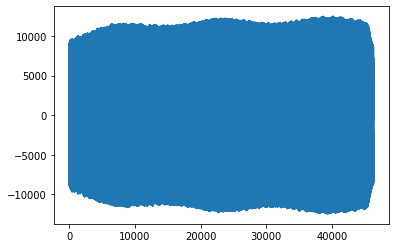

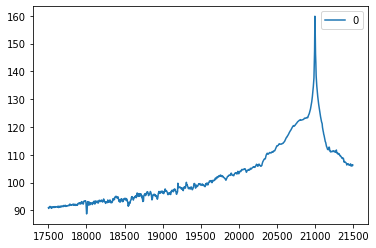

0.21354166666666666


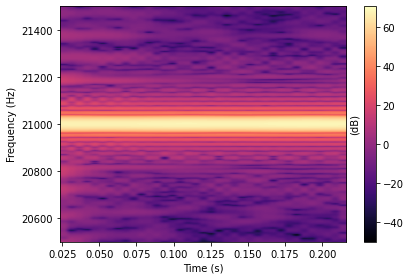

46330


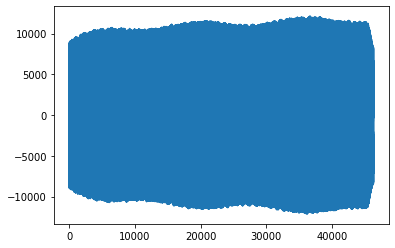

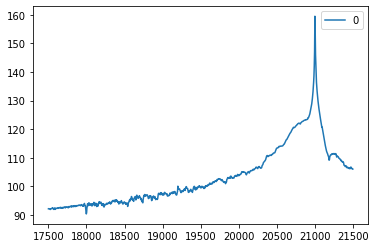

0.21354166666666666


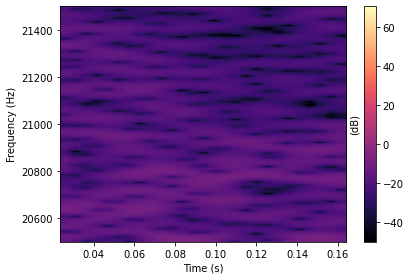

36490


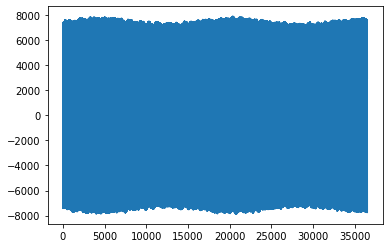

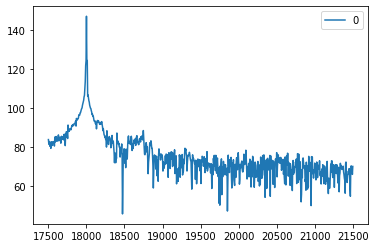

0.16145833333333334


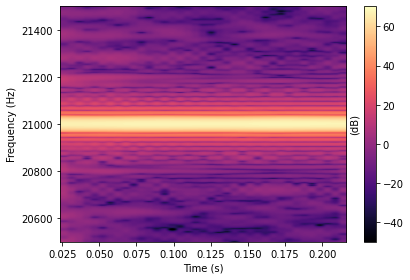

46330


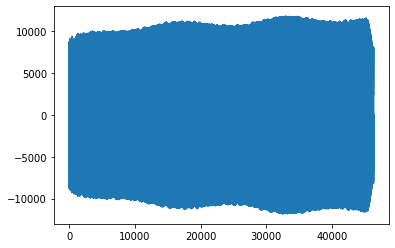

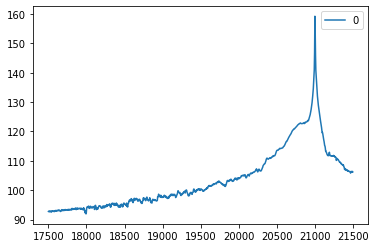

0.21354166666666666


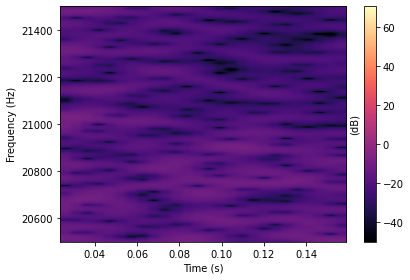

35260


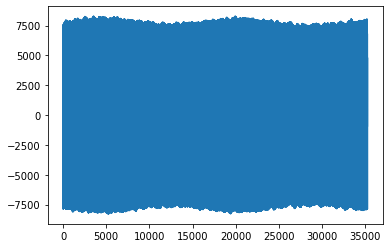

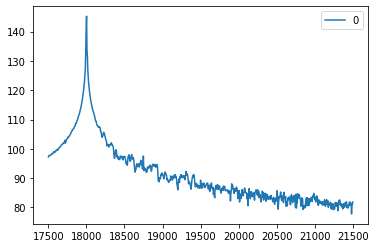

0.15625


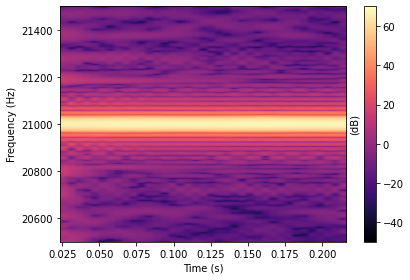

46330


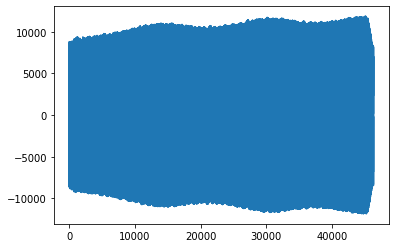

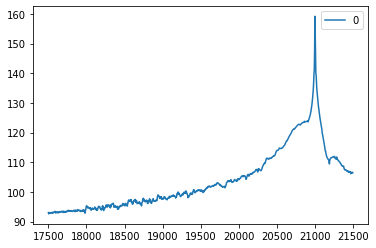

0.21354166666666666


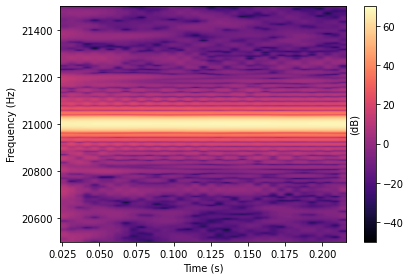

46330


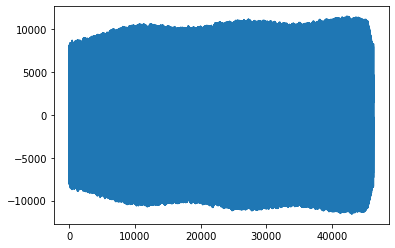

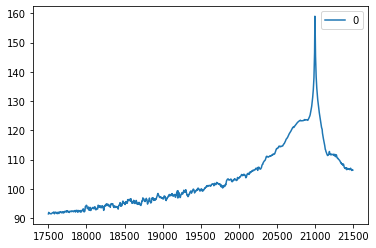

0.21354166666666666


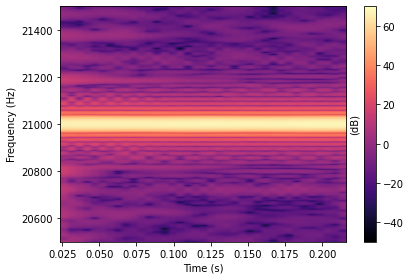

46330


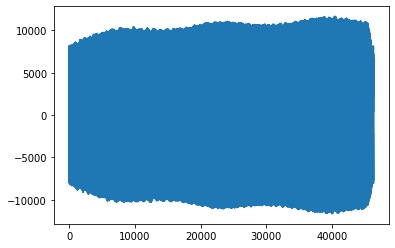

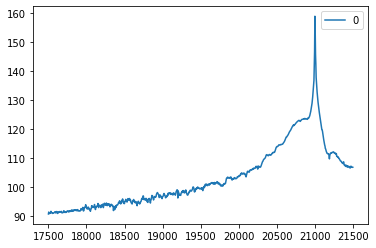

0.21354166666666666


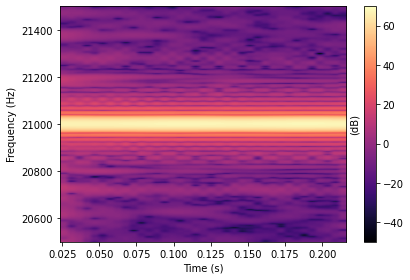

46330


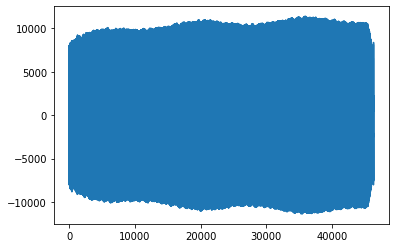

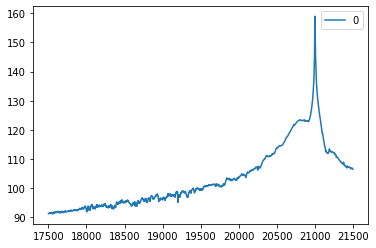

0.21354166666666666


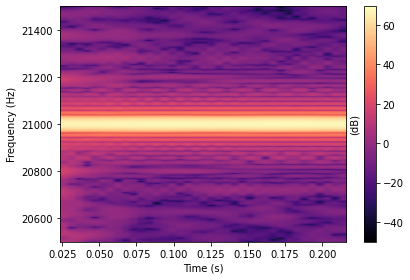

46740


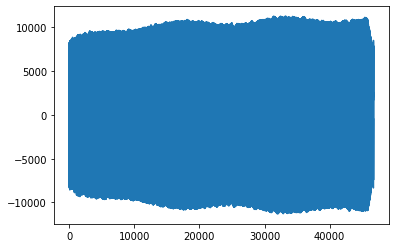

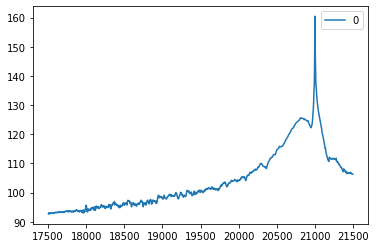

0.21354166666666666


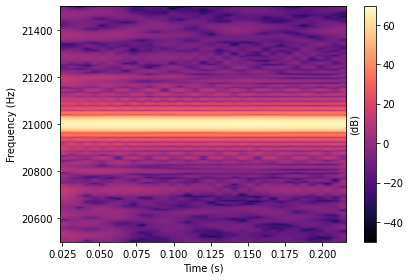

46330


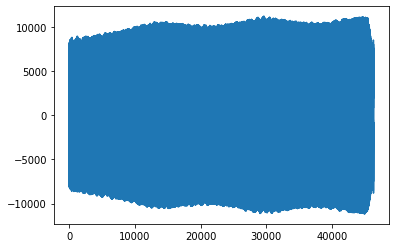

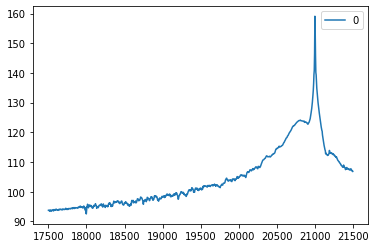

0.21354166666666666


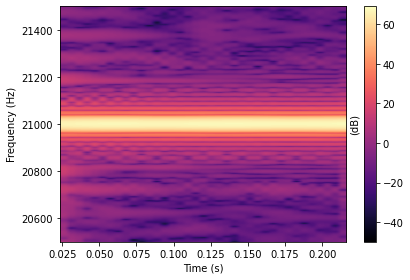

46330


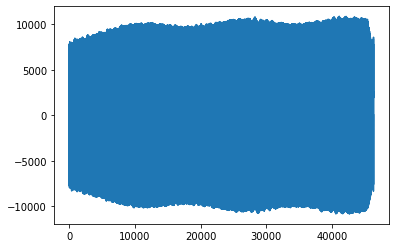

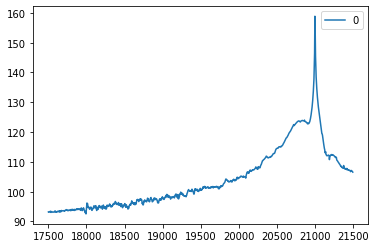

0.21354166666666666


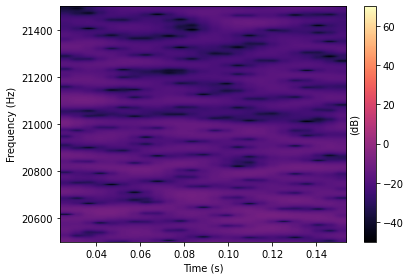

34850


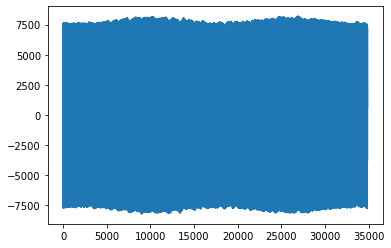

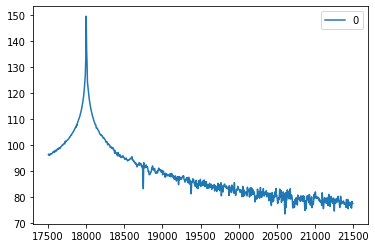

0.15104166666666666


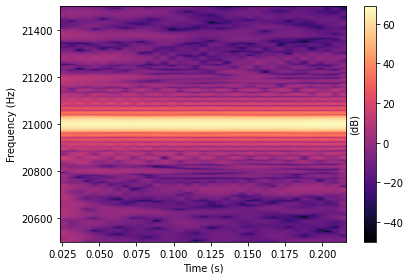

46330


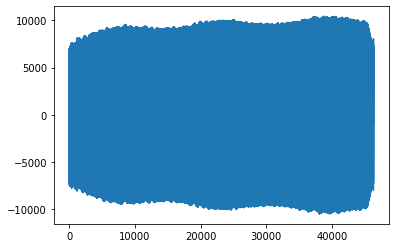

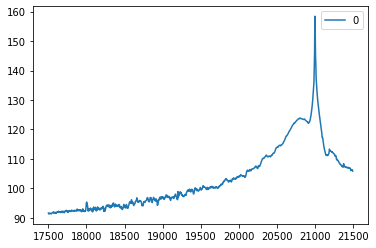

0.21354166666666666


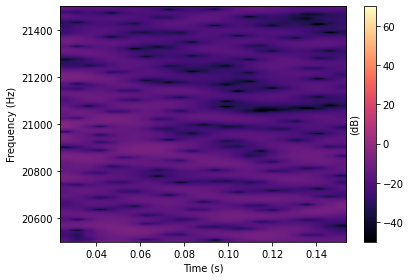

34850


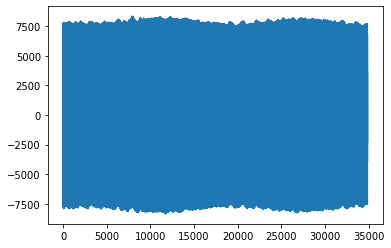

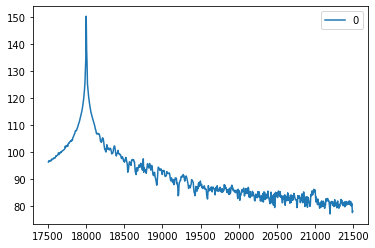

0.15104166666666666


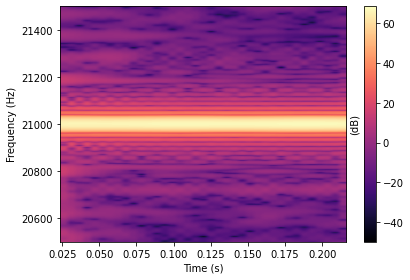

46330


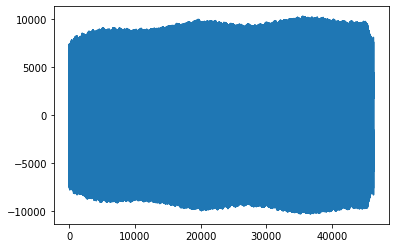

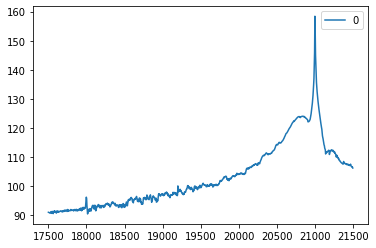

0.21354166666666666


3133

In [156]:
inverse_coef = 410
for y in sine21:
    _,_,times = visualize_spec(selected_data[y[0]*inverse_coef+int(4096*0.9):y[-1]*inverse_coef+int(4096*0.9)],10000,20500,21500,100)
    plt.plot(selected_data[y[0]*inverse_coef+int(4096*0.9):y[-1]*inverse_coef+int(4096*0.9)])
    print(len(selected_data[y[0]*inverse_coef+int(4096*0.9):y[-1]*inverse_coef+int(4096*0.9)]))
    plt.show()
    calculate_spectrum(selected_data[y[0]*inverse_coef+int(4096*0.9):y[-1]*inverse_coef+int(4096*0.9)]).T.plot()
    plt.show()
    print(times[-1])
    
gc.collect()

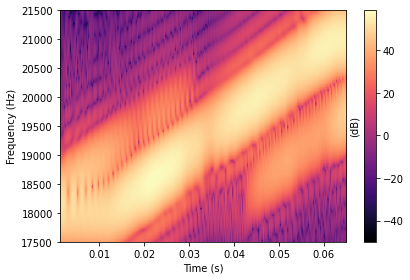

12710


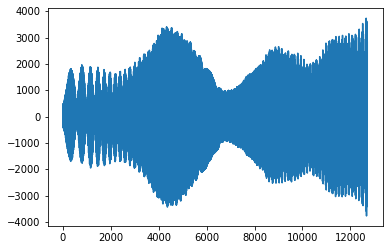

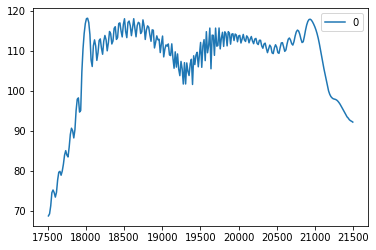

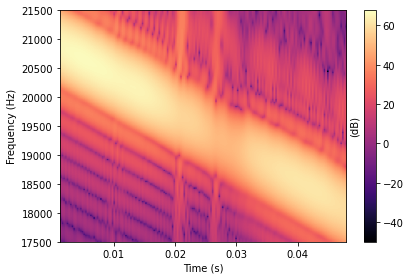

9430


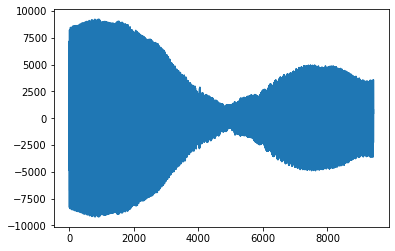

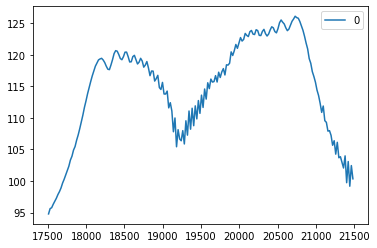

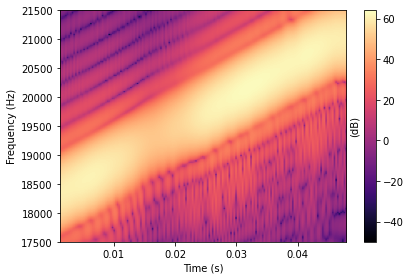

9430


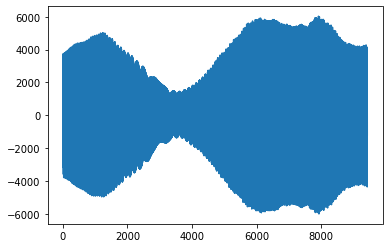

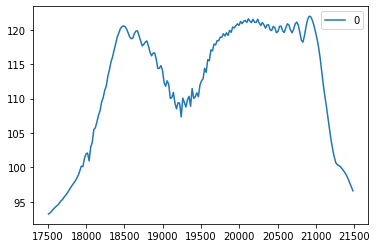

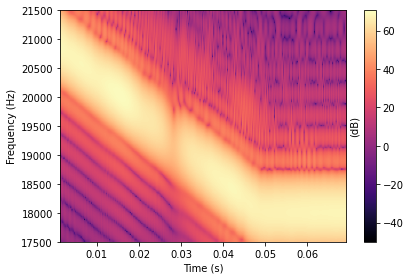

13530


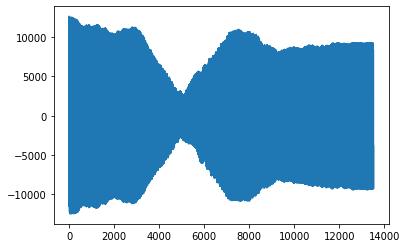

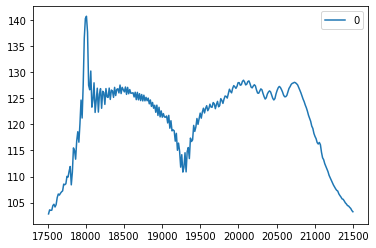

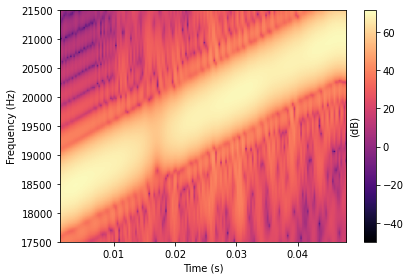

9430


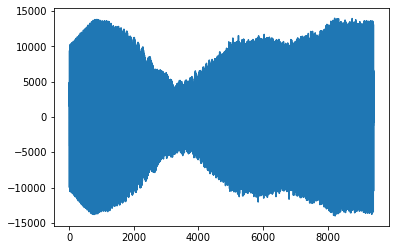

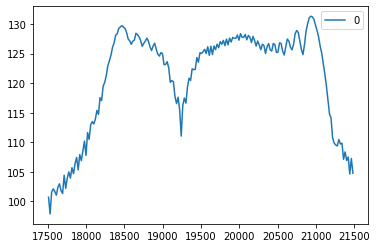

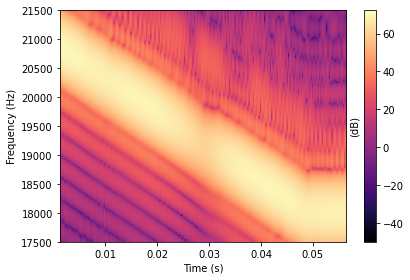

11070


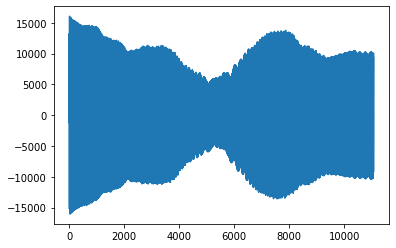

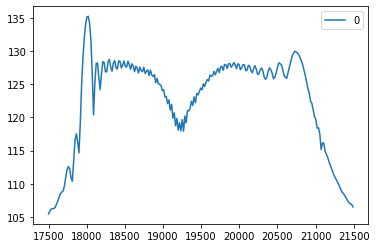

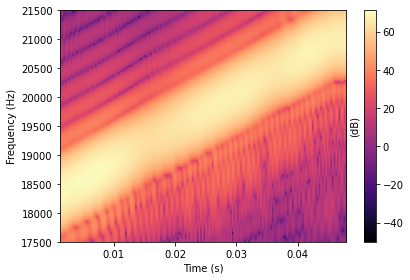

9430


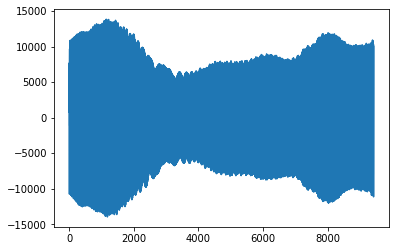

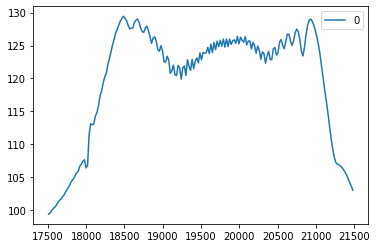

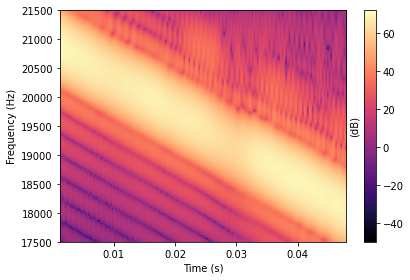

9430


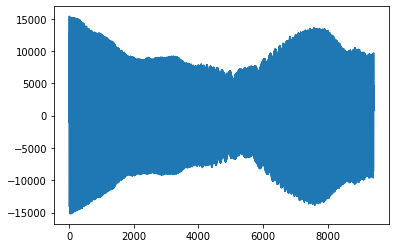

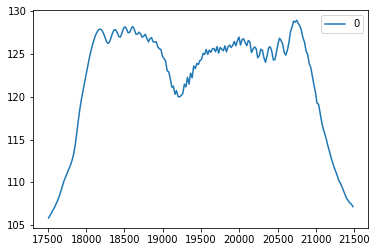

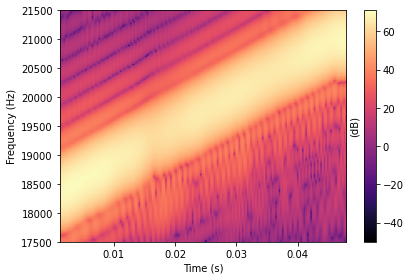

9430


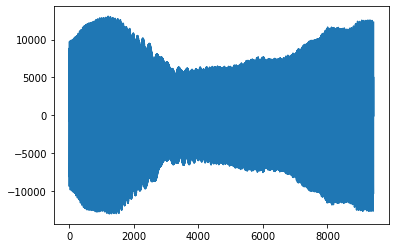

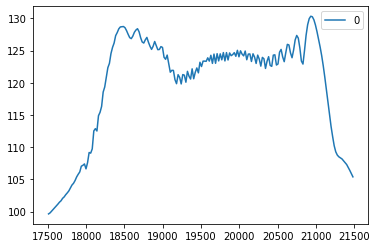

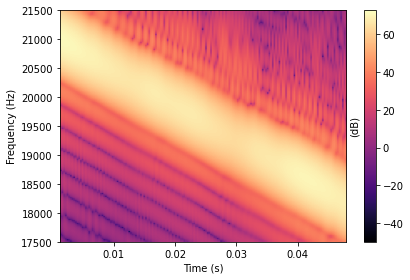

9430


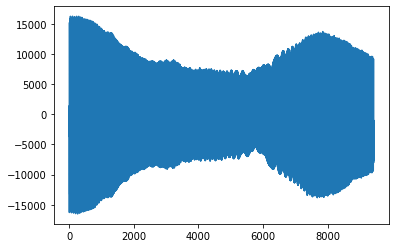

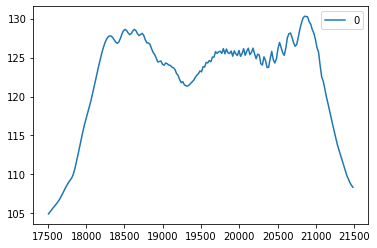

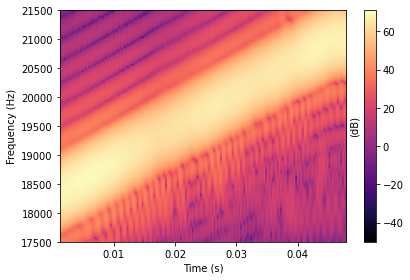

9430


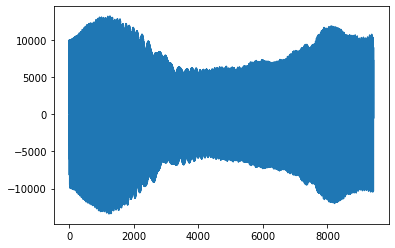

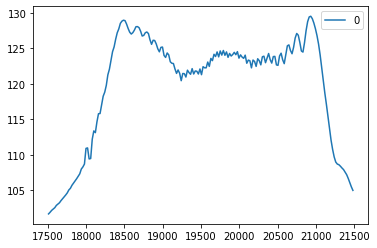

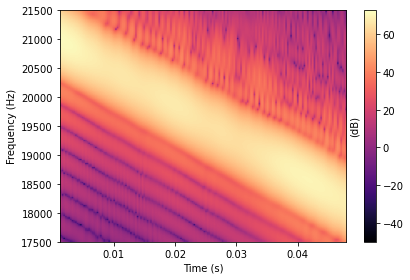

9430


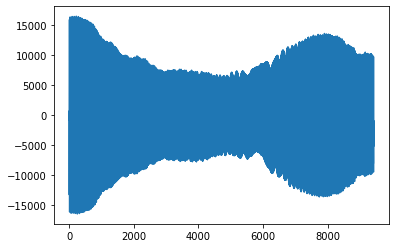

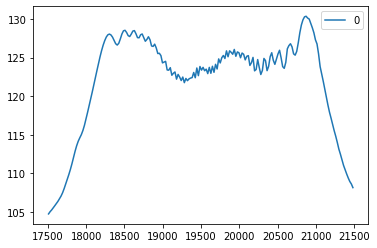

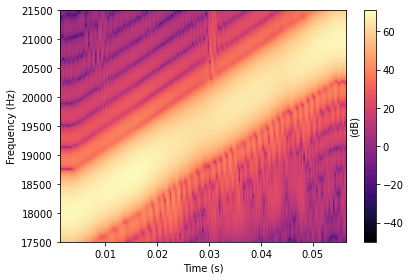

11070


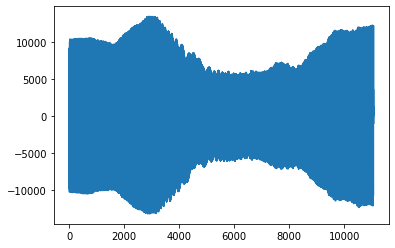

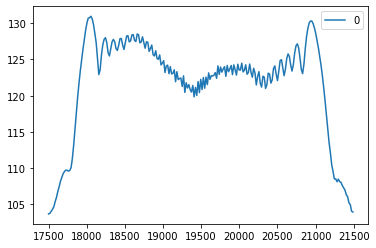

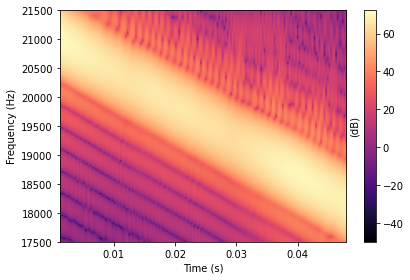

9430


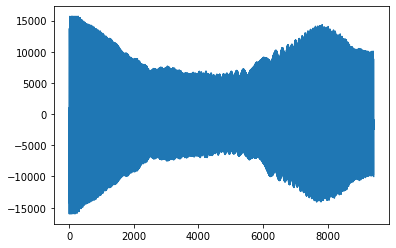

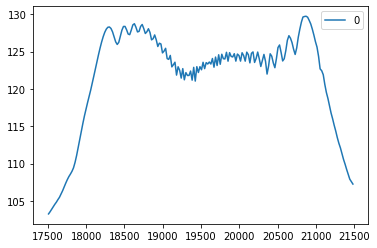

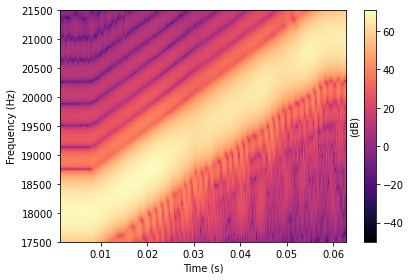

12300


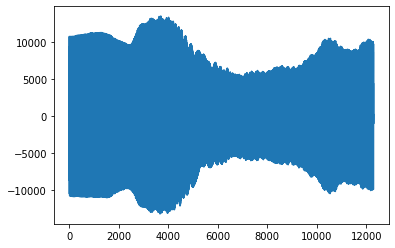

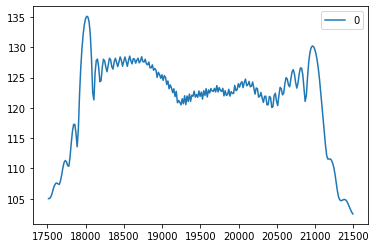

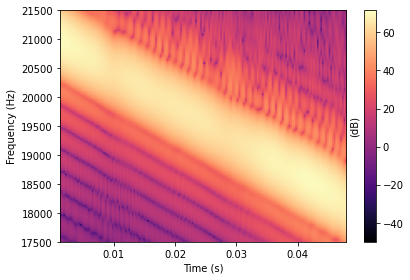

9430


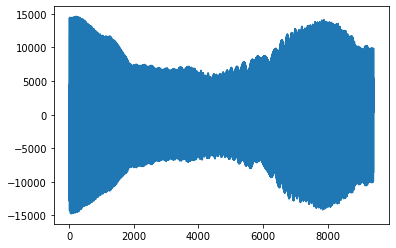

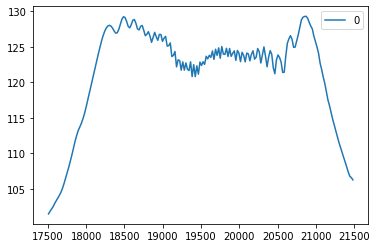

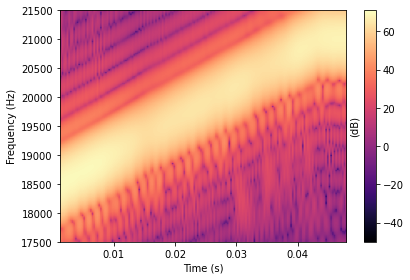

9430


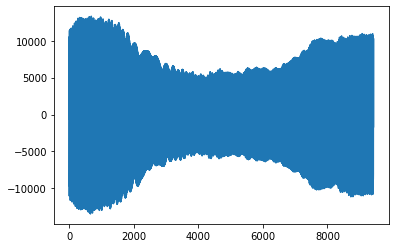

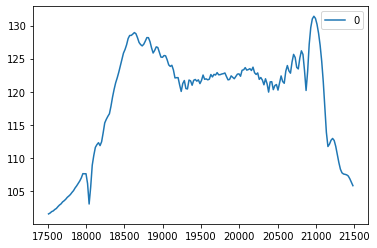

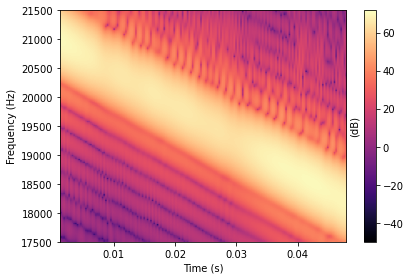

9430


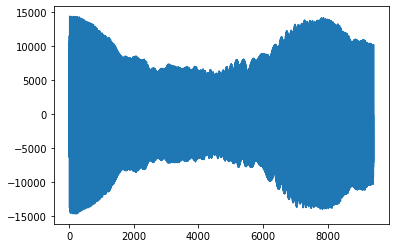

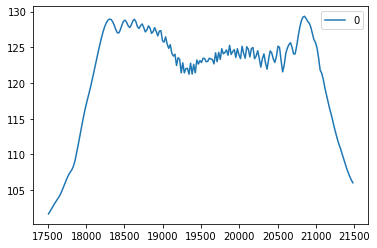

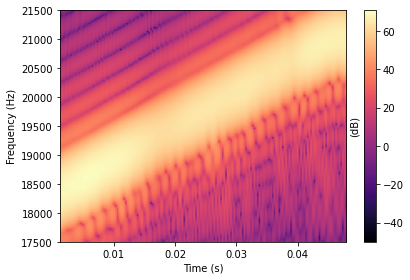

9430


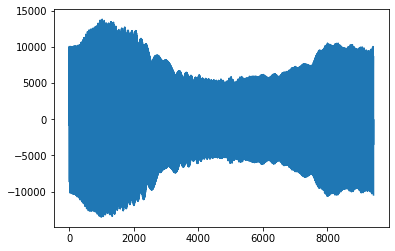

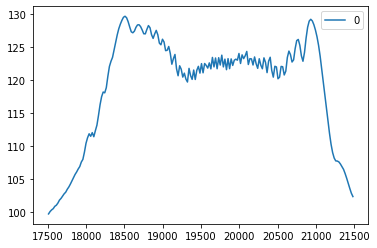

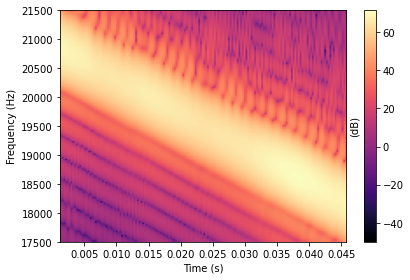

9020


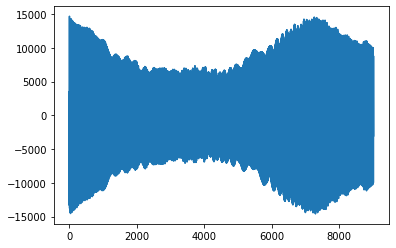

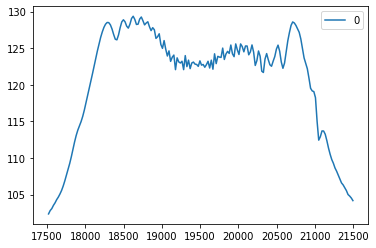

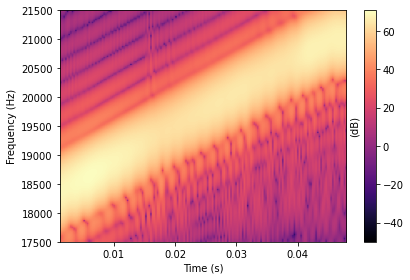

9430


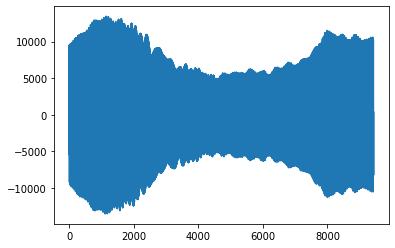

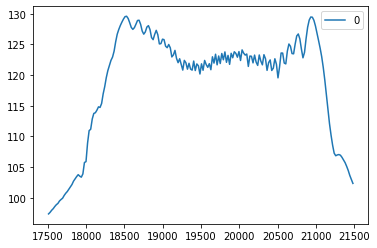

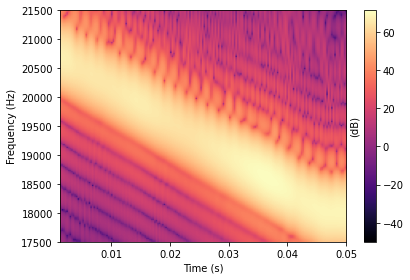

9840


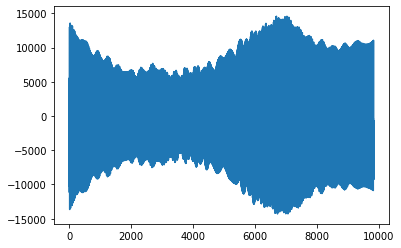

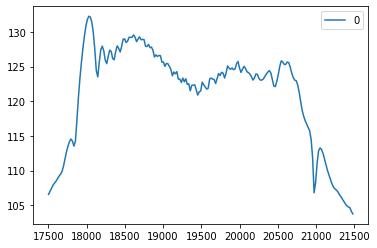

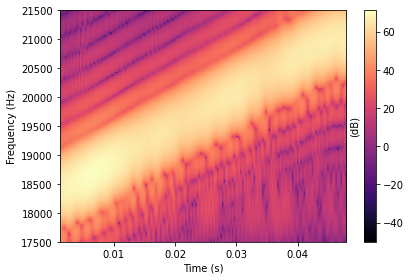

9430


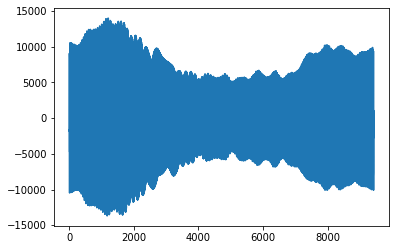

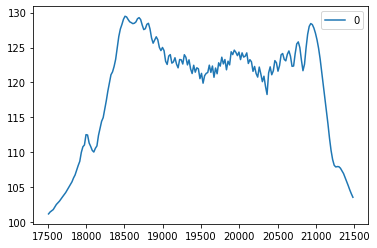

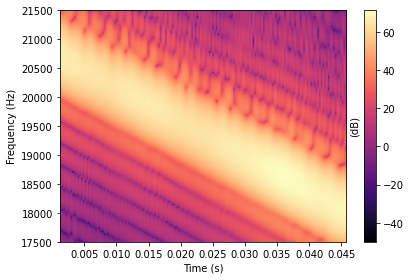

9020


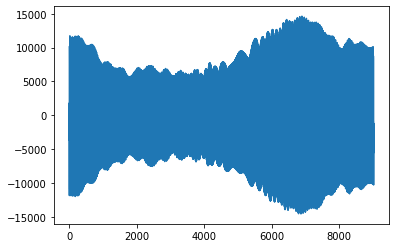

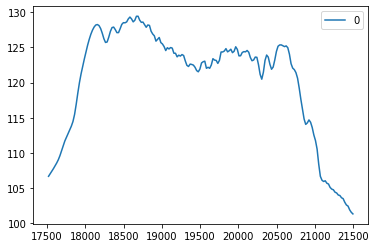

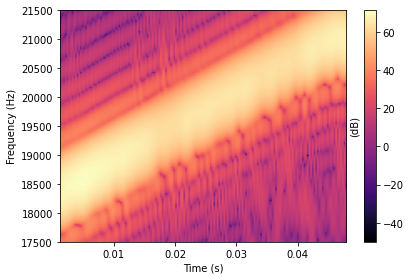

9430


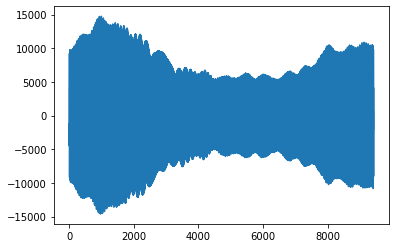

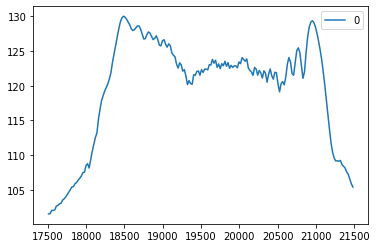

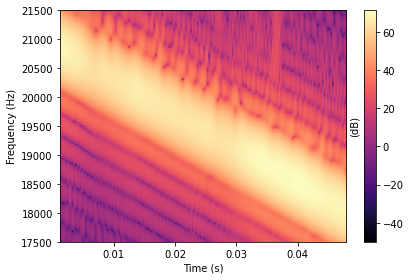

9430


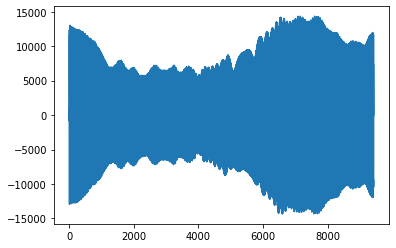

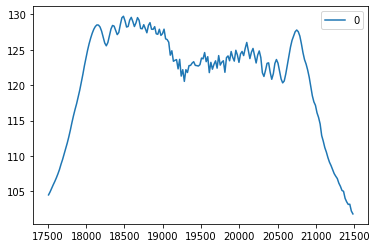

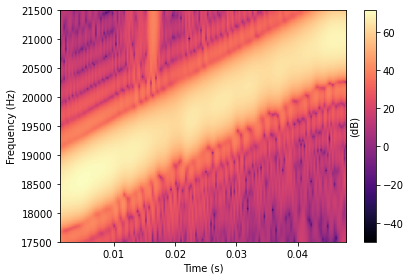

9430


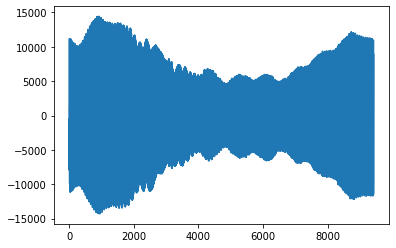

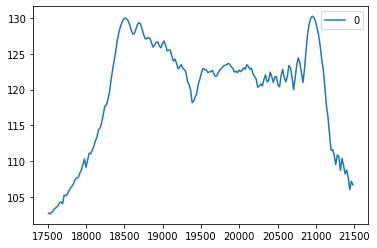

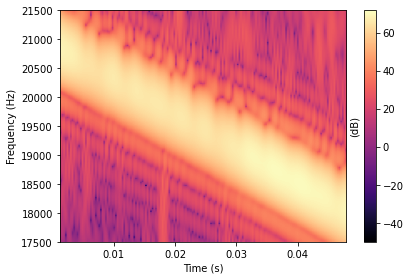

9430


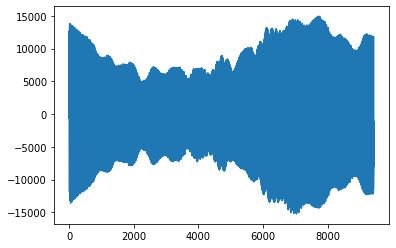

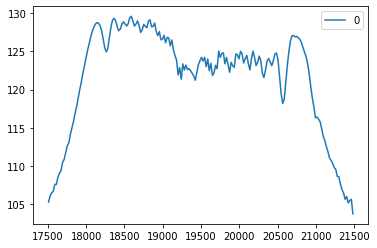

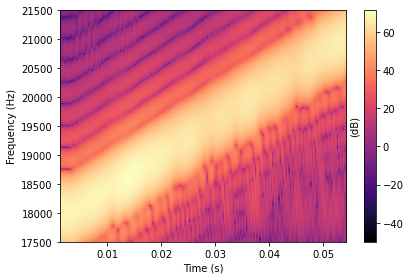

10660


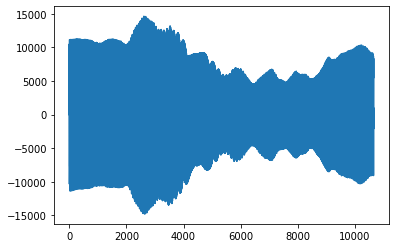

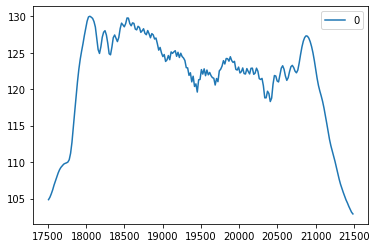

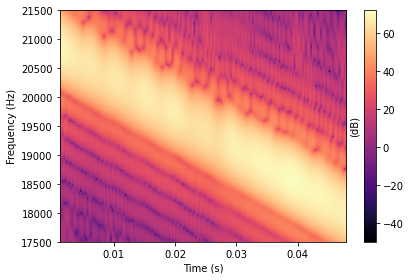

9430


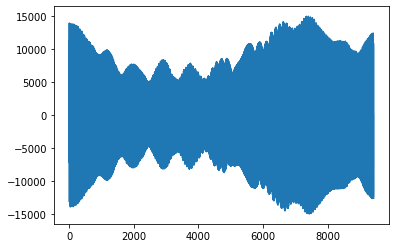

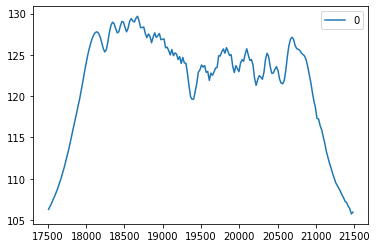

72121

In [235]:
for y in sweep:
    try:
        signal = selected_data[(y[0])*inverse_coef+int(4096*0.6):(y[-1])*inverse_coef+int(4096*0.6)]
    except:
        signal = selected_data[(y[0])*inverse_coef+int(4096*0.4):(y[-1])*inverse_coef+int(4096*0.6)]
    _,_,_ = visualize_spec(signal,512,17500,21500,100)
    plt.plot(signal)
    print(len(signal))
    plt.show()
    calculate_spectrum(signal).T.plot()
    plt.show()
gc.collect()

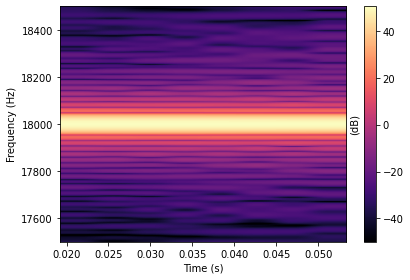

13939


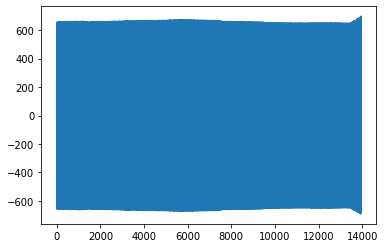

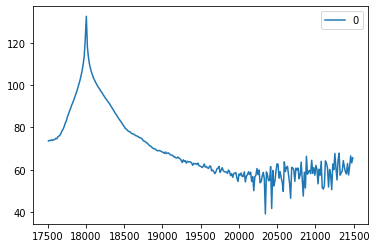

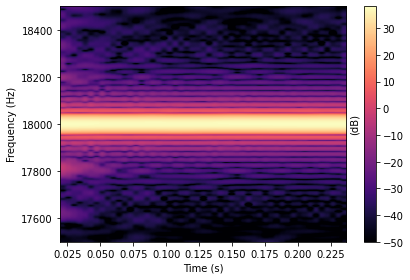

49199


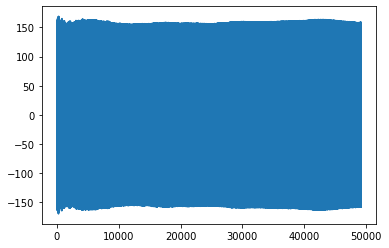

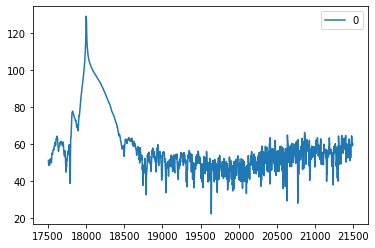

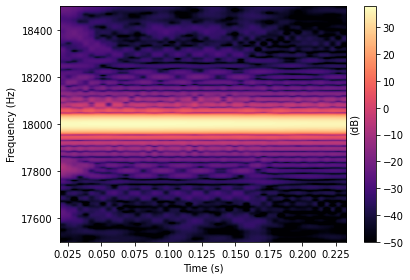

48789


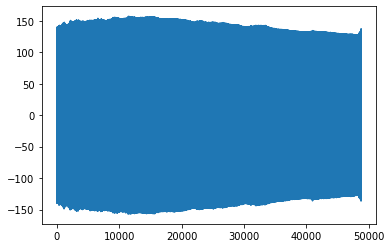

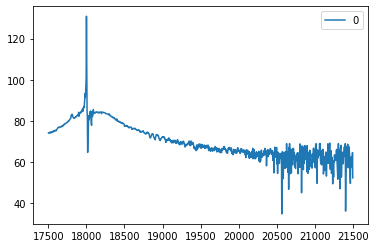

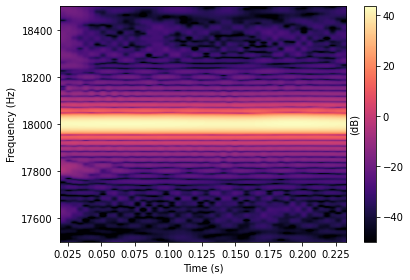

48789


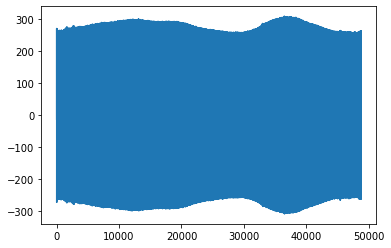

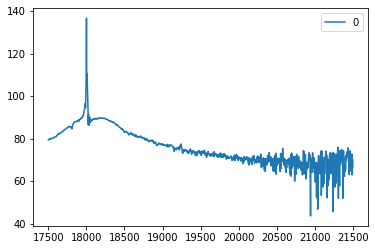

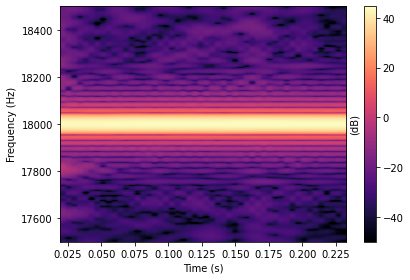

48789


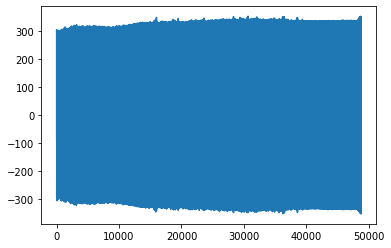

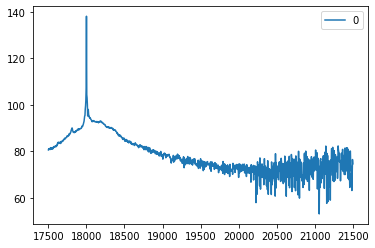

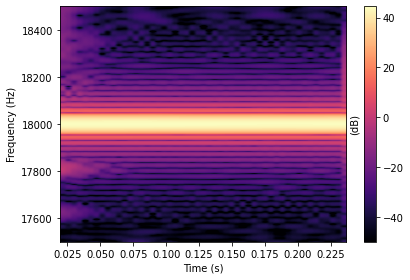

49199


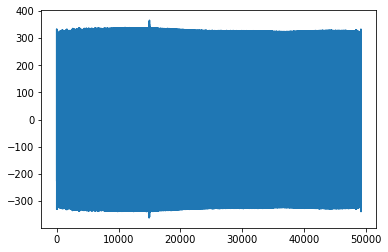

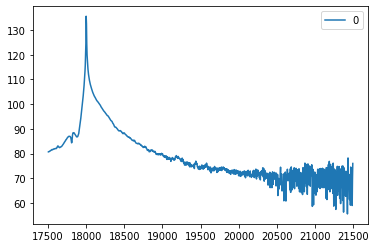

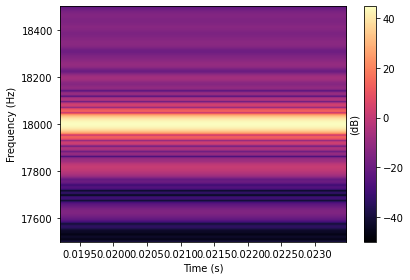

8199


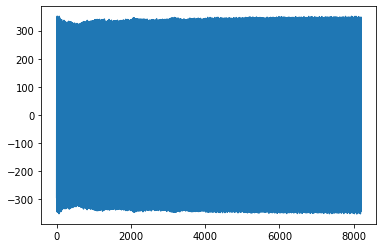

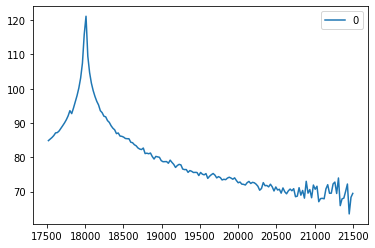

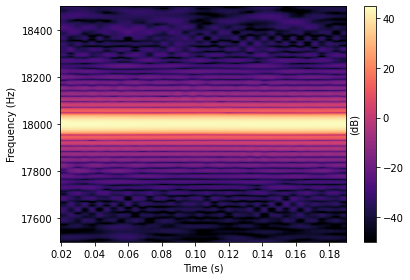

40589


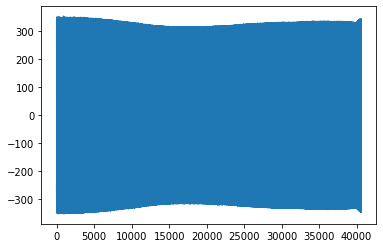

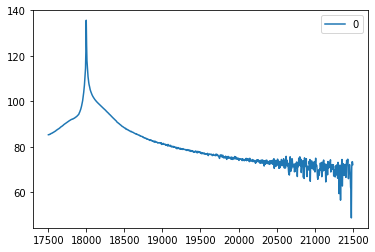

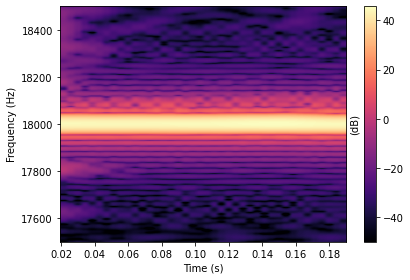

40179


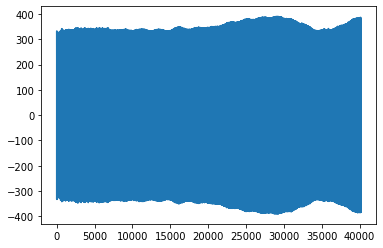

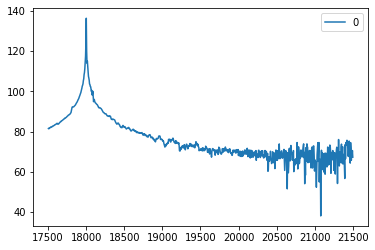

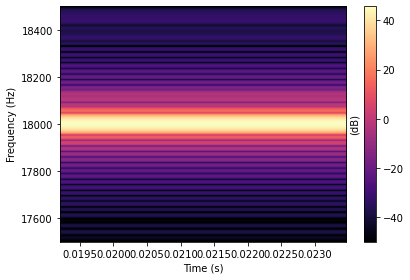

8609


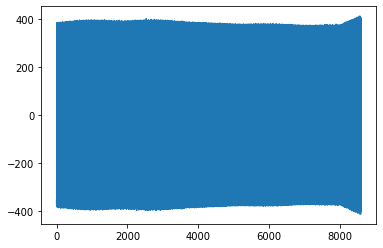

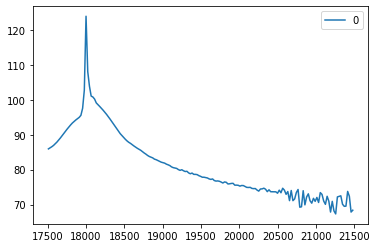

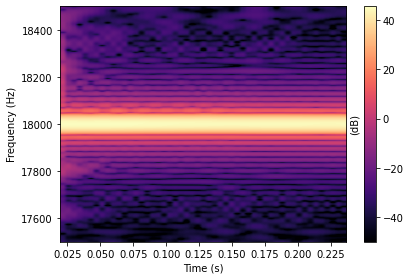

49199


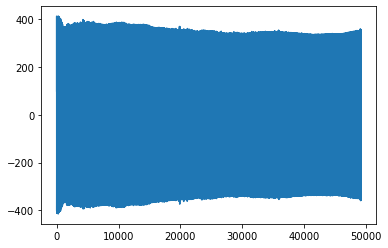

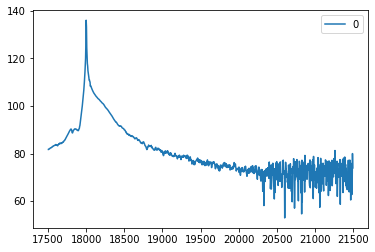

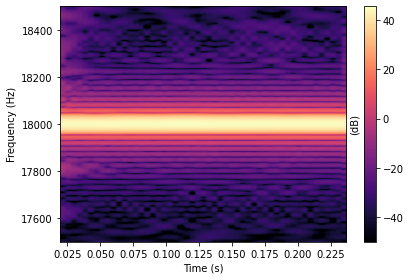

49199


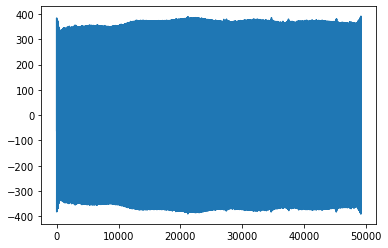

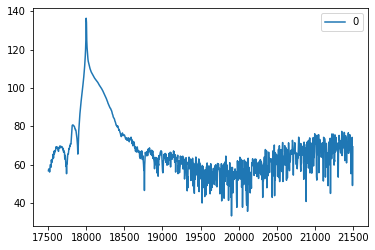

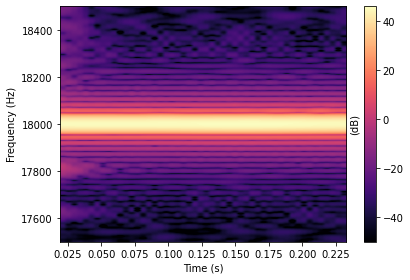

48789


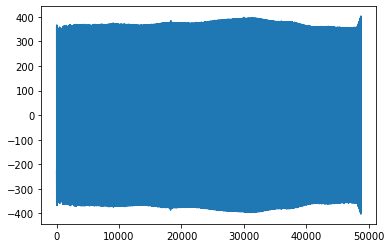

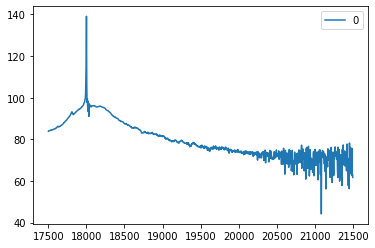

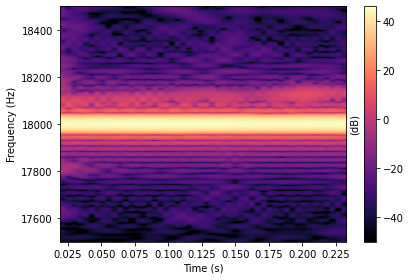

48789


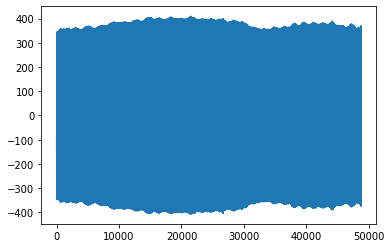

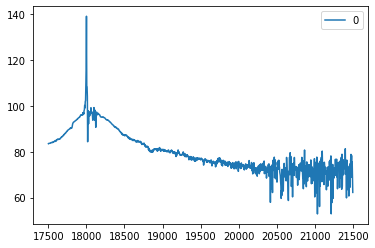

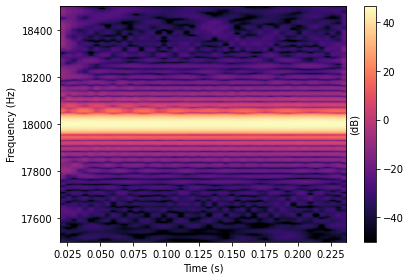

49199


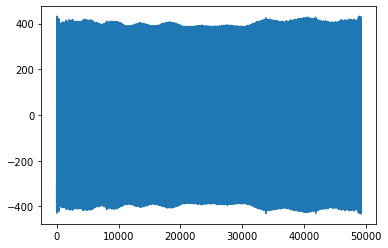

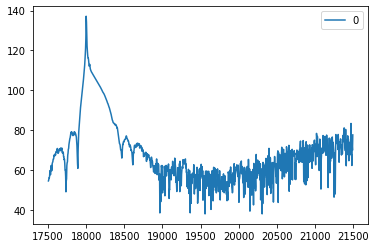

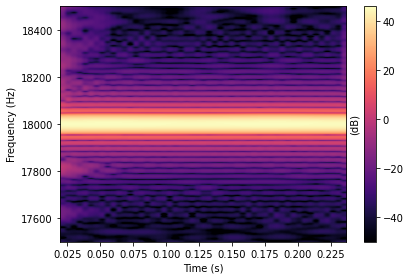

49609


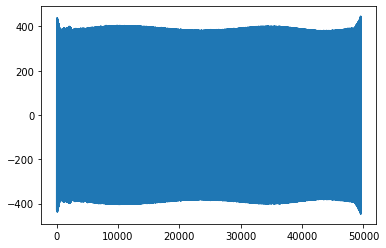

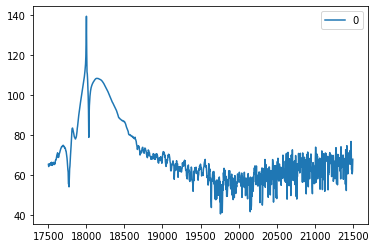

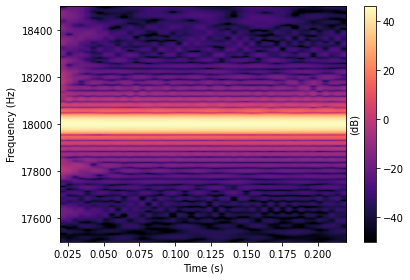

45919


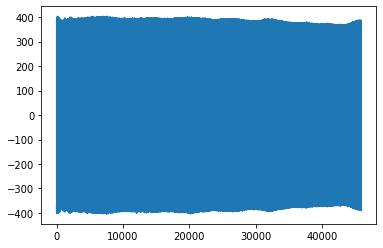

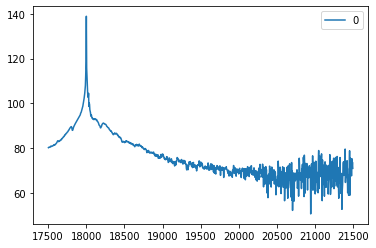

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: UserWarning: Only one segment is calculated since parameter NFFT (=8192) >= signal length (=3279).


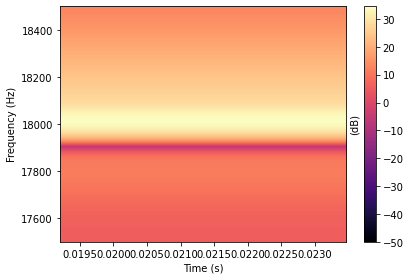

3279


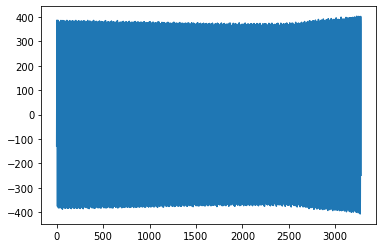

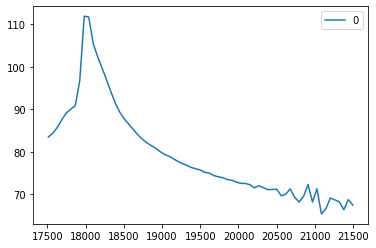

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: UserWarning: Only one segment is calculated since parameter NFFT (=8192) >= signal length (=4509).


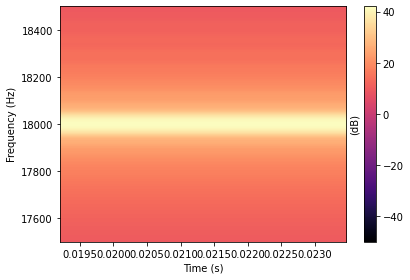

4509


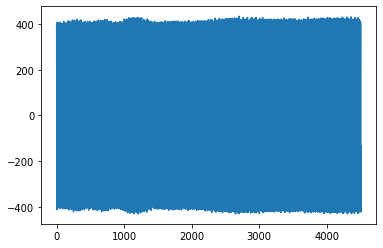

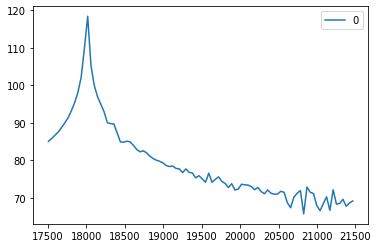

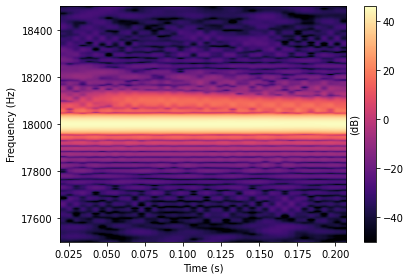

43869


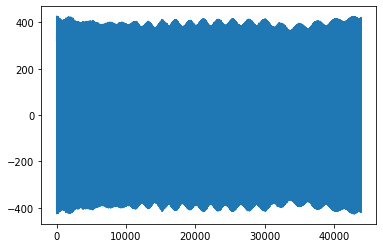

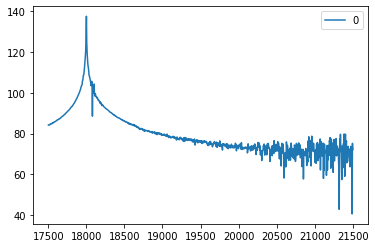

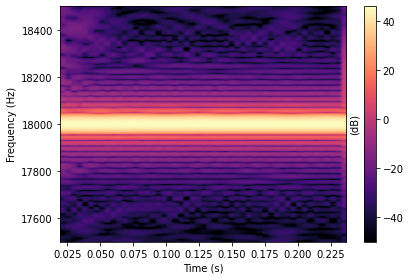

49199


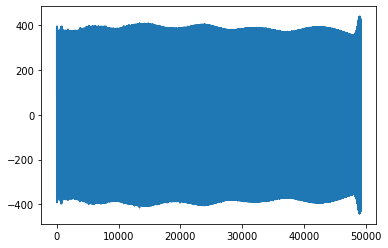

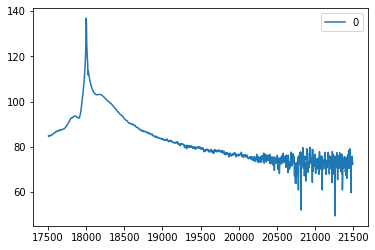

46908

In [1271]:
for y in sine18:
    signal = selected_data[y[0]*inverse_coef+int(4096*0.4):y[-1]*inverse_coef+int(4096*0.6)]
    _,_,_ = visualize_spec(signal,8192,17500,18500,125)
    plt.plot(signal)
    print(len(signal))
    plt.show()
    calculate_spectrum(signal).T.plot()
    plt.show()
gc.collect()

In [284]:
plt.plot(estimated_)

[[121,
  122,
  123,
  124,
  125,
  126,
  127,
  128,
  129,
  130,
  131,
  132,
  133,
  134,
  135,
  136,
  137,
  138,
  139,
  140,
  141,
  142,
  143,
  144],
 [266,
  267,
  268,
  269,
  270,
  271,
  272,
  273,
  274,
  275,
  276,
  277,
  278,
  279,
  280,
  281,
  282,
  283,
  284,
  285,
  286,
  287,
  288,
  289]]

# Sine wave projection

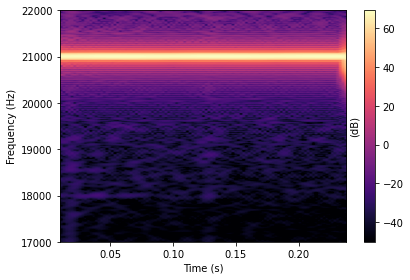

In [962]:
inverse_coef = 410
for y in sine21:
    Pxx_p,freqs_p,times_p = visualize_fft(selected_data[y[0]*inverse_coef+int(4096*0.9):y[-1]*inverse_coef+int(4096*0.9)])
    break

# Plot 2D image

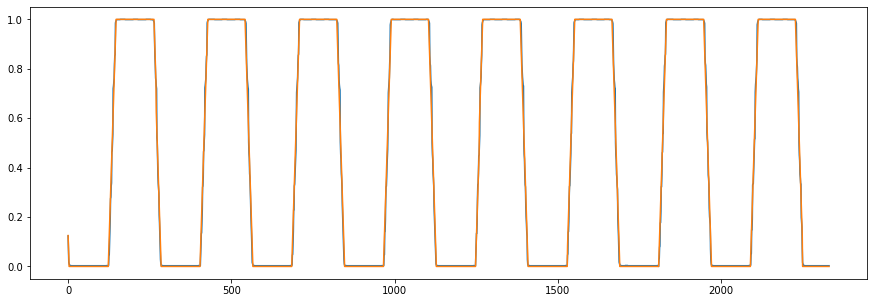

In [1000]:
plt.figure(figsize=(15,5))
plt.plot(normalized_df)
plt.plot(approx_sig)
plt.savefig("visual/20211021/us_bicycle_approaching/"+ "signal_estimation" +".png")

In [1272]:
def plot_2d_image(data, vmax, name, n):
    plt.figure(figsize=(15,5))
    plt.xlabel("Time (s)", fontsize=14)
    plt.ylabel("Frequency (Hz)", fontsize=14)
    #dynamicRange = 100#30 #change this to change the color scale. 
    #vmin = 20*np.log10(np.max(data)) - dynamicRange
    plt.imshow(data,cmap='magma',vmax=vmax, interpolation='nearest', origin='lower',extent=[data.columns.values[0],data.columns.values[-1],data.index.values[0],data.index.values[-1]], aspect='auto')#vmax=2 for sine21 and sweep,#vmax=0.1 for sine18
    plt.colorbar()
    
    #plt.savefig("visual/20211021/us_bicycle_approaching/" + name + "_" +str(n)+".png")
    plt.show()

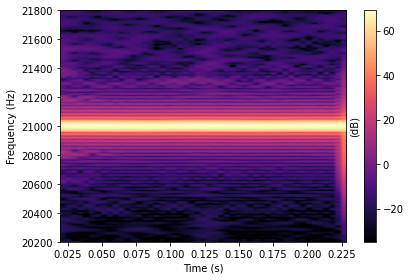

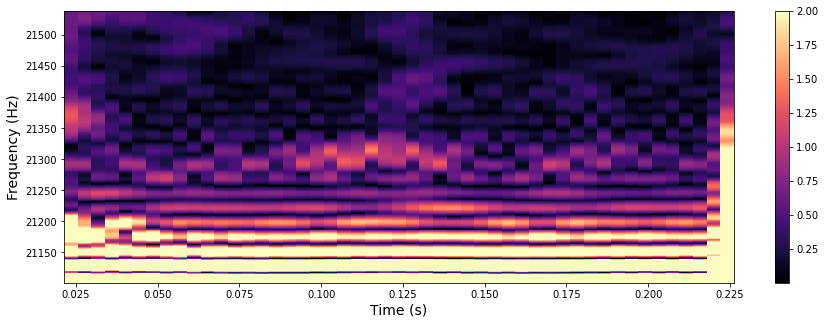

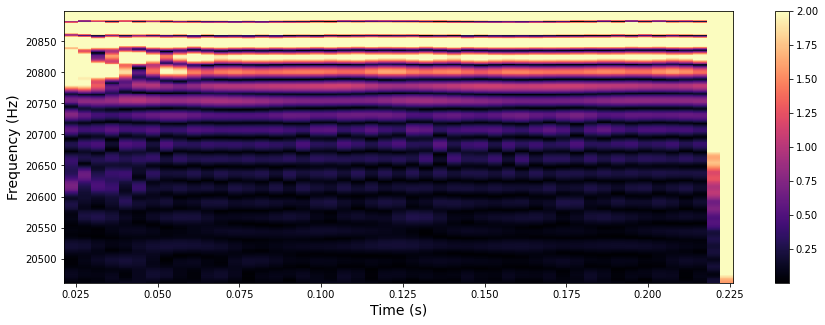

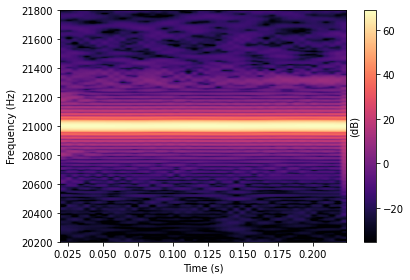

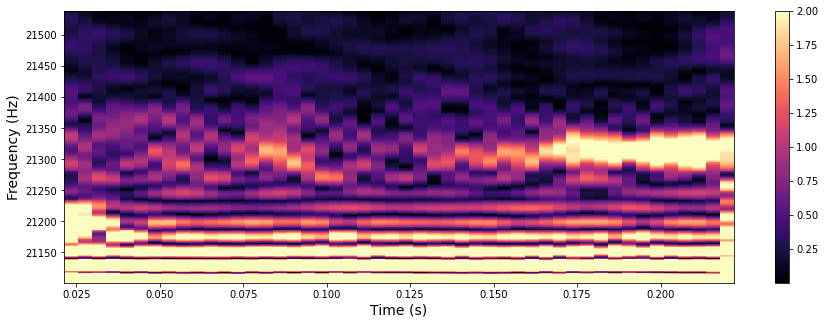

...

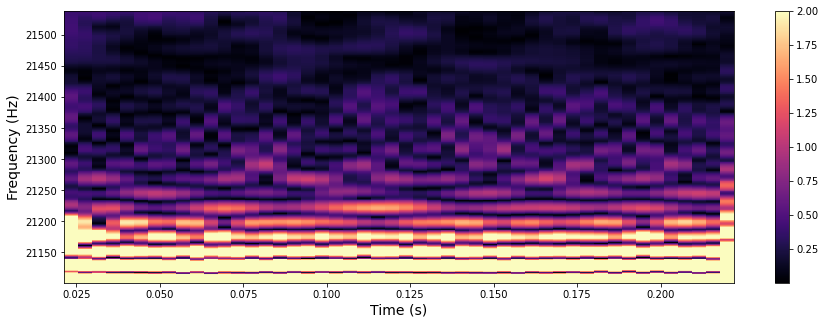

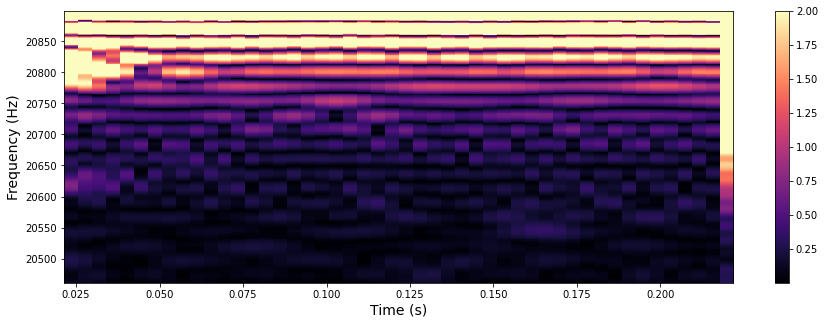

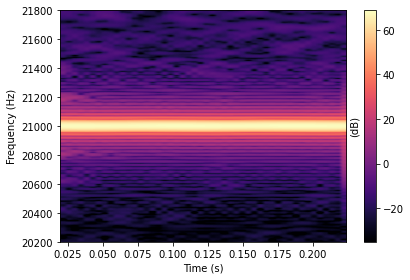

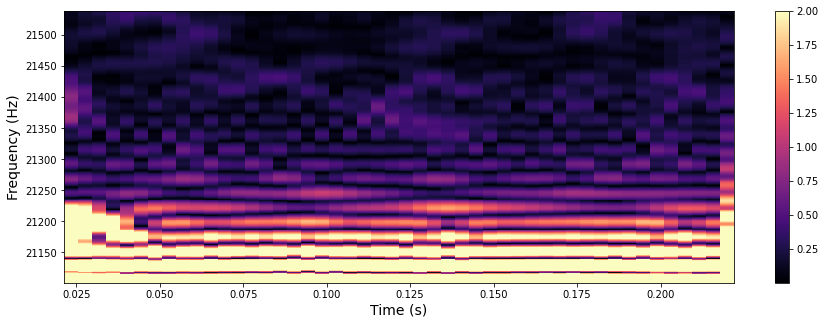

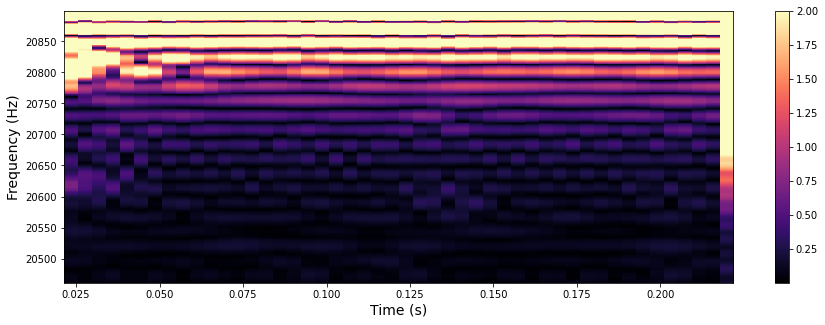

5032

In [1004]:
inverse_coef = 410
n=0
for y in sine21:
    Pxx_p,freqs_p,times_p = visualize_spec(selected_data[y[0]*inverse_coef+int(4096*0.9):y[-1]*inverse_coef+int(4096*0.9)],8192,20200,21800,110,"sine21",n)
    df_Pxx_p = pd.DataFrame(Pxx_p, index=freqs_p, columns=times_p)
    plot_2d_image(df_Pxx_p.loc[df_Pxx_p.index>21100].head(300), 2,"sine21top",n)
    plot_2d_image(df_Pxx_p.loc[df_Pxx_p.index<20900].tail(300), 2,"sine21bottom",n)
    n=n+1
    #break
gc.collect()

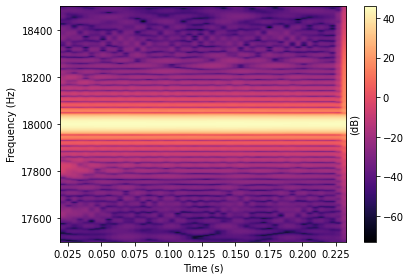

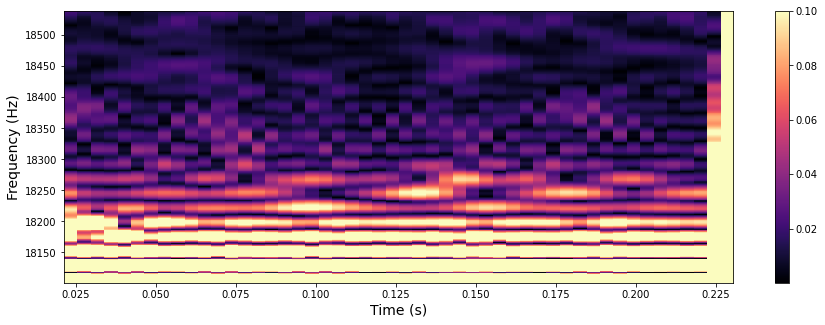

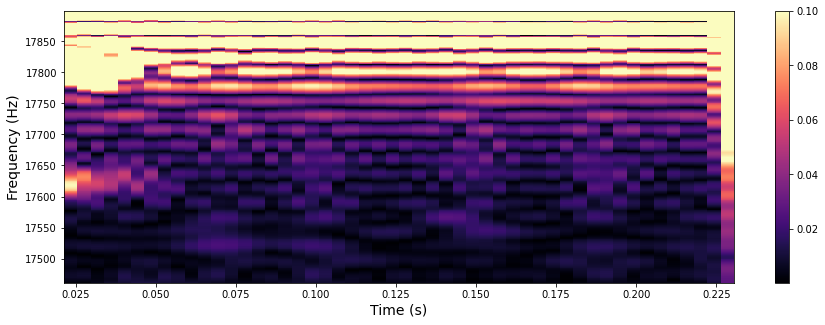

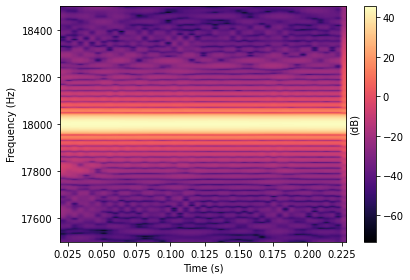

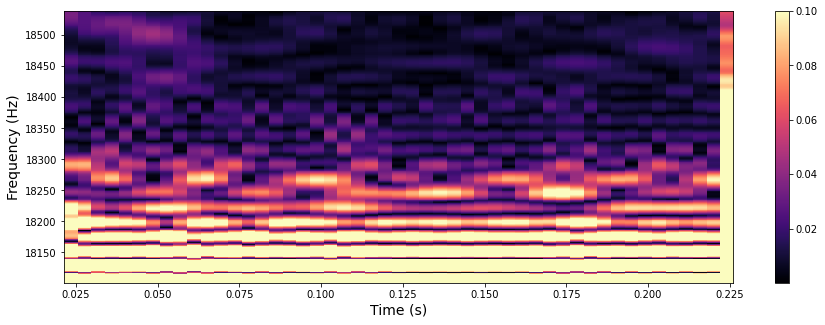

...

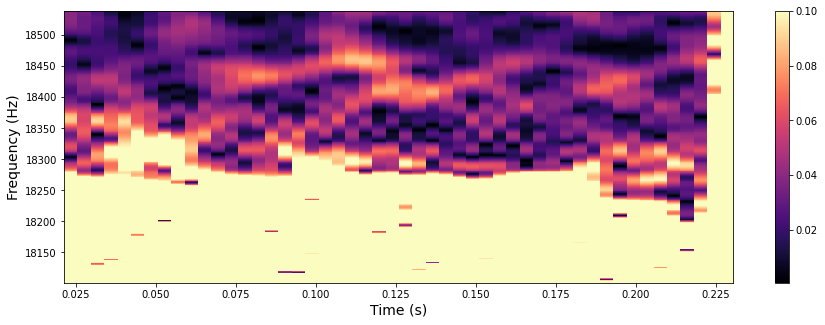

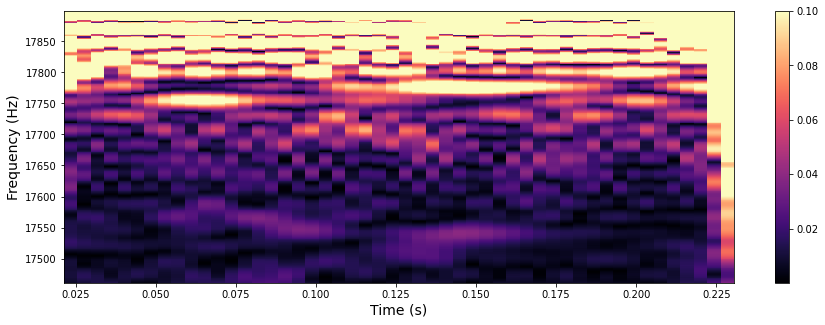

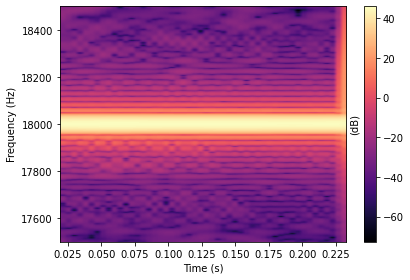

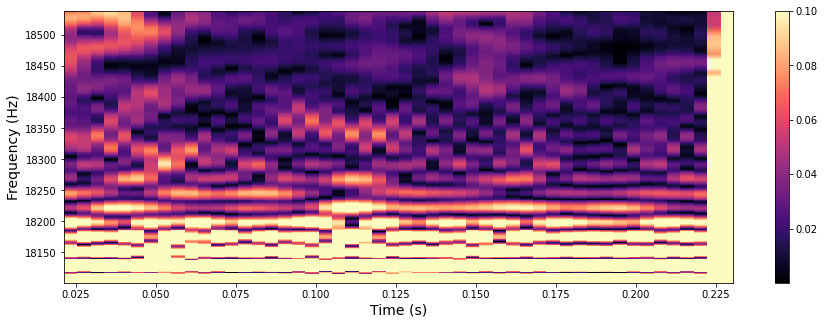

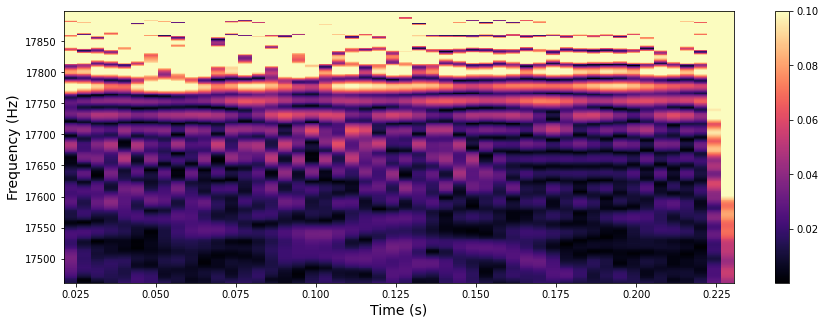

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: UserWarning: Only one segment is calculated since parameter NFFT (=8192) >= signal length (=7380).


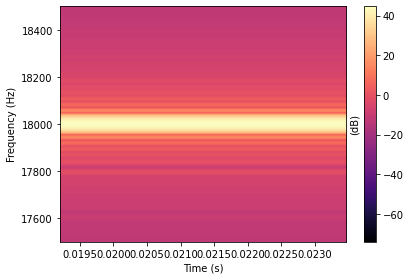

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: Attempting to set identical left == right == 0.021333333333333333 results in singular transformations; automatically expanding.
  import sys


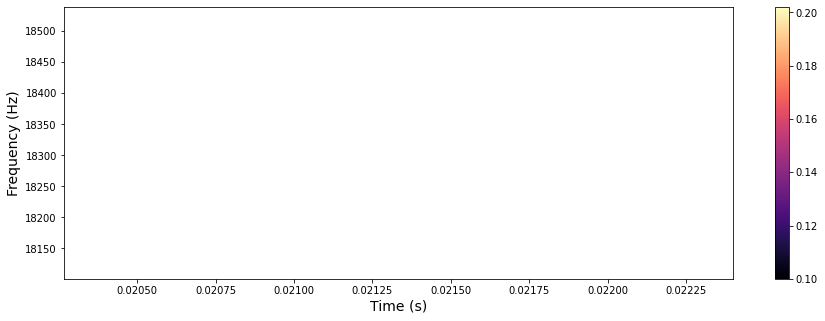

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: Attempting to set identical left == right == 0.021333333333333333 results in singular transformations; automatically expanding.
  import sys


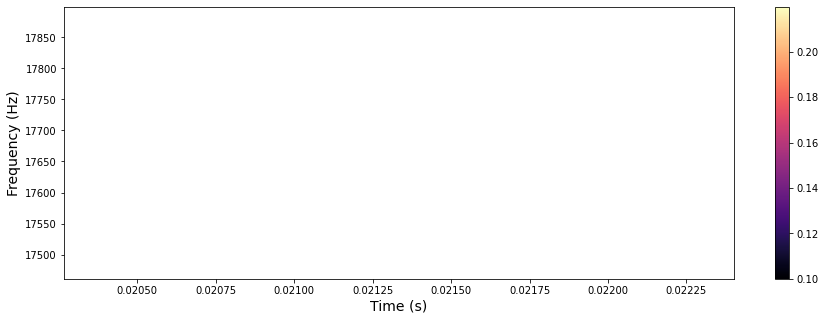

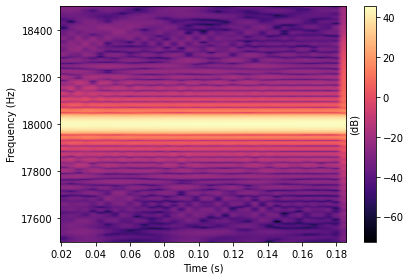

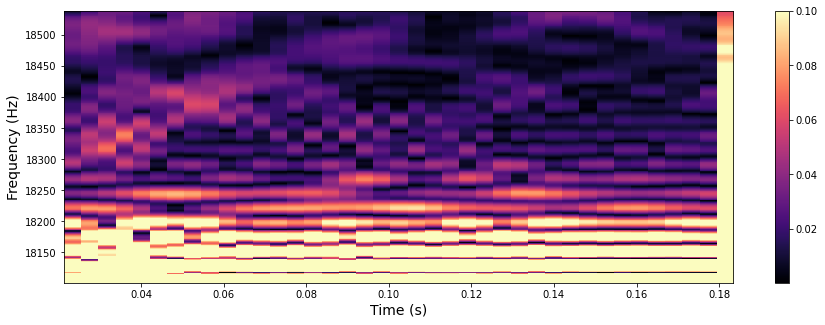

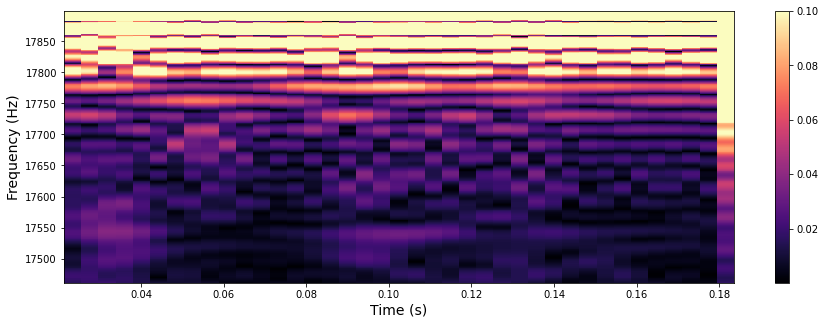

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: UserWarning: Only one segment is calculated since parameter NFFT (=8192) >= signal length (=2870).


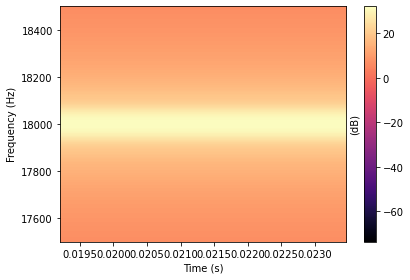

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: Attempting to set identical left == right == 0.021333333333333333 results in singular transformations; automatically expanding.
  import sys


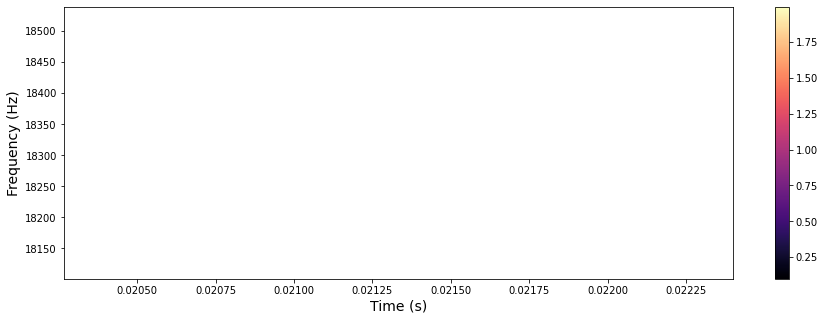

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: Attempting to set identical left == right == 0.021333333333333333 results in singular transformations; automatically expanding.
  import sys


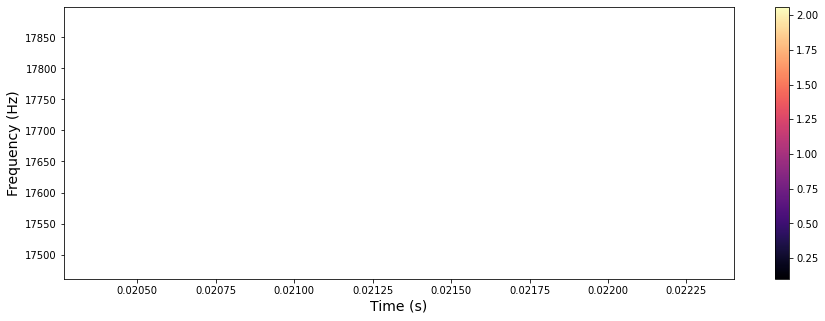

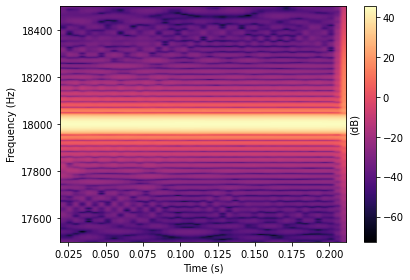

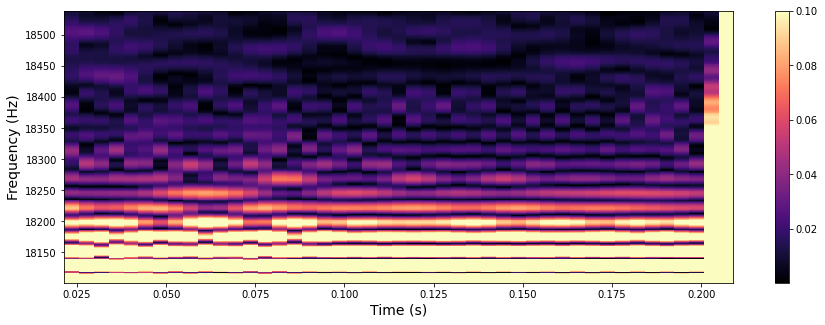

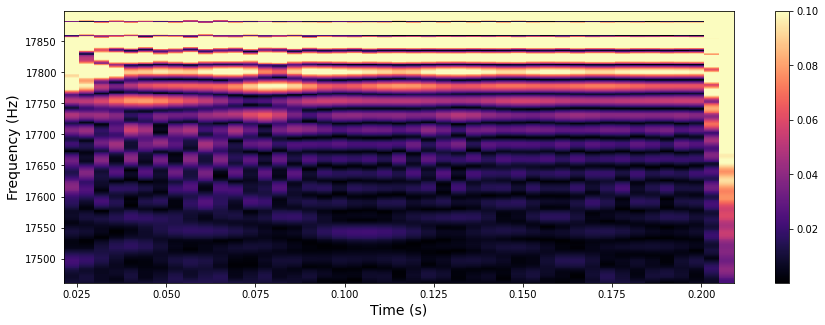

24413

In [1006]:
inverse_coef = 410
n=0
for y in sine18:
    Pxx_p,freqs_p,times_p = visualize_spec(selected_data[y[0]*inverse_coef+int(4096*0.9):y[-1]*inverse_coef+int(4096*0.9)],8192,17500,18500,125,"sine18",n)
    df_Pxx_p = pd.DataFrame(Pxx_p, index=freqs_p, columns=times_p)
    plot_2d_image(df_Pxx_p.loc[df_Pxx_p.index>18100].head(300),0.1,"sine18top",n)
    plot_2d_image(df_Pxx_p.loc[df_Pxx_p.index<17900].tail(300),0.1,"sine18bottom",n)
    n=n+1
gc.collect()

In [181]:
df_Pxx_p = pd.DataFrame(Pxx_p, index=freqs_p, columns=times_p[:-14])

# For sine waves

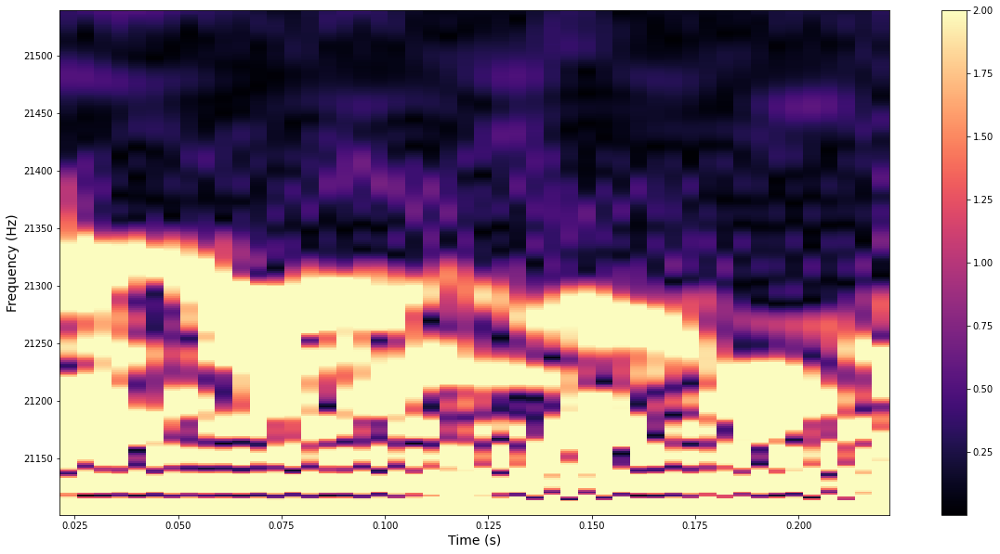

In [480]:
plot_2d_image(df_Pxx_p.loc[df_Pxx_p.index>21100].head(300), 2)

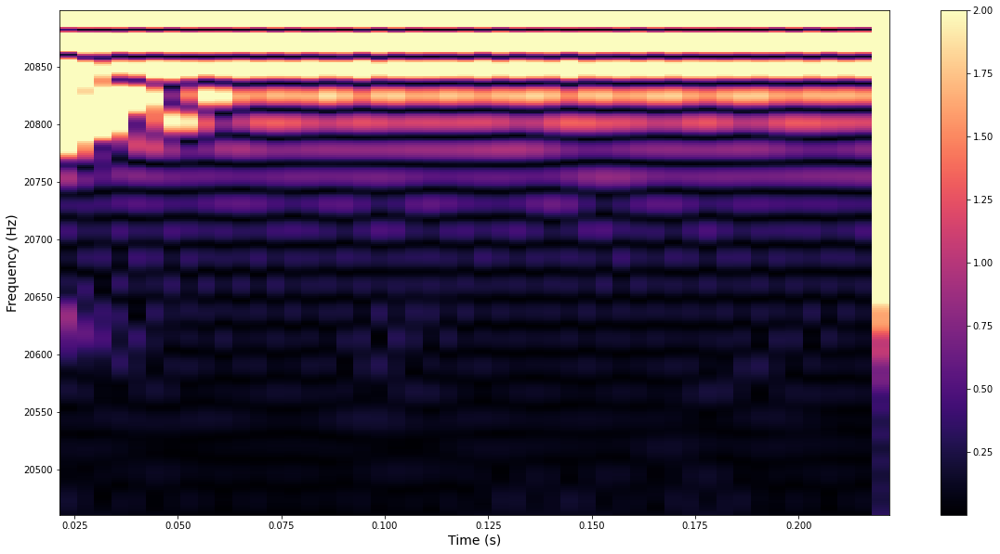

In [189]:
plot_2d_image(df_Pxx_p.loc[df_Pxx_p.index<20900].tail(300))

In [156]:
top = df_Pxx_p.loc[df_Pxx_p.index>21100].head(300)
bottom = df_Pxx_p.loc[df_Pxx_p.index<20900].tail(300)
project_coef = 18000.0/21000.0

In [157]:
project_coef

0.8571428571428571

In [158]:
top

,0.021333,0.025600,0.029867,0.034133,0.038400,0.042667,0.046933,0.051200,0.055467,0.059733,...,0.183467,0.187733,0.192000,0.196267,0.200533,0.204800,0.209067,0.213333,0.217600,0.221867
21101.074219,6.126495,8.147433,7.143275,7.383009,7.792837,7.447807,7.531584,8.053937,7.410167,7.875744,...,7.630754,7.360185,7.658594,7.690506,7.603867,7.021482,8.887232,6.088969,8.553129,8.288101
21102.539062,6.707530,8.599987,7.662336,7.924830,8.254633,7.984979,8.011074,8.545316,7.912010,8.371771,...,8.059032,7.948993,8.136325,8.158765,8.179956,7.445797,9.440663,6.546441,9.125426,9.350122
21104.003906,6.964672,8.702037,7.840364,8.120238,8.365187,8.174298,8.137481,8.683869,8.061920,8.511863,...,8.141160,8.188812,8.259526,8.282711,8.406033,7.524528,9.648918,6.655059,9.353903,10.084923
21105.468750,6.921135,8.476990,7.699789,7.992758,8.148927,8.039916,7.935407,8.494404,7.885032,8.321204,...,7.901501,8.103467,8.052295,8.086860,8.304763,7.279904,9.535615,6.439271,9.262352,10.467017
21106.933594,6.609684,7.957785,7.272734,7.575449,7.639804,7.615555,7.439188,8.011297,7.416013,7.834564,...,7.374602,7.726455,7.548367,7.605217,7.908582,6.744636,9.133971,5.933598,8.884288,10.498578
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21533.203125,0.333488,0.295672,0.394018,0.452100,0.397942,0.398770,0.320579,0.226292,0.299982,0.253839,...,0.093652,0.111522,0.101760,0.220614,0.227731,0.161151,0.223700,0.256649,0.215794,0.294084
21534.667969,0.340461,0.327592,0.413825,0.467247,0.428205,0.420282,0.341634,0.259223,0.310271,0.265399,...,0.095139,0.115031,0.115691,0.220536,0.231166,0.177340,0.222441,0.244651,0.214780,0.298657
21536.132812,0.345789,0.358717,0.432843,0.481258,0.459034,0.440772,0.363212,0.292529,0.318646,0.276946,...,0.096401,0.117222,0.132007,0.220315,0.234168,0.193994,0.219671,0.229880,0.212671,0.303712
21537.597656,0.349649,0.388485,0.450872,0.494133,0.489892,0.460240,0.385250,0.325622,0.325263,0.288382,...,0.097870,0.118259,0.149873,0.220400,0.237002,0.210696,0.215528,0.212772,0.209408,0.309106


In [159]:
proj_times = []
for index, row in bottom.iterrows():
    proj_times.append(index*project_coef)

In [160]:
proj_times

[17537.946428571428,
 17539.20200892857,
 17540.457589285714,
 17541.713169642855,
 17542.96875,
 17544.22433035714,
 17545.479910714286,
 17546.735491071428,
 17547.99107142857,
 17549.246651785714,
 17550.502232142855,
 17551.7578125,
 17553.01339285714,
 17554.268973214286,
 17555.524553571428,
 17556.78013392857,
 17558.035714285714,
 17559.291294642855,
 17560.546875,
 17561.80245535714,
 17563.058035714286,
 17564.313616071428,
 17565.56919642857,
 17566.824776785714,
 17568.080357142855,
 17569.3359375,
 17570.59151785714,
 17571.847098214286,
 17573.102678571428,
 17574.35825892857,
 17575.613839285714,
 17576.869419642855,
 17578.125,
 17579.38058035714,
 17580.636160714286,
 17581.891741071428,
 17583.14732142857,
 17584.402901785714,
 17585.658482142855,
 17586.9140625,
 17588.16964285714,
 17589.425223214286,
 17590.680803571428,
 17591.93638392857,
 17593.191964285714,
 17594.447544642855,
 17595.703125,
 17596.95870535714,
 17598.214285714286,
 17599.469866071428,
 17600.

In [161]:
df_Pxx_p.loc[df_Pxx_p.index>18086].head(1000)

,0.021333,0.025600,0.029867,0.034133,0.038400,0.042667,0.046933,0.051200,0.055467,0.059733,...,0.183467,0.187733,0.192000,0.196267,0.200533,0.204800,0.209067,0.213333,0.217600,0.221867
18086.425781,0.001043,0.003260,0.003876,0.003526,0.001958,0.000782,0.001540,0.002200,0.004861,0.005721,...,0.003736,0.001608,0.004612,0.008715,0.011345,0.012389,0.010942,0.009240,0.007065,0.005887
18087.890625,0.001665,0.003404,0.003929,0.003568,0.002087,0.000795,0.001416,0.002226,0.004785,0.005695,...,0.003685,0.002112,0.004851,0.008618,0.011075,0.011942,0.010574,0.008821,0.006692,0.005676
18089.355469,0.002281,0.003575,0.004015,0.003649,0.002212,0.000793,0.001284,0.002309,0.004713,0.005660,...,0.003644,0.002594,0.005093,0.008535,0.010800,0.011482,0.010206,0.008372,0.006278,0.005442
18090.820312,0.002880,0.003765,0.004133,0.003769,0.002334,0.000782,0.001157,0.002442,0.004650,0.005615,...,0.003606,0.003046,0.005321,0.008460,0.010516,0.011012,0.009840,0.007897,0.005829,0.005187
18092.285156,0.003453,0.003968,0.004282,0.003927,0.002453,0.000775,0.001063,0.002614,0.004596,0.005560,...,0.003569,0.003466,0.005523,0.008387,0.010225,0.010538,0.009478,0.007405,0.005349,0.004916
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19543.945312,0.011936,0.011258,0.007518,0.005506,0.009090,0.009907,0.006590,0.005156,0.010486,0.014975,...,0.023439,0.020253,0.016277,0.012973,0.012579,0.014149,0.018518,0.023889,0.027294,0.028817
19545.410156,0.011216,0.010310,0.007075,0.005312,0.008969,0.009813,0.006503,0.004172,0.009341,0.014880,...,0.023563,0.019871,0.015805,0.013355,0.013593,0.014999,0.018622,0.022993,0.026136,0.028611
19546.875000,0.010635,0.009434,0.006535,0.005081,0.008795,0.009703,0.006460,0.003212,0.008292,0.014840,...,0.023609,0.019482,0.015267,0.013624,0.014550,0.015869,0.018704,0.021959,0.024818,0.028342
19548.339844,0.010188,0.008671,0.005897,0.004807,0.008595,0.009584,0.006448,0.002327,0.007422,0.014869,...,0.023562,0.019093,0.014678,0.013790,0.015426,0.016720,0.018757,0.020812,0.023368,0.028004


In [162]:
d18_top = []
for index, row in top.iterrows():
    d18_top.append(list(row*project_coef))

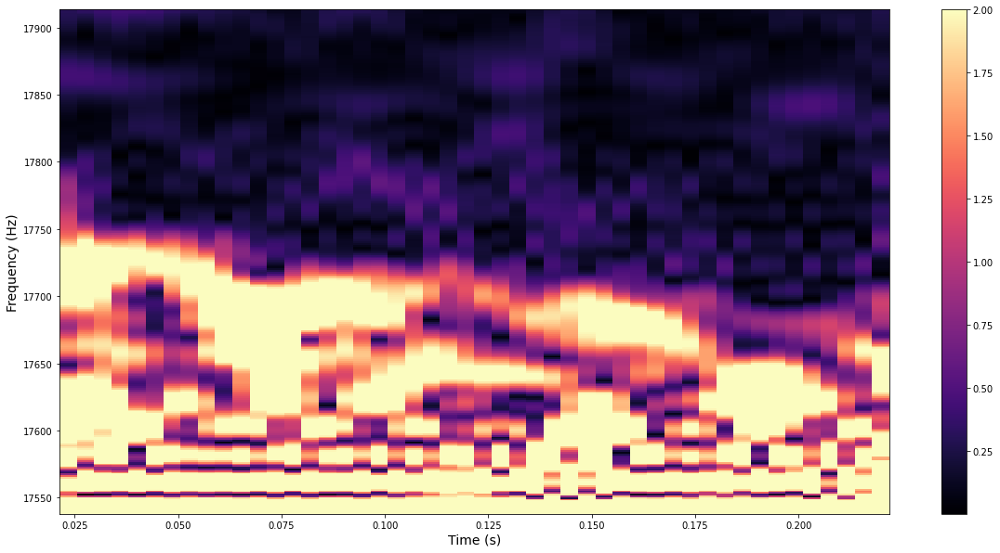

In [163]:
plot_2d_image(pd.DataFrame(d18_top, index = proj_times, columns = df_Pxx_p.columns))

In [164]:
d18_bottom = []
for index, row in bottom.iterrows():
    d18_bottom.append(list(row*project_coef))

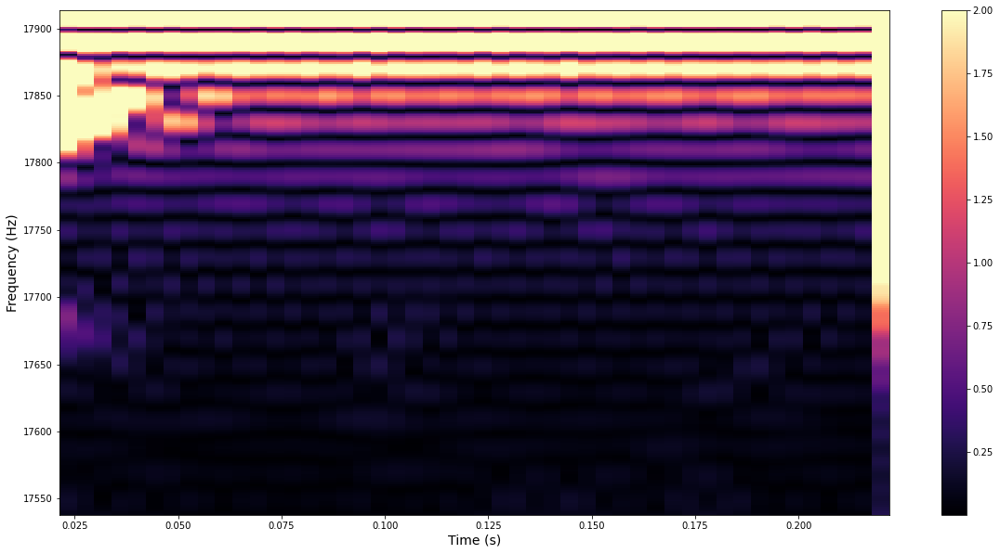

In [165]:
plot_2d_image(pd.DataFrame(d18_bottom, index = proj_times, columns = df_Pxx_p.columns))

# For sweeps

In [969]:
max_vals = df_Pxx_p.idxmax().values

In [970]:
columns = df_Pxx_p.idxmax().index

In [971]:
max_vals

array([18000., 18000., 18000., 18000., 18000., 18000., 18000., 18000.,
       18000., 18000., 18000., 18000., 18000., 18000., 18000., 18000.,
       18000., 18000., 18000., 18000., 18000., 18000., 18000., 18000.,
       18000., 18000., 18000., 18000., 18000., 18000., 18000., 18000.,
       18000., 18000., 18000., 18000., 18000., 18000., 18000., 18000.,
       18000., 18000., 18000., 18000., 18000.])

In [972]:
columns

Float64Index([0.021333333333333333, 0.025599999999999998, 0.029866666666666666,
               0.03413333333333333,               0.0384, 0.042666666666666665,
               0.04693333333333333,  0.05119999999999999,  0.05546666666666666,
               0.05973333333333333,  0.06399999999999999,  0.06826666666666666,
               0.07253333333333332,               0.0768,  0.08106666666666665,
               0.08533333333333332,  0.08959999999999999,  0.09386666666666665,
               0.09813333333333332,  0.10239999999999998,  0.10666666666666665,
               0.11093333333333331,  0.11519999999999997,  0.11946666666666664,
                0.1237333333333333,  0.12799999999999997,  0.13226666666666664,
                0.1365333333333333,  0.14079999999999998,  0.14506666666666665,
                0.1493333333333333,  0.15359999999999996,  0.15786666666666663,
                0.1621333333333333,  0.16639999999999996,  0.17066666666666663,
               0.17493333333333333,  0.1

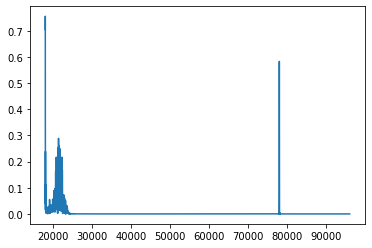

In [973]:
plt.plot(df_Pxx_p[columns[0]].loc[df_Pxx_p[columns[0]].index > (max_vals[0]+100)])

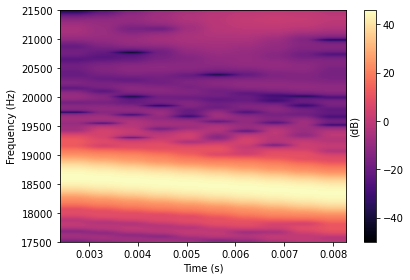

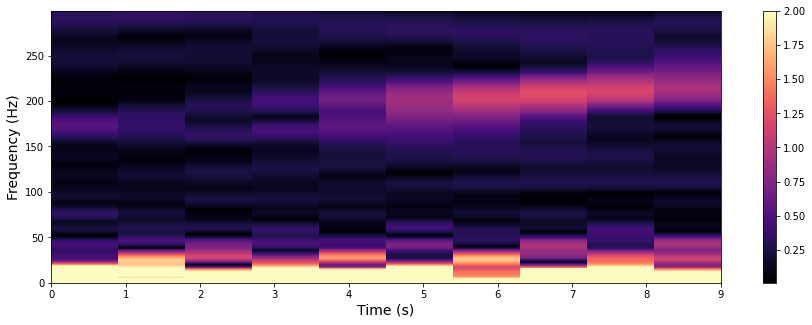

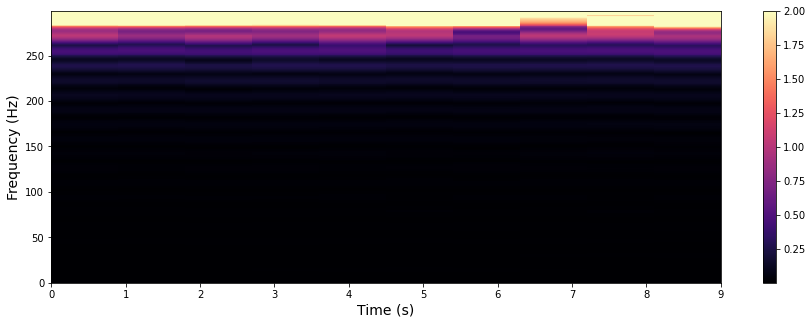

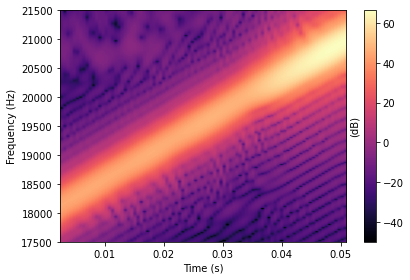

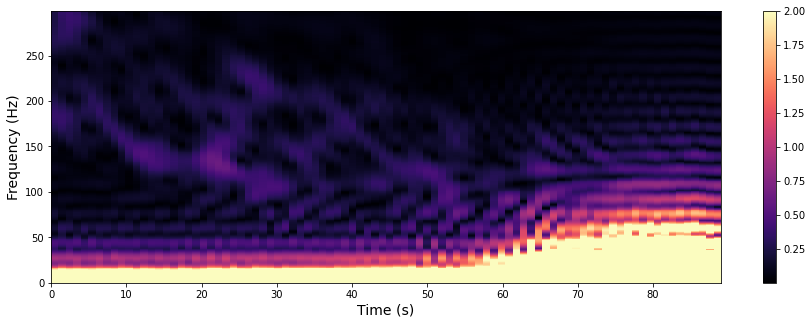

...

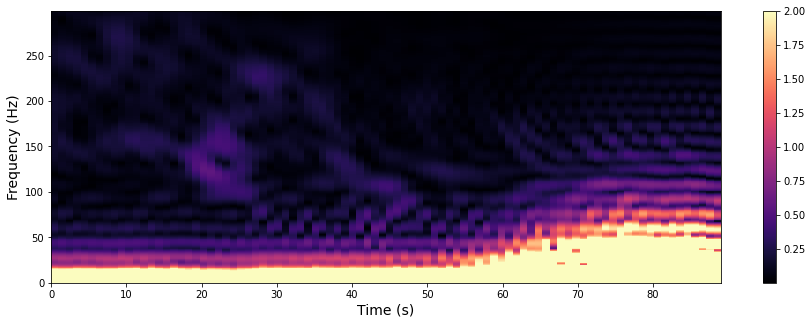

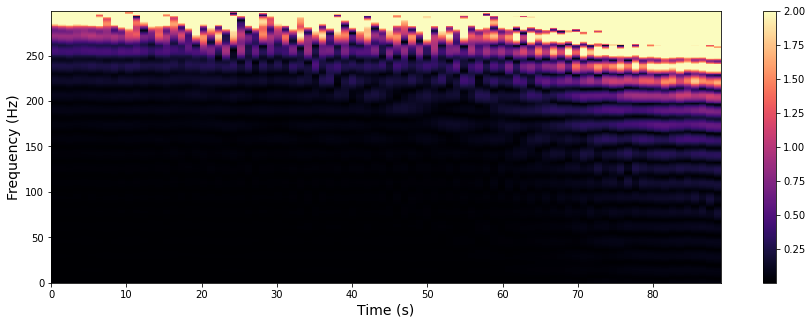

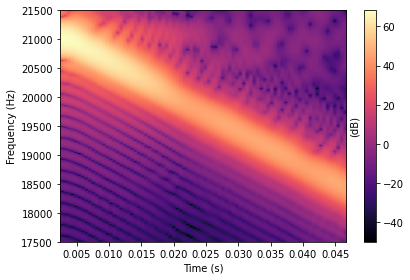

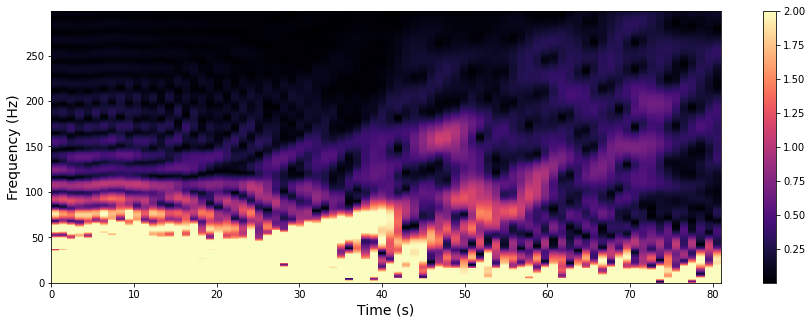

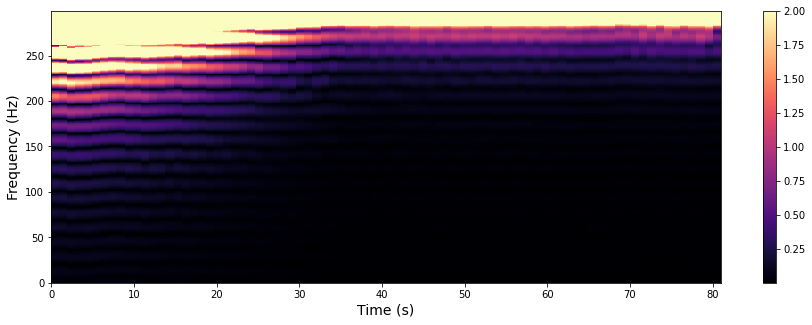

38801

In [1029]:
inverse_coef = 410
n=0
for y in sweep:
    Pxx_p,freqs_p,times_p = visualize_spec(selected_data[y[0]*inverse_coef+int(4096*0.4):y[-1]*inverse_coef+int(4096*0.6)],1024,17500,21500,100,"sweep",n)
    df_Pxx_p = pd.DataFrame(Pxx_p, index=freqs_p, columns=times_p[:-1])
    
    max_vals = df_Pxx_p.idxmax().values
    columns = df_Pxx_p.idxmax().index
    
    top = []
    bottom = []
    top_c = []
    bottom_c = []
    for x in range(len(max_vals)):
        t = df_Pxx_p[columns[x]].loc[df_Pxx_p[columns[x]].index > (max_vals[x]+500)].head(300)
        top.append(t)
        top_c.append(t.values)
        #top_index = t.index

        b = df_Pxx_p[columns[x]].loc[df_Pxx_p[columns[x]].index < (max_vals[x]-500)].tail(300)
        bottom.append(b)
        bottom_c.append(b.values)
        #bottom_index = bottom.index

    #plot_2d_image(pd.DataFrame(top).T,2)
    plot_2d_image(pd.DataFrame(top_c).T,2,"sweep_top",n)
    #plot_2d_image(pd.DataFrame(bottom).T,2)
    plot_2d_image(pd.DataFrame(bottom_c).T,2,"sweep_bottom",n)
    n=n+1
gc.collect()

In [2304]:
for columns in df_Pxx_p:
    print(freqs[df_Pxx_p[columns].argmax()])
    project_coef = 18000/freqs[df_Pxx_p[columns].argmax()]
    print(project_coef)

18688.4765625
0.9631603699639442
18741.2109375
0.9604502110364234
18796.875
0.9576059850374065
18867.1875
0.9540372670807453
18940.4296875
0.9503480278422274
18999.0234375
0.9474171164225135
19051.7578125
0.9447947101337844
19104.4921875
0.9421867811685324
19168.9453125
0.9390187987161852
19239.2578125
0.9355870260392873
19306.640625
0.9323216995447648
19365.234375
0.929500756429652
19426.7578125
0.9265570803800331
19491.2109375
0.923493160980009
19555.6640625
0.9204494382022472
19620.1171875
0.9174257130058235
19684.5703125
0.91442178895669
19746.09375
0.9115727002967359
19807.6171875
0.908741310457033
19869.140625
0.9059274550280153
19933.59375
0.9029982363315696
20000.9765625
0.8999560568331625
20062.5
0.897196261682243
20126.953125
0.8943231441048035
20191.40625
0.8914683691236216
20261.71875
0.8883747831116252
20326.171875
0.8855577976362063
20390.625
0.8827586206896552
20452.1484375
0.8801031370863773
20516.6015625
0.877338283592746
20581.0546875
0.8745907473309609
20639.6484375


# Impulse response calculation

# Generate sweep signal

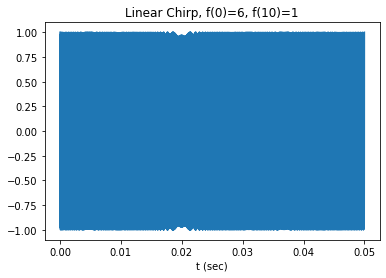

In [160]:
from scipy.signal import chirp

t = np.linspace(0, 0.05, 9600)
w = chirp(t, f0=18000, f1=21000, t1=0.05, method='linear')
plt.plot(t, w)
plt.title("Linear Chirp, f(0)=6, f(10)=1")
plt.xlabel('t (sec)')
plt.show()

In [161]:
t

array([0.00000000e+00, 5.20887592e-06, 1.04177518e-05, ...,
       4.99895822e-02, 4.99947911e-02, 5.00000000e-02])

In [162]:
visualize_spec(w,8192,17500,18500)

TypeError: visualize_spec() missing 1 required positional argument: 'dynamicRange'

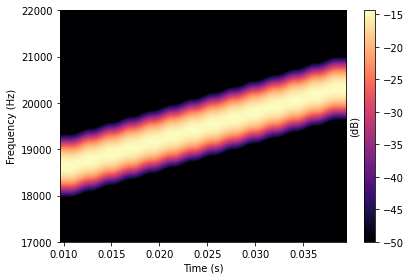

(array([[1.29353409e-09, 6.65782373e-11, 1.03922228e-09, ...,
         3.36603987e-10, 1.08598992e-09, 1.53252392e-09],
        [1.29409952e-09, 4.96347726e-10, 1.04744889e-09, ...,
         5.11973484e-10, 1.08704570e-09, 1.54001312e-09],
        [1.29562805e-09, 9.67279502e-10, 1.07058640e-09, ...,
         8.28091896e-10, 1.09010549e-09, 1.56118777e-09],
        ...,
        [1.46975289e-11, 2.38099892e-11, 1.11724891e-11, ...,
         2.44022840e-11, 1.75838746e-11, 2.12590990e-11],
        [1.46925631e-11, 2.52576467e-11, 1.14199749e-11, ...,
         2.58976953e-11, 1.76373825e-11, 2.15819475e-11],
        [1.46907221e-11, 2.57467625e-11, 1.15057006e-11, ...,
         2.64026335e-11, 1.76562427e-11, 2.16942644e-11]]),
 array([0.00000000e+00, 2.92968750e+00, 5.85937500e+00, ...,
        9.59941406e+04, 9.59970703e+04, 9.60000000e+04]),
 array([0.01066667, 0.0128    , 0.01493333, 0.01706667, 0.0192    ,
        0.02133333, 0.02346667, 0.0256    , 0.02773333, 0.02986667,
        0.

In [163]:
visualize_fft(w)

In [164]:
from scipy.signal import chirp

def generate_sweep():
#     if samplerate == 96000:
#         t = np.linspace(0, 0.1, 9600)
#     if samplerate == 48000:
#         t = np.linspace(0, 1, 4800)    
#     if samplerate == 44100:
#         t = np.linspace(0, 1, 4410)
        
#     #t = np.linspace(0, 1, 9600)
#     generated_sweep = chirp(t=t, f0=18000, t1=1, f1=21000, method='linear')   
    x = 0
    if samplerate == 96000:
        x = 9600
    if samplerate == 192000:
        x = 19200
    
    
    f1 = 18000        # start frequency
    f2 = 21000       # end frequency
    fs = samplerate#96000      # sampling frequency
    T = 0.05          # time duration of the sweep
    t = float(x)/samplerate

    a = (f2 - f1)/float(T)

    t = np.arange(0,np.round(fs*T-1)/fs,1/fs)  # time axis
    sweep = np.sin(2*np.pi*((a*t**2)/2 + (f1*t)))
    #s = np.sin(2*np.pi*f1*np.exp(t)) 
    return sweep

In [165]:
from scipy.signal import hilbert
def calc_envelop(cut):
    analytic_signal = hilbert(cut)
    amplitude_envelop = np.abs(analytic_signal)
    return amplitude_envelop

In [166]:
from scipy.stats import linregress
def determine_gradient(data):
    return linregress(np.arange(len(data)),data).slope

ValueError: only 1-dimensional arrays can be used

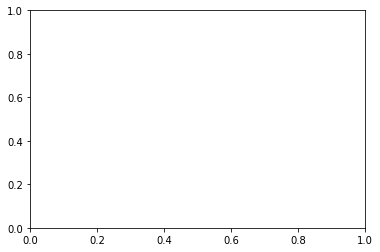

In [167]:
visualize_spec(data,8192,19000,21000,100)

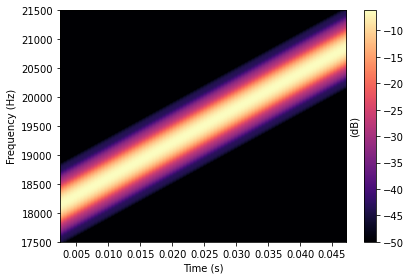

In [169]:
r,_,_ = visualize_spec(w,1024,17500,21500,100)

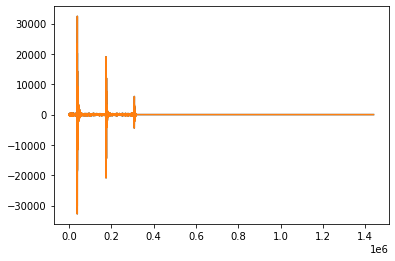

In [170]:
plt.plot(data)

In [1520]:
approx_sig

[[2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.4944382578492936,
  2.494438

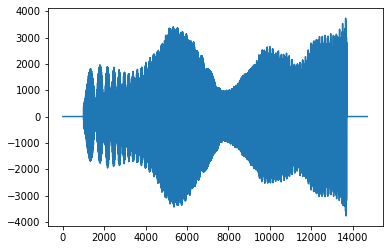

*** Sweep ***


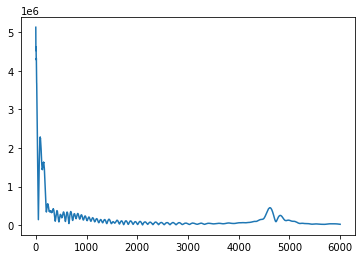

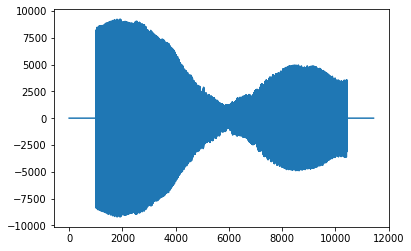

*** Inverse sweep ***


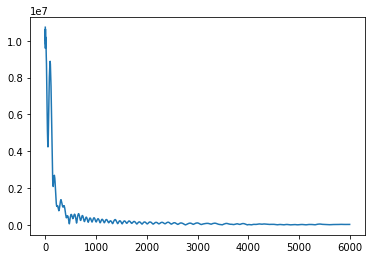

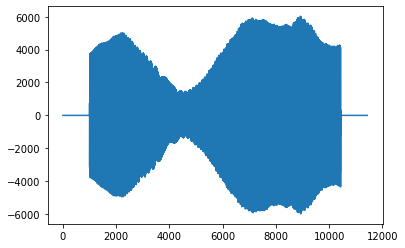

*** Sweep ***


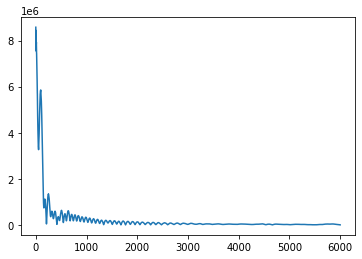

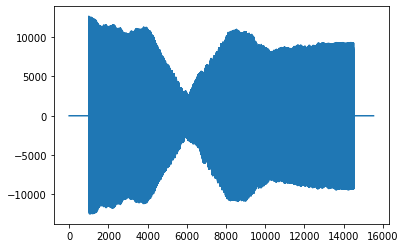

*** Inverse sweep ***


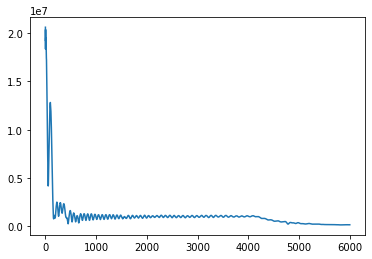

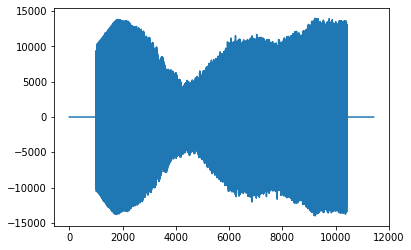

*** Sweep ***


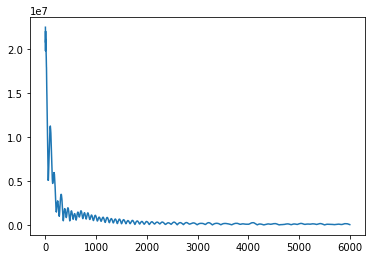

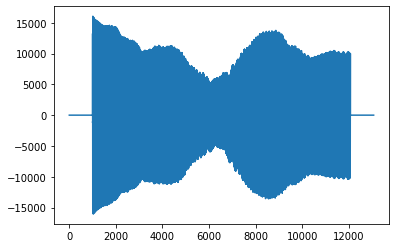

*** Inverse sweep ***


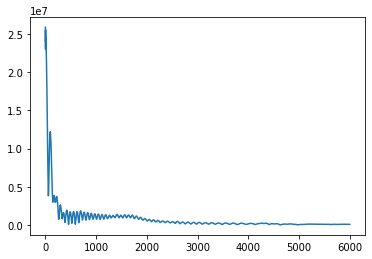

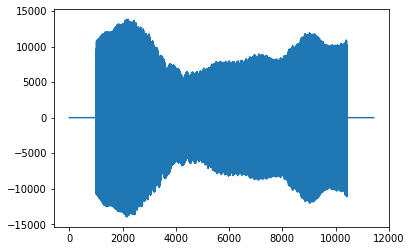

*** Sweep ***


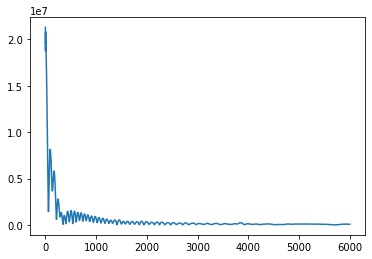

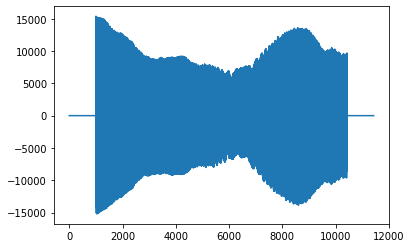

*** Inverse sweep ***


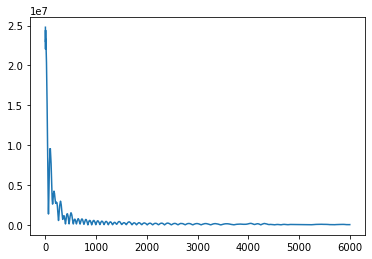

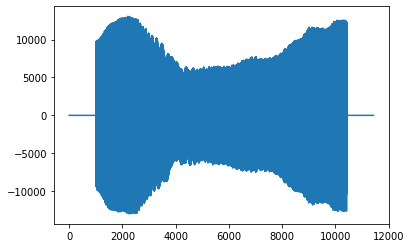

*** Sweep ***


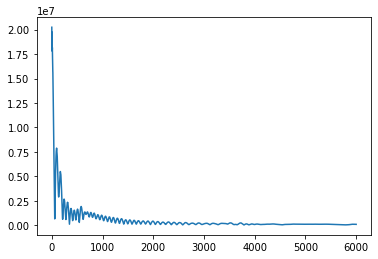

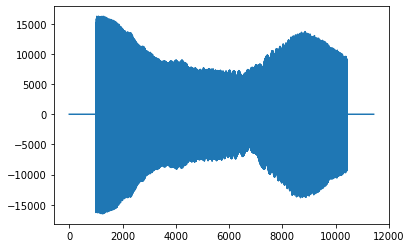

*** Inverse sweep ***


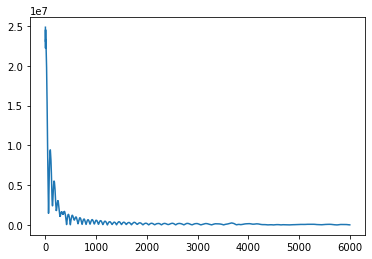

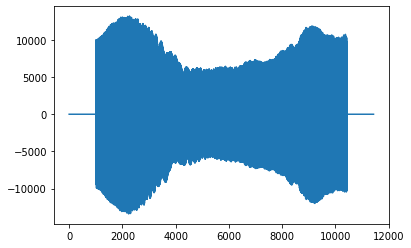

*** Sweep ***


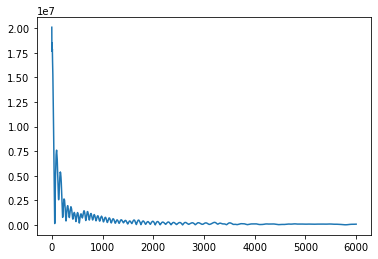

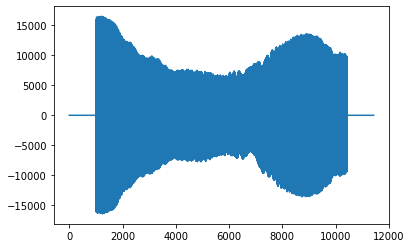

*** Inverse sweep ***


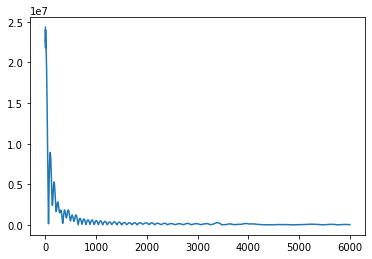

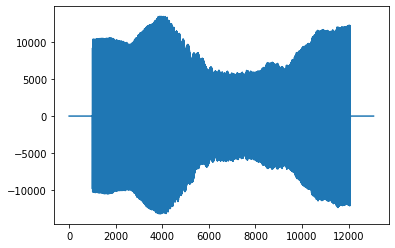

*** Sweep ***


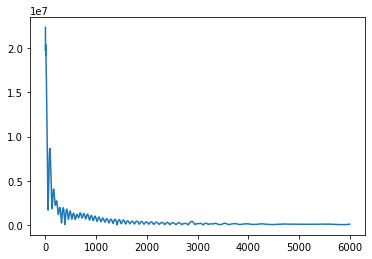

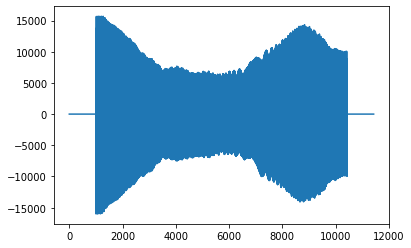

*** Inverse sweep ***


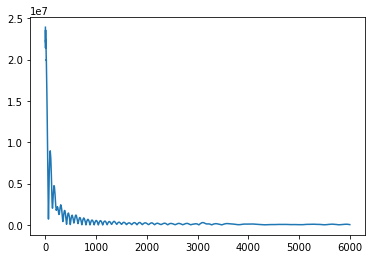

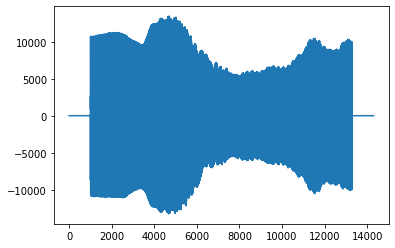

*** Sweep ***


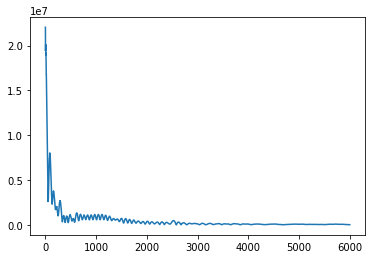

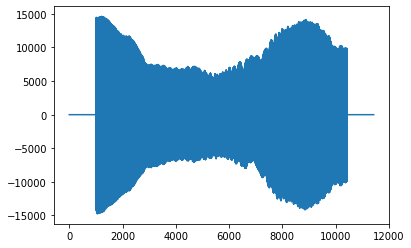

*** Inverse sweep ***


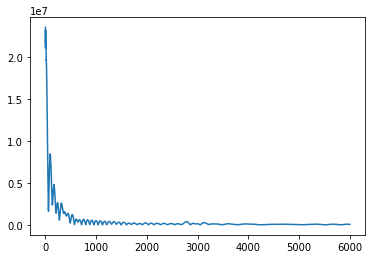

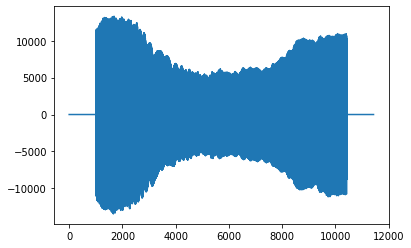

*** Sweep ***


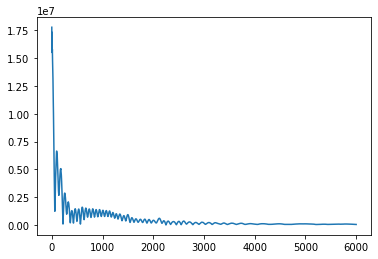

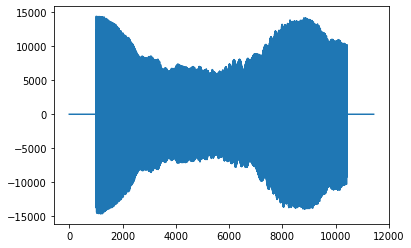

*** Inverse sweep ***


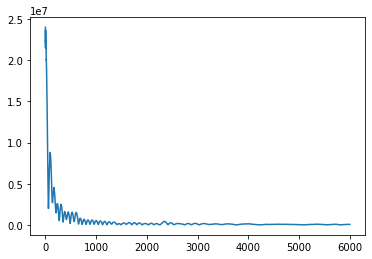

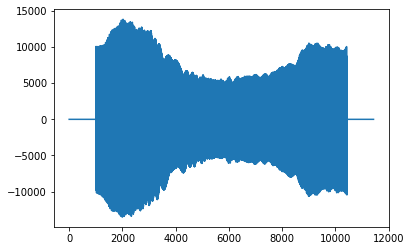

*** Sweep ***


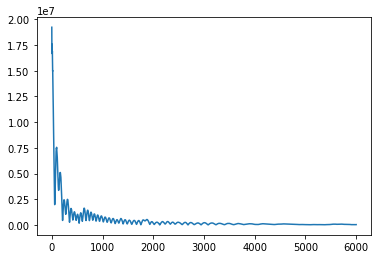

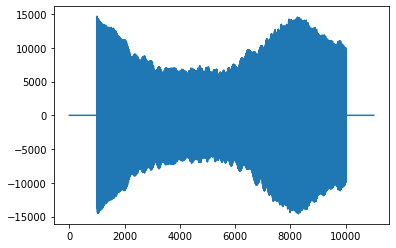

*** Inverse sweep ***


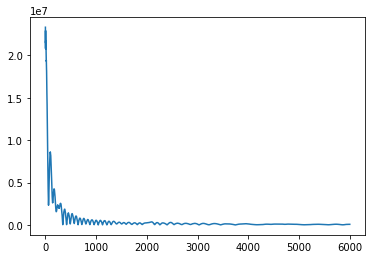

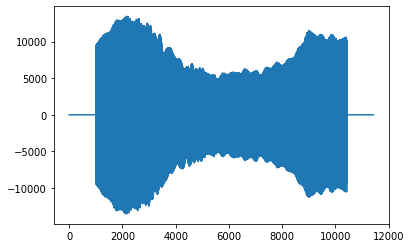

*** Sweep ***


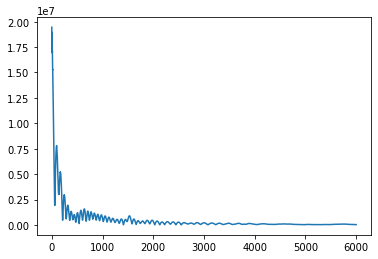

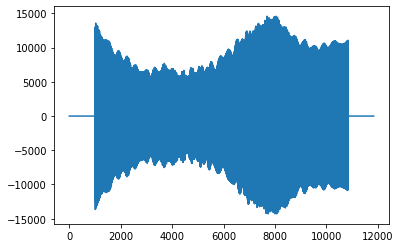

*** Inverse sweep ***


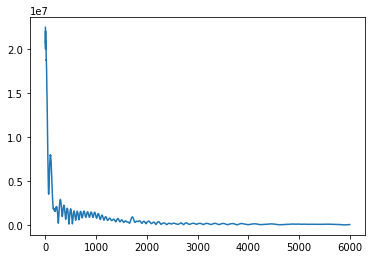

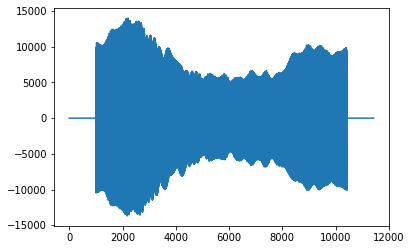

*** Sweep ***


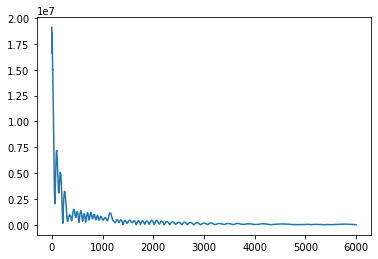

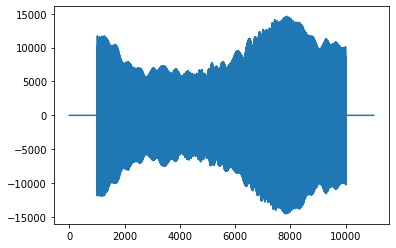

*** Inverse sweep ***


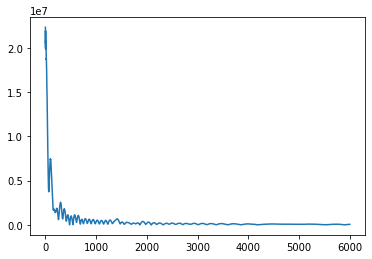

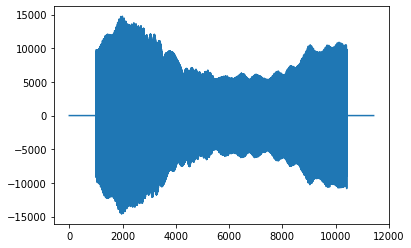

*** Sweep ***


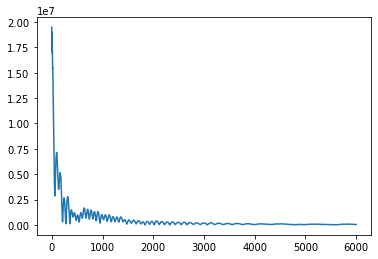

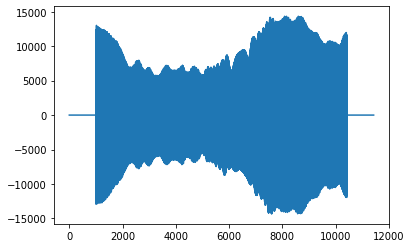

*** Inverse sweep ***


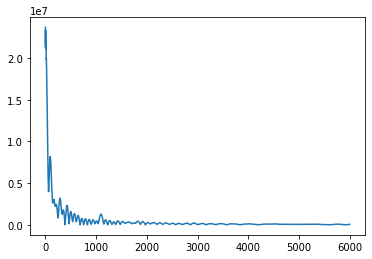

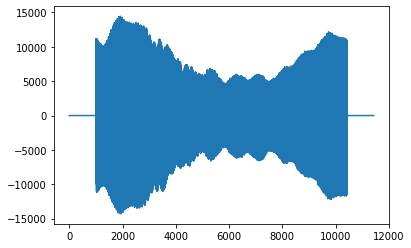

*** Sweep ***


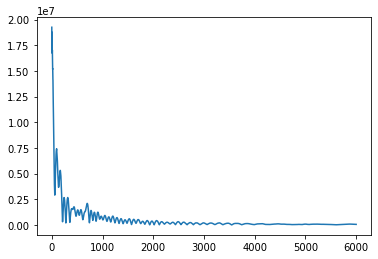

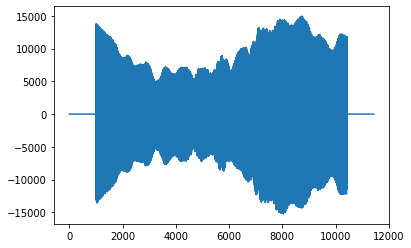

*** Inverse sweep ***


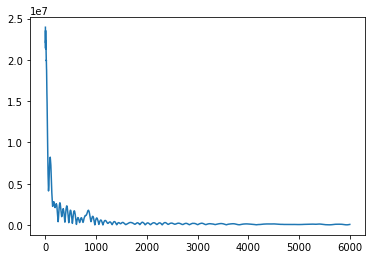

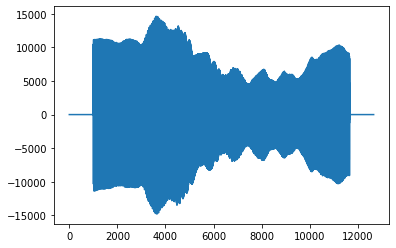

*** Sweep ***


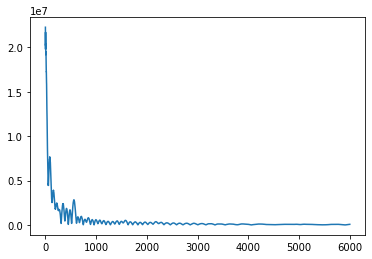

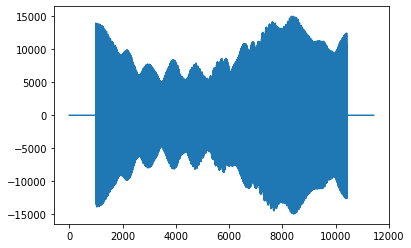

*** Inverse sweep ***


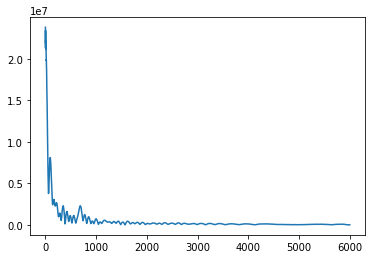

7991

In [232]:
generated_sweep = generate_sweep()
corr = []
corr_raw = []
n=0
name="sweep_IRs_"

#Change data to either data_left or data_right
#selected_data = data_right[int(3.3*192000):int(12.5*192000)]

for y in sweep:
    try:
        data = selected_data[(y[0])*inverse_coef+int(4096*0.6):(y[-1])*inverse_coef+int(4096*0.6)]
    except:
        data = selected_data[(y[0])*inverse_coef+int(4096*0.4):(y[-1])*inverse_coef+int(4096*0.6)]
        
    data = np.pad(data,(1000,1000),'constant')
    plt.plot(data)
    plt.show()
    #data = normalize_data(data)
    estimated_sig= approx_sig[y[0]:y[-1]]
    gradient = determine_gradient(estimated_sig)
    #_,_,_ = visualize_fft(data)
    if gradient>0:
        print("*** Sweep ***")
        #_,_,_ = visualize_spec(data,1024,17500,21500)
        conv = np.convolve(data,generated_sweep[::-1],'full')
    elif gradient<0:
        print("*** Inverse sweep ***")
        #_,_,_ = visualize_spec(data[::-1],1024,17500,21500)
        conv = np.convolve(data,generated_sweep,'full')
    conv_cut = conv[conv.argmax():]
    envelop = calc_envelop(conv_cut)
    plt.plot(envelop[:6000])
    #plt.savefig("visual/20211021/us_bicycle_approaching/" + name +str(n)+".png")
    plt.show()
    #envelop2 = get_envelop(conv_cut)
    corr_raw.append(conv_cut)
    corr.append(envelop)
    n=n+1
gc.collect()

In [233]:
nc_raw = []
nc = []
for i in corr_raw:
    nc_raw.append(i[:6000]/max(i[:6000]))
for i in corr:
    nc.append(i[:6000]/max(i[:6000]))

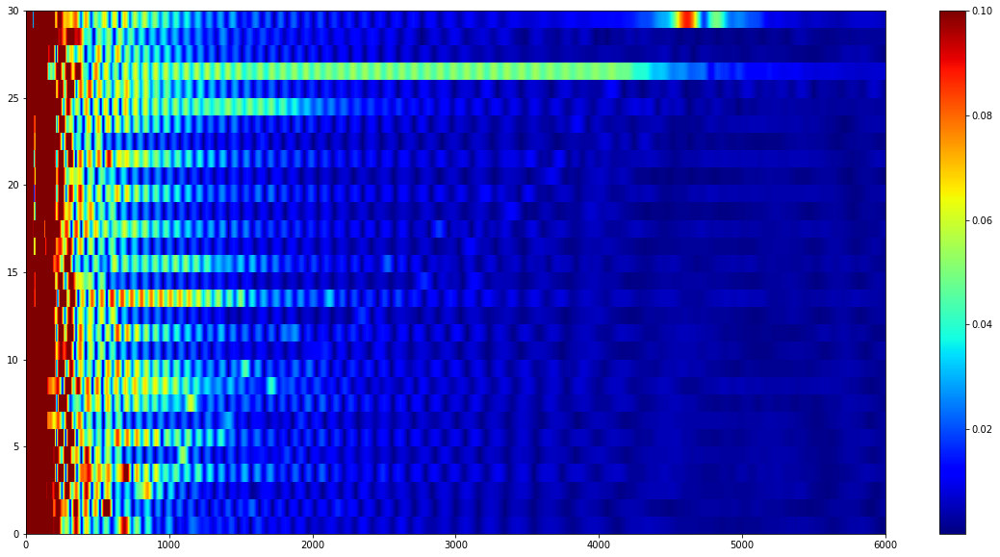

In [234]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc), vmax=0.1,cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

In [1195]:
#XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

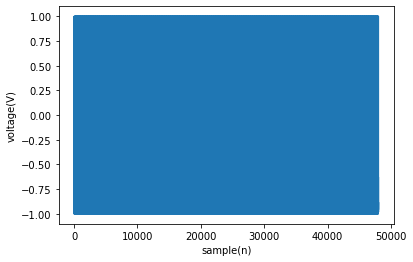

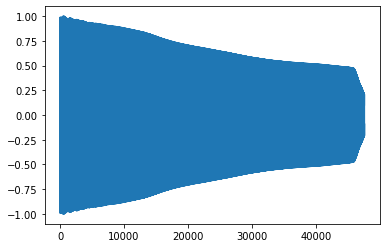

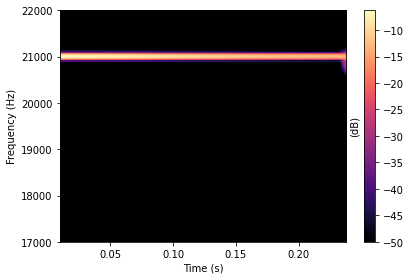

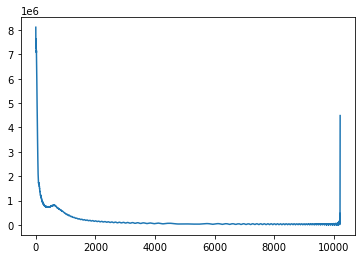

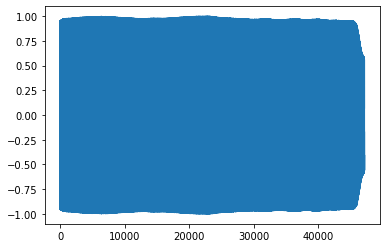

...

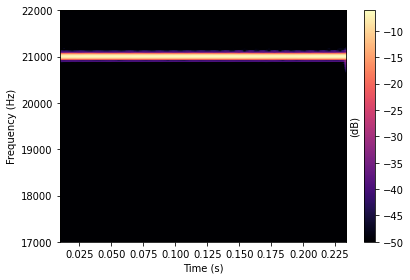

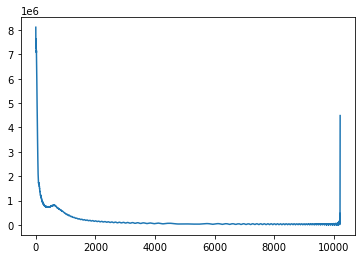

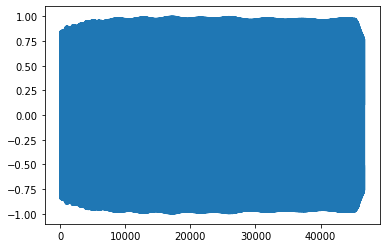

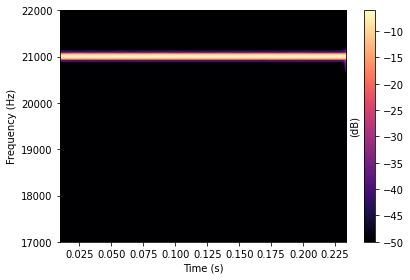

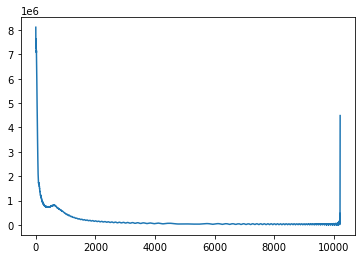

2809

In [1219]:
generated_sweep = generate_sine()
corr = []
corr_raw = []
n=0
name="sweep_IRs_"
for y in sine21:
    try:
        data = selected_data[(y[0])*inverse_coef+int(4096*0.9):(y[-1])*inverse_coef+int(4096*0.9)]
    except:
        data = selected_data[(y[0])*inverse_coef+int(4096*0.9):(y[-1])*inverse_coef+int(4096*0.9)]
    data = normalize_data(data)
    plt.plot(data)
    plt.show()
    visualize_fft(data)
    estimated_sig= approx_sig[y[0]:y[-1]]
    gradient = determine_gradient(estimated_sig)
    #_,_,_ = visualize_fft(data)
    if gradient>0:
        print("*** Sweep ***")
        #_,_,_ = visualize_spec(data,1024,17500,21500)
        conv = np.convolve(data,generated_sweep[::-1],'full')
    elif gradient<0:
        print("*** Inverse sweep ***")
        #_,_,_ = visualize_spec(data[::-1],1024,17500,21500)
        conv = np.convolve(data[::-1],generated_sweep[::-1],'full')
    conv_cut = conv[conv.argmax():]
    envelop = calc_envelop(conv_cut)
    plt.plot(envelop)
    #plt.savefig("visual/20211021/us_bicycle_approaching/" + name +str(n)+".png")
    plt.show()
    #envelop2 = get_envelop(conv_cut)
    corr_raw.append(conv_cut)
    corr.append(envelop)
    n=n+1
gc.collect()

In [1201]:
time = np.arange(0, 0.25, 1/48000);
# Amplitude of the sine wave is sine of a variable like time

amplitude   = np.sin(time)

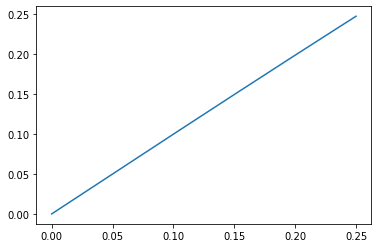

In [1202]:
plt.plot(time,amplitude)

In [1212]:
def generate_sine():
    Fs = 192000
    f = 21000
    sample = 192000*0.25
    x = np.arange(sample)
    y = np.sin(2 * np.pi * f * x / Fs)
    plt.plot(x, y)
    plt.xlabel('sample(n)')
    plt.ylabel('voltage(V)')
    plt.show()
    return y

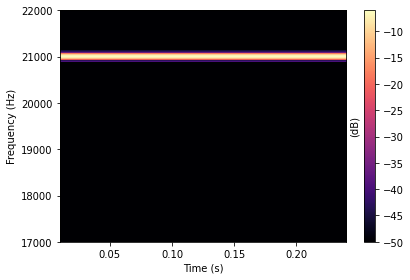

(array([[4.01691023e-10, 1.15661878e-09, 8.83473846e-10, ...,
         2.89719019e-10, 8.00735320e-10, 1.17944767e-09],
        [7.28258851e-10, 1.14562410e-09, 9.70563237e-10, ...,
         6.92020347e-10, 9.21603290e-10, 1.16099510e-09],
        [1.25743000e-09, 1.11367538e-09, 1.18394586e-09, ...,
         1.26631830e-09, 1.20087707e-09, 1.10671755e-09],
        ...,
        [4.75827456e-11, 1.42547893e-11, 3.43462003e-11, ...,
         4.89849876e-11, 3.77278820e-11, 1.04797534e-11],
        [5.04552049e-11, 1.35327336e-11, 3.60902944e-11, ...,
         5.19709190e-11, 3.97737626e-11, 8.72345583e-12],
        [5.14257656e-11, 1.32697352e-11, 3.66829955e-11, ...,
         5.29794793e-11, 4.04676099e-11, 8.01571339e-12]]),
 array([0.00000000e+00, 2.92968750e+00, 5.85937500e+00, ...,
        9.59941406e+04, 9.59970703e+04, 9.60000000e+04]),
 array([0.01066667, 0.0128    , 0.01493333, 0.01706667, 0.0192    ,
        0.02133333, 0.02346667, 0.0256    , 0.02773333, 0.02986667,
        0.

In [1211]:
visualize_fft(y)

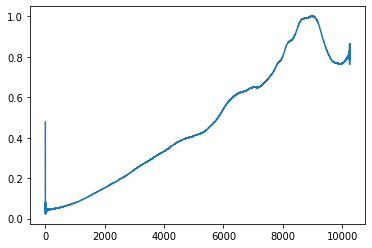

In [496]:
plt.plot(calc_envelop(normalize_data(data)))

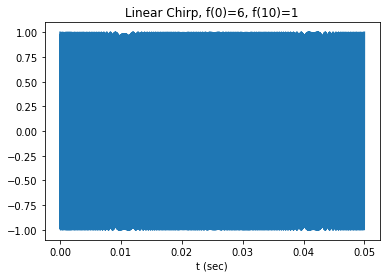

In [846]:
t = np.linspace(0, 0.05, 10249)
ww = chirp(t, f0=18000, f1=21000, t1=0.05, method='linear')
plt.plot(t, ww)
plt.title("Linear Chirp, f(0)=6, f(10)=1")
plt.xlabel('t (sec)')
plt.show()

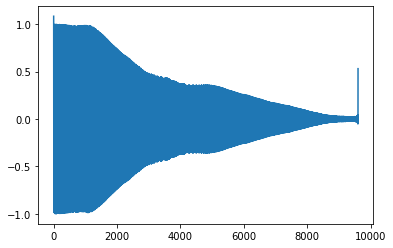

In [847]:
from scipy.signal import resample

plt.plot(resample(calc_envelop(normalize_data(data)),9600)*generated_sweep)
shaped_sweep = resample(calc_envelop(normalize_data(data)),9600)*generated_sweep

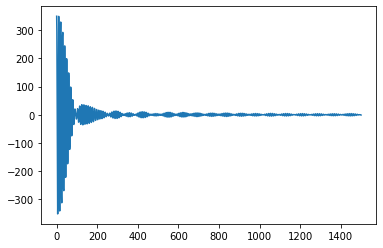

In [850]:
conv = np.convolve(normalize_data(data)[::-1],shaped_sweep[::-1],'same')
conv_cut = conv[conv.argmax():conv.argmax()+1500]
envelop = calc_envelop(conv_cut)
plt.plot(conv_cut)
plt.show()

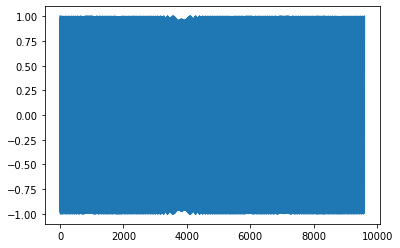

In [462]:
plt.plot(generated_sweep)

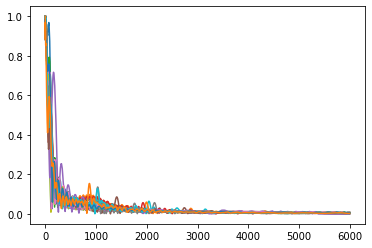

In [1353]:
for n in nc:
    plt.plot(n)

# Visualize Pxx

In [1941]:
pd_Pxx = pd.DataFrame(Pxx)
temp_times = times#[:-1]
pd_Pxx.columns = temp_times
pd_Pxx.index = freqs

In [1942]:
test_Pxx = pd_Pxx.loc[(pd_Pxx.index>17500.0) & (pd_Pxx.index<21500.0)]

In [1943]:
#norm_Pxx=(test_Pxx-test_Pxx.mean())/test_Pxx.std()

In [1944]:
#proc_Pxx = test_Pxx.loc[(test_Pxx.index>17600.0) + (test_Pxx.index<18500.0)]#

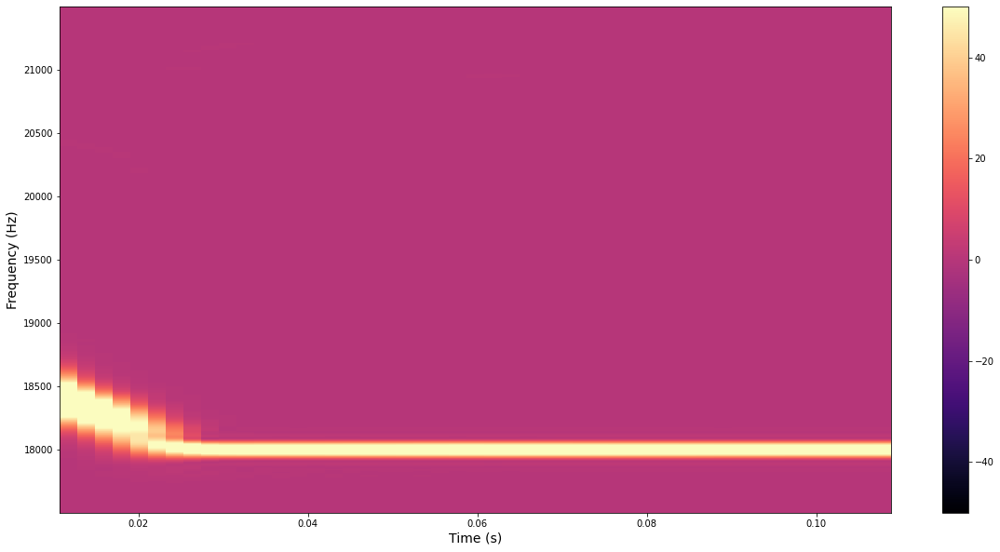

In [1954]:
proc_Pxx = test_Pxx#.loc[(test_Pxx.index>18050.0) + (test_Pxx.index<17950.0)]

plt.figure(figsize=(20,10))
#plt.xticks(cadence.columns, fontsize=9)
#plt.yticks(cadence.index.values.tolist(), fontsize=9)
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(proc_Pxx,cmap='magma',vmax=50,vmin=-50,interpolation='nearest',origin='lower',extent=[proc_Pxx.columns.values[0],proc_Pxx.columns.values[-1],proc_Pxx.index.values[0],proc_Pxx.index.values[-1]], aspect='auto')
plt.colorbar()

In [1903]:
df_pxx = pd.DataFrame(Pxx, index = freqs)

In [1904]:
diff_pxx_1 = df_pxx.loc[17500:21500].diff(axis=1)
diff_pxx_0 = df_pxx.loc[17500:21500].diff(axis=0)

#normalize
diff_pxx_1=(diff_pxx_1-diff_pxx_1.min())/(diff_pxx_1.max()-diff_pxx_1.min())
diff_pxx_0=(diff_pxx_0-diff_pxx_0.min())/(diff_pxx_0.max()-diff_pxx_0.min())

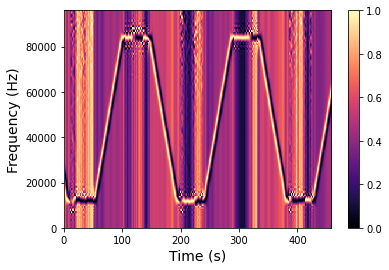

In [1771]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx_1,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

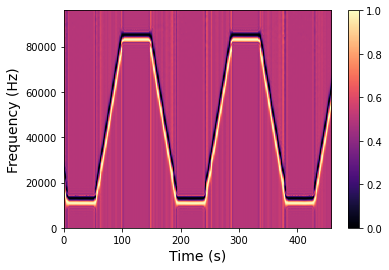

In [1772]:
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(diff_pxx_0,cmap='magma',interpolation='nearest',origin='lower',extent=[df_pxx.diff().columns.values[0],df_pxx.diff().columns.values[-1],df_pxx.diff().index.values[0],df_pxx.diff().index.values[-1]], aspect='auto')
plt.colorbar()

In [1252]:
df = diff_pxx_0.idxmax()#pd.DataFrame(Pxx).max()
normalized_df=(df-df.min())/(df.max()-df.min())

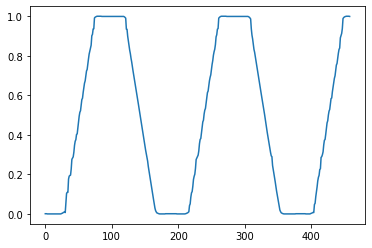

In [1254]:
plt.plot(normalized_df)

In [610]:
segments_low

array([[ 49],
       [ 50],
       [ 51],
       [ 52],
       [ 53],
       [ 54],
       [ 55],
       [ 56],
       [ 57],
       [ 58],
       [ 59],
       [ 60],
       [ 61],
       [ 62],
       [ 63],
       [ 64],
       [ 65],
       [ 66],
       [ 67],
       [ 68],
       [ 69],
       [ 70],
       [ 71],
       [ 72],
       [ 73],
       [ 74],
       [ 75],
       [ 76],
       [ 77],
       [ 78],
       [ 79],
       [ 80],
       [ 81],
       [ 82],
       [ 83],
       [ 84],
       [ 85],
       [ 86],
       [ 87],
       [ 88],
       [ 89],
       [ 90],
       [ 91],
       [ 92],
       [ 93],
       [ 94],
       [ 95],
       [ 96],
       [ 97],
       [ 98],
       [ 99],
       [100],
       [101],
       [102],
       [103],
       [104],
       [105],
       [106],
       [107],
       [108],
       [109],
       [110],
       [111],
       [112],
       [113],
       [114],
       [115],
       [116],
       [117],
       [118],
       [119],
      

In [611]:
segments_high = np.argwhere(pd.DataFrame(Pxx).max().values>2000)
segments_low = np.argwhere(pd.DataFrame(Pxx).max().values<500)

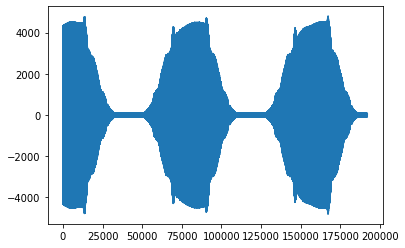

In [81]:
plt.plot(data_left[2*192000:3*192000])
#plt.plot()

In [2047]:
def extract_spectral_feat(data):
    spectrum = pd.DataFrame()
    #for index, row in imp_res.iterrows():
    signal = np.array(data)
    f = calculate_spectrum(signal)
    spectrum = pd.concat([spectrum, f],axis=0)

    #spectrum.index = data.index
    return spectrum

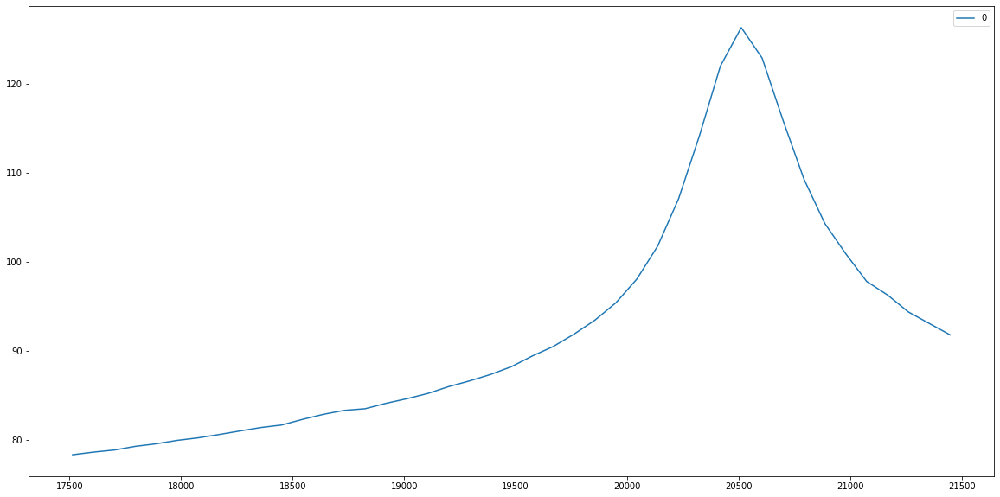

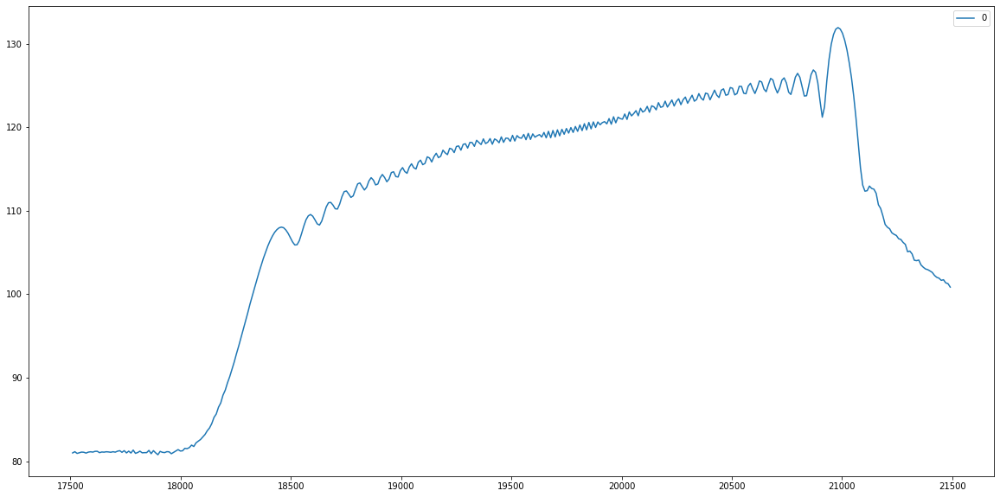

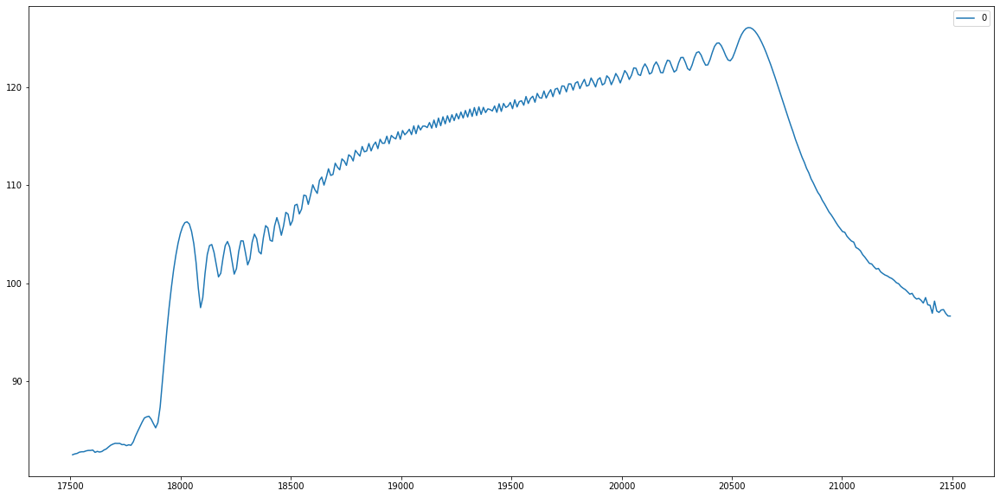

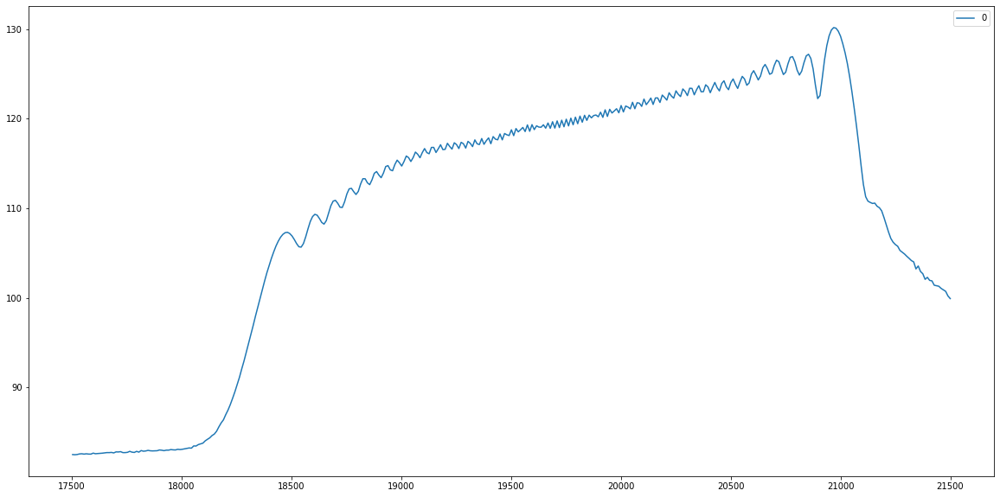

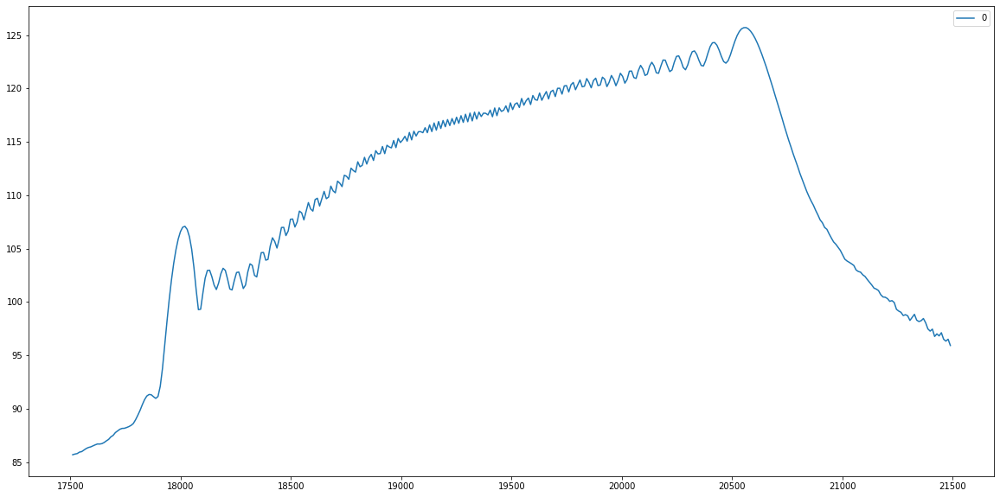

...

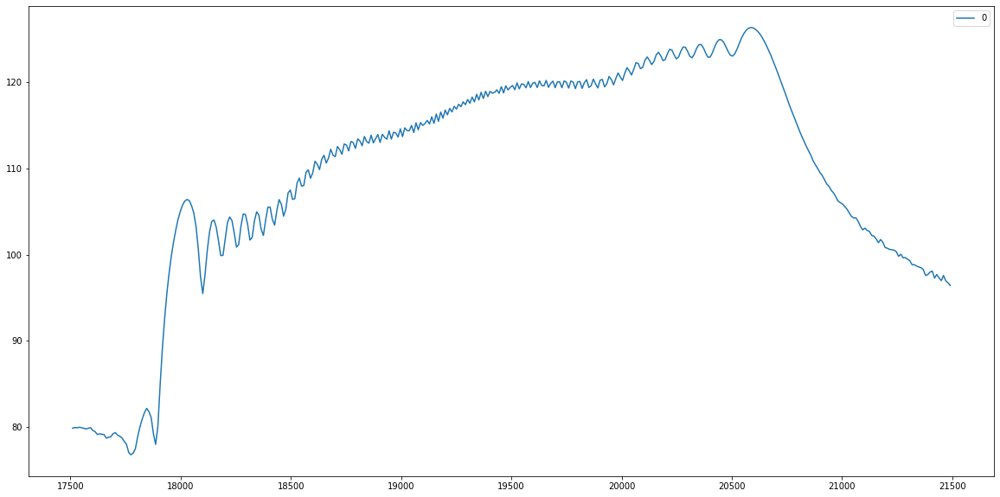

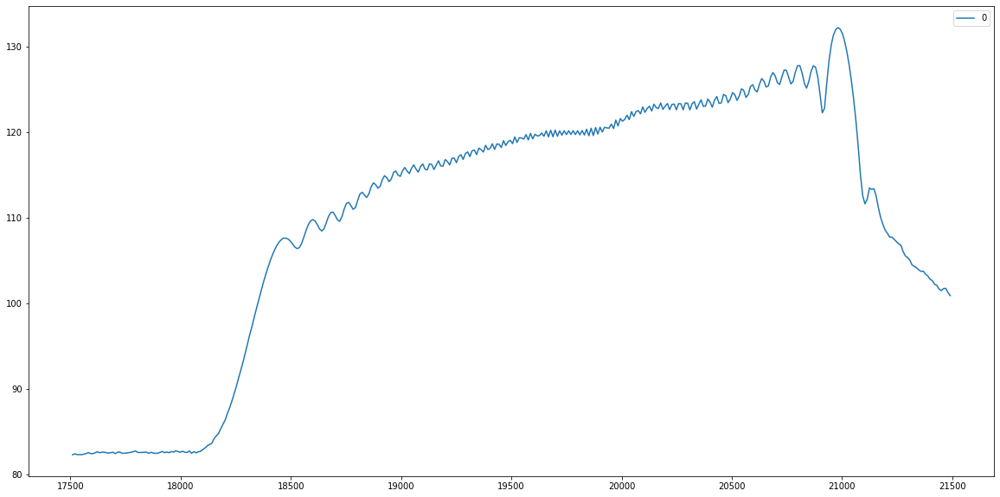

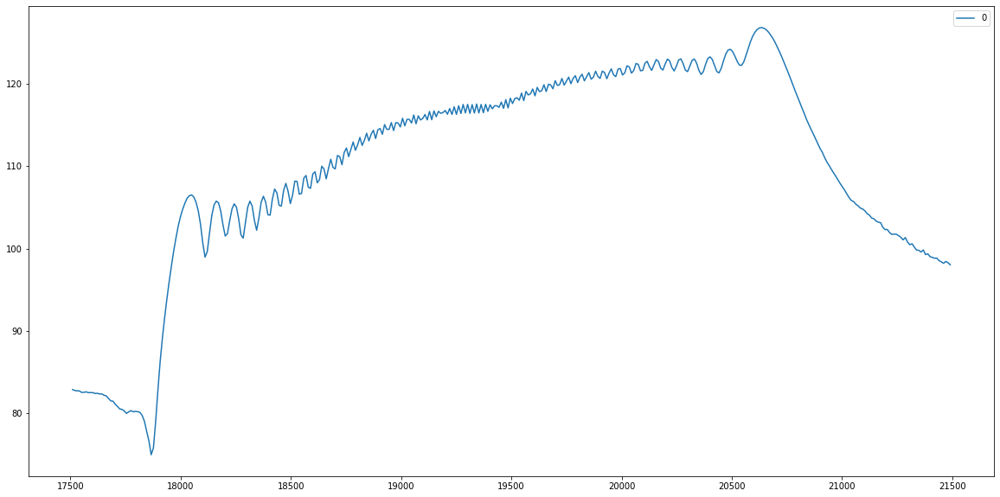

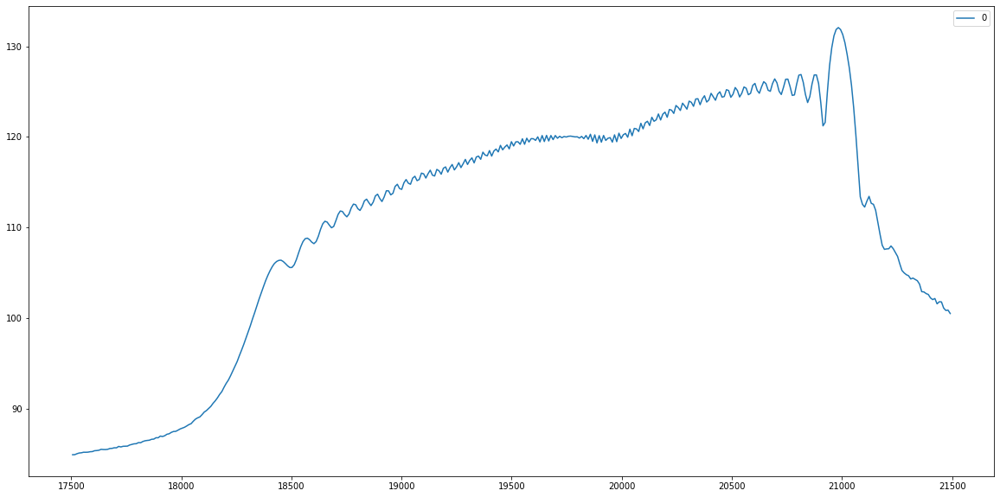

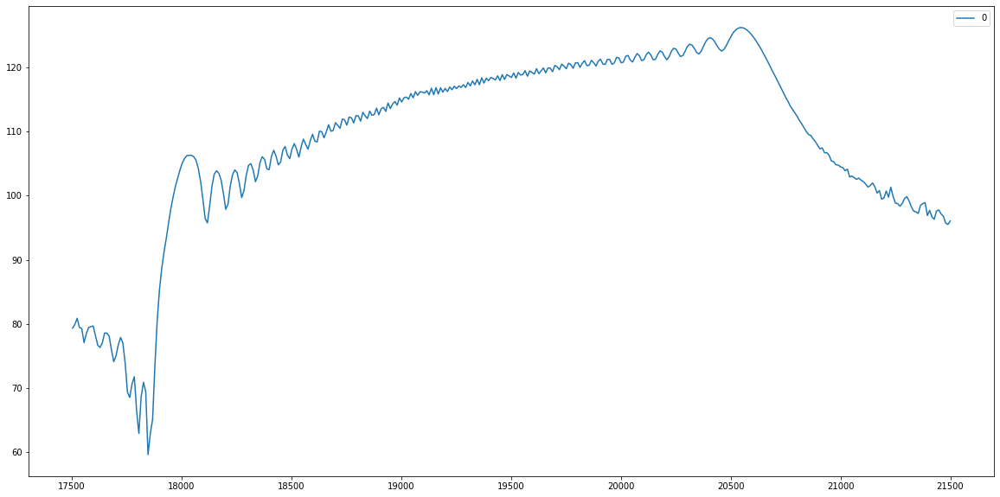

In [2052]:
for y in sweep:
    spec = extract_spectral_feat(selected_data[y[0]*inverse_coef+int(4096*0.1):y[-1]*inverse_coef+int(4096*0.1)])
    spec.T.plot(figsize=(20,10))
    plt.show()

In [516]:
gc.collect()

13

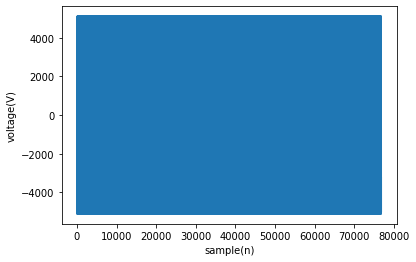

In [466]:
Fs = 192000
f = 21000
sample = 19200*4
x = np.arange(sample)
y = np.sin(2 * np.pi * f * x / Fs)
plt.plot(x, y*data_left.max())
plt.xlabel('sample(n)')
plt.ylabel('voltage(V)')
plt.show()

In [467]:
data_left.max()

5113.732231994528

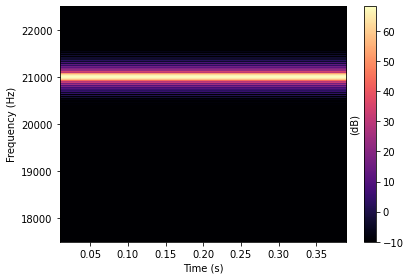

In [468]:
test,_,_ = visualize_fft(y*data_left.max())

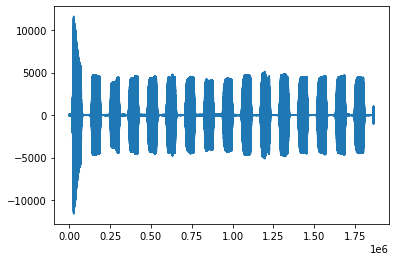

In [1215]:
plt.plot(selected_data)

In [464]:
df = pd.DataFrame(test).max()

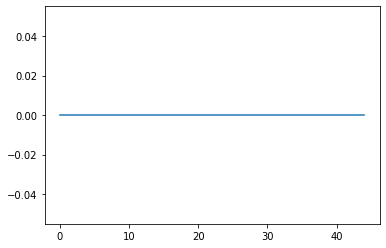

In [465]:
plt.plot(np.full(45,0))

In [326]:
np.arange(0,1,0.022222)

array([0.      , 0.022222, 0.044444, 0.066666, 0.088888, 0.11111 ,
       0.133332, 0.155554, 0.177776, 0.199998, 0.22222 , 0.244442,
       0.266664, 0.288886, 0.311108, 0.33333 , 0.355552, 0.377774,
       0.399996, 0.422218, 0.44444 , 0.466662, 0.488884, 0.511106,
       0.533328, 0.55555 , 0.577772, 0.599994, 0.622216, 0.644438,
       0.66666 , 0.688882, 0.711104, 0.733326, 0.755548, 0.77777 ,
       0.799992, 0.822214, 0.844436, 0.866658, 0.88888 , 0.911102,
       0.933324, 0.955546, 0.977768, 0.99999 ])

In [329]:
np.arange(0,1,0.022222)[::-1]

array([0.99999 , 0.977768, 0.955546, 0.933324, 0.911102, 0.88888 ,
       0.866658, 0.844436, 0.822214, 0.799992, 0.77777 , 0.755548,
       0.733326, 0.711104, 0.688882, 0.66666 , 0.644438, 0.622216,
       0.599994, 0.577772, 0.55555 , 0.533328, 0.511106, 0.488884,
       0.466662, 0.44444 , 0.422218, 0.399996, 0.377774, 0.355552,
       0.33333 , 0.311108, 0.288886, 0.266664, 0.244442, 0.22222 ,
       0.199998, 0.177776, 0.155554, 0.133332, 0.11111 , 0.088888,
       0.066666, 0.044444, 0.022222, 0.      ])

In [330]:
np.full(45,1)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1])

In [ ]:
for i in range(len(normalized_df)):

In [ ]:
for i in range(0,len(conv)):
        cut.append(conv[i][conv[i].argmax()-2000:conv[i].argmax()+2000])

In [211]:
window_size = int(0.1*192000)
window_mean = []
for x in range(0,len(data_left)-window_size):
    window = data_left[x:window_size+z]
    fft = window.mean()#extract_spectral_feat(window)
    window_mean.extend([fft])
    #break

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: Mean of empty slice.
  """


KeyboardInterrupt: 

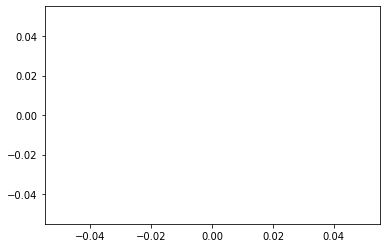

In [208]:
plt.plot(fft)

In [210]:
len(window_mean)

172800

# Independent Component Analysis

In [520]:
data_range = range(192000*5 ,192000*12)
dl = data_left[data_range]
dr = data_right[data_range]

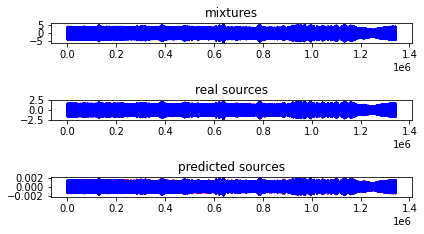

In [521]:
from sklearn.decomposition import FastICA
np.random.seed(0)
#n_samples = 2000
#time = np.linspace(0, 8, n_samples)
#s1 = np.sin(2 * time)
#s2 = np.sign(np.sin(3 * time))
#s3 = signal.sawtooth(2 * np.pi * time)
S = np.c_[dl, dr]
S = S.astype('float')
#S += 0.2 * np.random.normal(size=S.shape)
S /= S.std(axis=0)
A = np.array([[1, 1], [0.5, 2]])
X = np.dot(S, A.T)
ica = FastICA(n_components=2)
S_ = ica.fit_transform(X)
fig = plt.figure()
models = [X, S, S_]
names = ['mixtures', 'real sources', 'predicted sources']
colors = ['red', 'blue', 'orange']
for i, (name, model) in enumerate(zip(names, models)):
    plt.subplot(4, 1, i+1)
    plt.title(name)
    for sig, color in zip (model.T, colors):
        plt.plot(sig, color=color)
        
fig.tight_layout()        
plt.show()

In [453]:
S.astype('float')

array([[-2772.,  -760.],
       [ 9725.,  6781.],
       [ 1537.,  3344.],
       ...,
       [-3926.,  1385.],
       [ 4049.,  2930.],
       [ 6112.,  8659.]])

In [457]:
S_

array([[ 0.00014108,  0.00059192],
       [-0.00109383, -0.00109713],
       [-0.0005036 ,  0.00036752],
       ...,
       [-0.00015844,  0.00142426],
       [-0.00047095, -0.00043138],
       [-0.00132745,  0.00035723]])

In [522]:
ica_l = S_[:,0]
ica_r = S_[:,1]

In [471]:
def visualize_fft2(data):
    times = np.arange(len(data))/float(samplerate)

    plt.close("all")

    Fs = 192000#5000*2.#10000.
    NFFT = 16384#min(4096, len(data))#32768
    noverlap = NFFT - NFFT/10#NFFT /2 #fft size
    pad_to = NFFT * 16
    dynamicRange = 30#30 #change this to change the color scale. 
    vmin = 20*np.log10(np.max(data)) - dynamicRange

    #window=blackman(NFFT)
    #window=signal.nuttall(NFFT)
    #window=np.hamming(NFFT)
    window = np.hanning(NFFT)

    cmap = plt.get_cmap('magma')

    vmin = data_right.min()
    vmax = data_right.max()

    Pxx, freqs, times, cax = plt.specgram(data, NFFT=NFFT, window=window,vmax=-100,vmin=-200, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', pad_to=pad_to, cmap=cmap)
    print(len(Pxx))
    #Pxx_left, freqs_left, times_left, cax_left = plt.specgram(data_left, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx_right, freqs_right, times_right, cax_right = plt.specgram(data_right, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
    #Pxx = np.absolute(np.subtract(Pxx_left,Pxx_left))
    #print Pxx
    #f, t, Sxx = signal.spectrogram(data_right, Fs)

    #print type(Pxx)
    #plt.figure(figsize=(20,10))
    axes_spec = plt.gca()
    #axes_spec.set_xlim([2.8, 7.5])
    axes_spec.set_ylim([17500, 18500])

    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    #plt.pcolormesh(t, f, Sxx, vmax = 1e-6)
    #plt.show()

    plt.colorbar(cax, label='(dB)').ax.yaxis.set_label_position('left')

    plt.tight_layout()
    return Pxx, freqs, times

131073


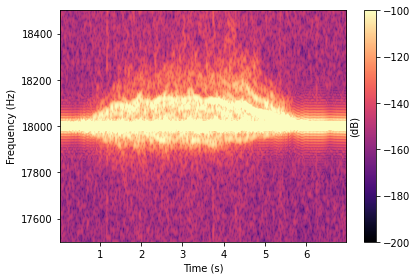

In [524]:
_,_,_ = visualize_fft2(ica_l)

131073


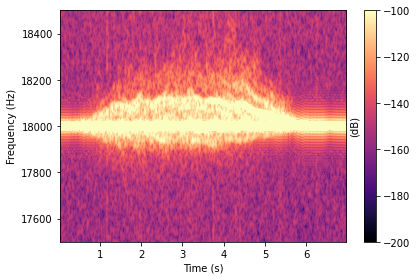

In [525]:
_,_,_ = visualize_fft2(ica_r)

In [450]:
np.c_[dl,dr]

array([[-2772,  -760],
       [ 9725,  6781],
       [ 1537,  3344],
       ...,
       [-3926,  1385],
       [ 4049,  2930],
       [ 6112,  8659]], dtype=int16)

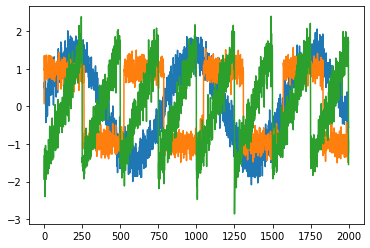

In [448]:
plt.plot(S)

In [403]:
feat = proc_Pxx.T

In [404]:
feat.index = feat.index.astype(float)

In [405]:
other1 = ['waking']*len(feat.loc[feat.index<1.8])

In [406]:
front = ['front-walking']*len(feat.loc[(feat.index>=1.8) & (feat.index<4.5)])

In [407]:
other2 = ['waking']*len(feat.loc[feat.index>4.5])

In [408]:
labels = other1+front+other2#[other1,front,other2]

In [409]:
labels = pd.DataFrame(labels)
labels.index = feat.index

In [411]:
make_folder_structure()

In [412]:
feat.to_csv("processed/fft/" + date + "/left/" +  selected_session[0][0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + selected_session[0][1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=True)
labels.to_csv("processed/fft/" + date + "/left/" + 'label' + "_" + selected_session[0][0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + selected_session[0][1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=True)
        

In [346]:
selected_session[0][0]

datetime.datetime(2021, 4, 20, 16, 54, 3, 307000)

IndexError: index 0 is out of bounds for axis 0 with size 0

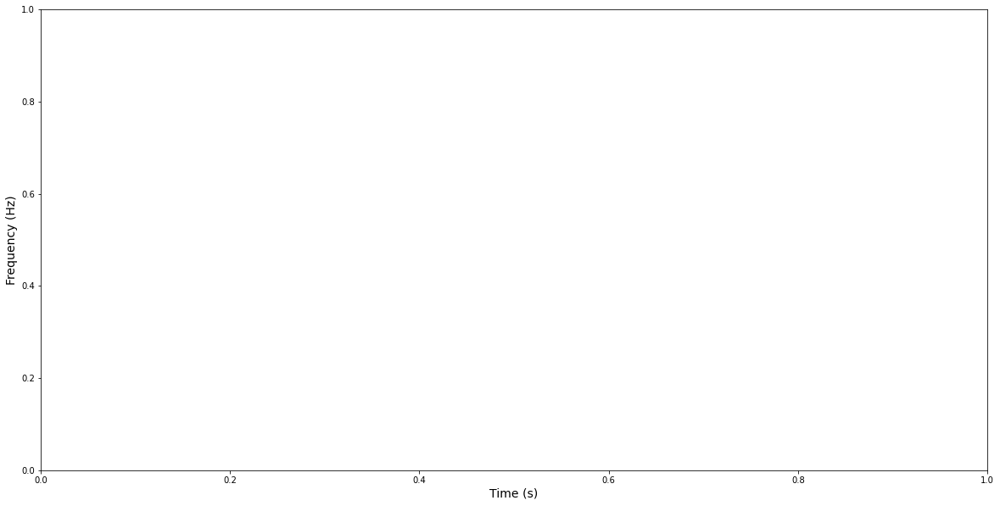

In [1905]:
trim_proc_Pxx = proc_Pxx.loc[:,(proc_Pxx.columns>7) & (proc_Pxx.columns<22)]
plt.figure(figsize=(20,10))
#plt.xticks(cadence.columns, fontsize=9)
#plt.yticks(cadence.index.values.tolist(), fontsize=9)
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Frequency (Hz)", fontsize=14)
plt.imshow(trim_proc_Pxx,cmap='magma',vmax=10,interpolation='nearest', origin='lower',extent=[trim_proc_Pxx.columns.values[0],trim_proc_Pxx.columns.values[-1],trim_proc_Pxx.index.values[0],trim_proc_Pxx.index.values[-1]], aspect='auto')
plt.colorbar()

In [107]:
import pylab as pl

def calculate_spectrum(signal,samplerate):
    rate = samplerate
    t = np.arange(0, 10, 1/rate)
    x = signal
    p = 20*np.log10(np.abs(np.fft.rfft(x)))
    f = np.fft.rfftfreq(len(x),d=1./rate)#np.linspace(0, rate/2, len(p))
    #print(f)
    #print(len(f))
    #print(f)
    #plt.plot(p[500:750])
    spectrum = pd.DataFrame(p)
    spectrum.index = f
    #display(spectrum[18000:21000])
    #spectrum[18000:21000].plot()
    #plot(f[18000:21000], p[18000:21000])
    #plt.show()
    return spectrum

In [213]:
from numpy.fft import fft
from tqdm import tqdm
cadence = pd.DataFrame()
count = 0
for index, row in tqdm(proc_Pxx.iterrows()):
    #print("|" + "*"*(count+1) + ' '*int((len(test_Pxx)-1-count)) + "| " +str(format((count+1)/len(test_Pxx)*100,'.3f')) + "% is complete..." ,end="\r")
    samplerate = 10#len(row)/times[-1]
    r = calculate_spectrum(row,samplerate)
    cadence =  pd.concat([cadence,r.T],axis=0)
    count = count+1
    #break
    
cadence.index = proc_Pxx.index

956it [00:05, 141.68it/s]


In [838]:
gc.collect()

38547

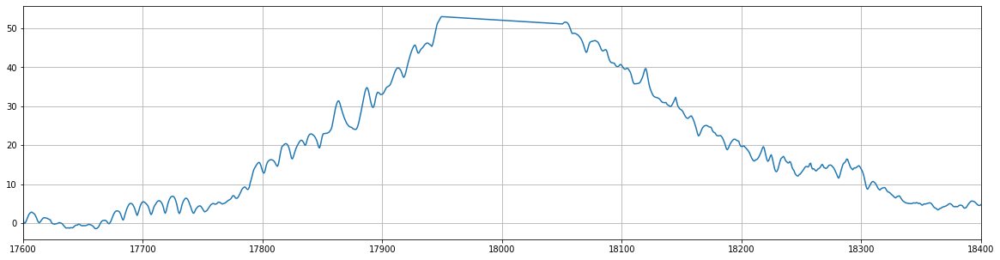

In [168]:
plt.figure(figsize=(20,5))
plt.grid()
plt.xlim(17600,18400)
plt.plot(cadence.mean(axis=1))

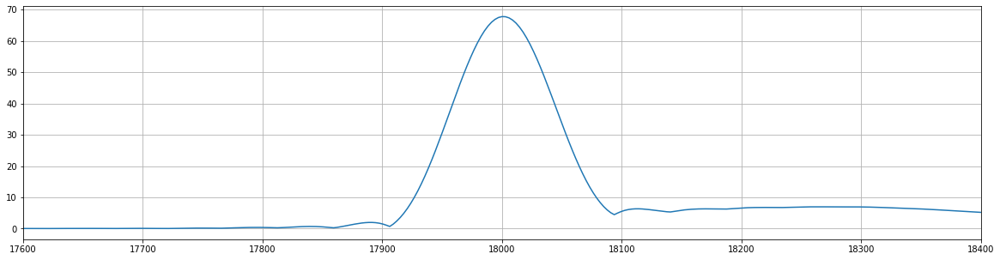

In [2053]:
plt.figure(figsize=(20,5))
plt.grid()
plt.xlim(17600,18400)
plt.plot(proc_Pxx.mean(axis=1))

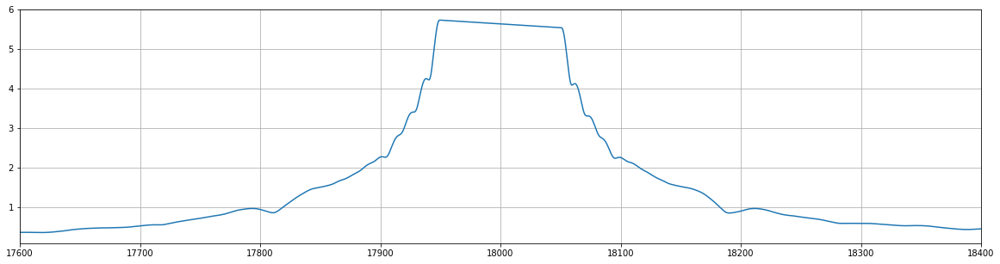

In [49]:
plt.figure(figsize=(20,5))
plt.grid()
plt.xlim(17600,18400)
plt.plot(proc_Pxx.mean(axis=1))

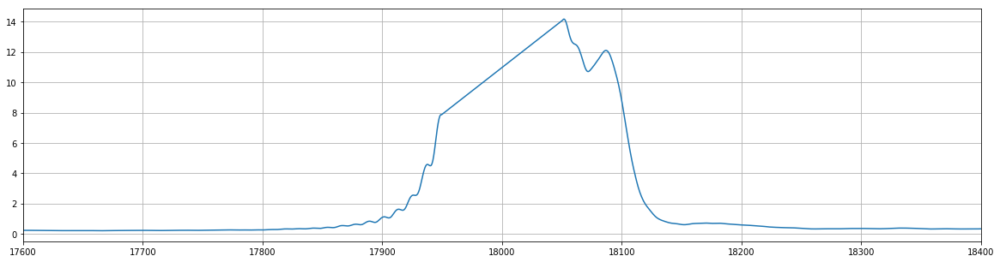

In [307]:
plt.figure(figsize=(20,5))
plt.grid()
plt.xlim(17600,18400)
plt.plot(proc_Pxx.mean(axis=1))

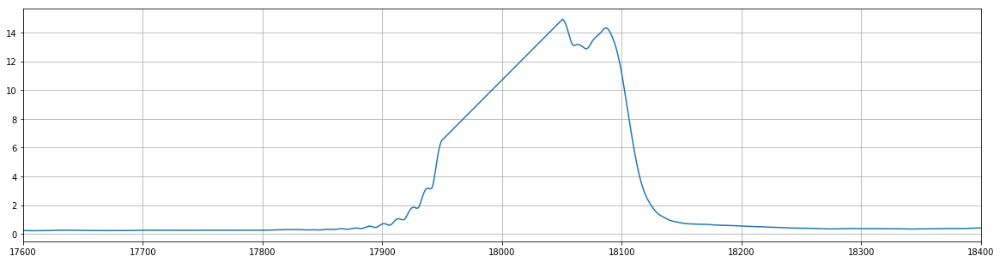

In [329]:
plt.figure(figsize=(20,5))
plt.grid()
plt.xlim(17600,18400)
plt.plot(proc_Pxx.mean(axis=1))

In [273]:
def diff_calc(df_slize):
    df_diff = df_slize.diff(axis=1)
    df_diff.dropna(inplace=True,axis=1)
    #norm_diff = df_diff / df_diff.max(axis=1).values
    norm_diff = df_diff#.divide(df_diff.max(axis=1).values, axis=0)
    return norm_diff

In [274]:
diff_Pxx =  diff_calc(df_slize)

In [465]:
from PIL import Image

from PIL import ImageFilter

In [475]:
imageObject  = Image.fromarray(Pxx_right, 'RGB')

In [476]:
edgeEnahnced = imageObject.filter(ImageFilter.EDGE_ENHANCE)
#edgeEnhanced.show()

In [137]:
cadence.max()

0.000000        122.341928
1.464844        118.224025
2.929688        103.816593
4.394531        112.481558
5.859375        105.991316
                   ...    
95994.140625     30.541405
95995.605469     30.105430
95997.070312     31.929423
95998.535156     30.156895
96000.000000     31.138912
Length: 65537, dtype: float64

In [102]:
import pylab as pl

def calculate_spectrum(signal):
    rate = samplerate
    t = np.arange(0, 10, 1/rate)
    x = signal
    p = 20*np.log10(np.abs(np.fft.rfft(x)))
    f = np.linspace(0, rate/2, len(p))
    #print(len(p))
    #print(len(f))
    #print(f)
    #plt.plot(p[500:750])
    spectrum = pd.DataFrame(p)
    spectrum.index = f
    #display(spectrum[18000:21000])
    #spectrum[18000:21000].plot()
    #plot(f[18000:21000], p[18000:21000])
    #plt.show()
    return spectrum#[18000:21000].T

In [103]:
result = np.correlate(data_left[-60000:], y, mode='same')
#result[result.size/2:]

In [74]:
spec = calculate_spectrum(result)

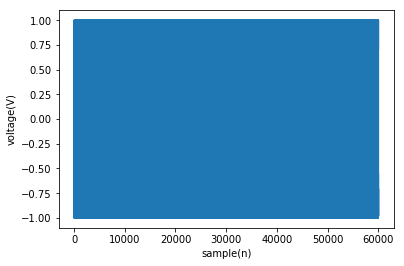

In [66]:
Fs = 192000
f = 18000
sample = len(data_left[-60000:])
x = np.arange(sample)
y = np.sin(2 * np.pi * f * x / Fs)
plt.plot(x, y)
plt.xlabel('sample(n)')
plt.ylabel('voltage(V)')
plt.show()

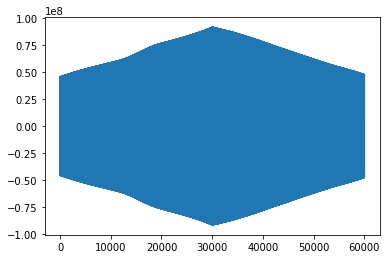

In [71]:
plt.plot(result)

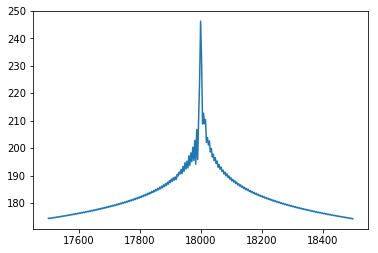

In [76]:
plt.plot(spec[17500:18500])

131073


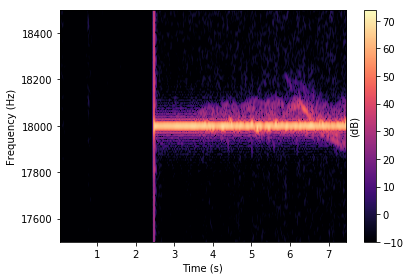

In [86]:
visualize_fft(data_left)

131073


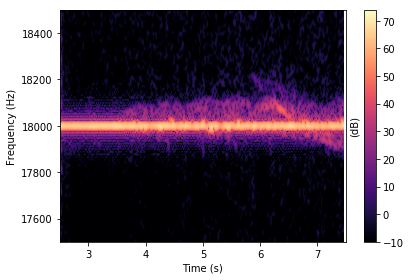

In [104]:
visualize_fft(data_left)

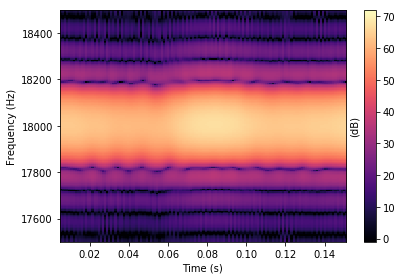

In [63]:
visualize_fft(data_left[-30000:])

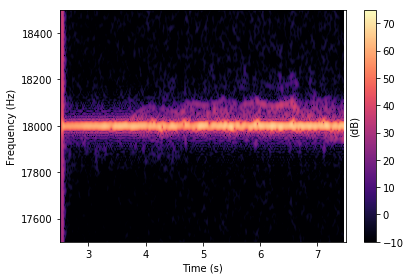

In [71]:
visualize_fft(data_right)

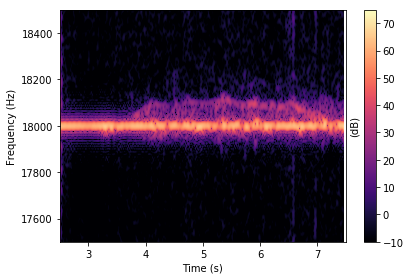

In [56]:
visualize_fft(data_left)

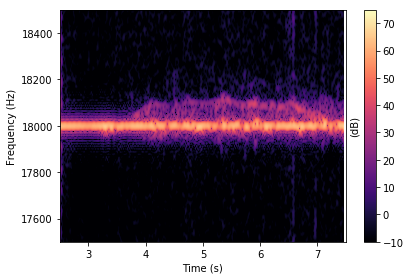

In [57]:
visualize_fft(data_right)

# Make a list of wave wave timestamp files in the selected session

In [15]:
def sweep_list_maker():
    file_list = []
    for s in selected_session:
        for filename in os.listdir(sweep_time_path):
            t = filename.split('.')[0]
            filetime = datetime.datetime.strptime(t,'%Y%m%d_%H%M%S')
            if filetime >= s[0] and filetime <= s[1]:
                file_list.append(filename)
    return file_list

In [16]:
sweep_filelist = sweep_list_maker()

FileNotFoundError: [Errno 2] No such file or directory: 'data/sweep/20210324/'

In [212]:
sweep_filelist

['20210319_160843.csv',
 '20210319_161013.csv',
 '20210319_161034.csv',
 '20210319_161114.csv',
 '20210319_161311.csv',
 '20210319_161431.csv',
 '20210319_161452.csv',
 '20210319_161520.csv',
 '20210319_161557.csv',
 '20210319_161619.csv',
 '20210319_161649.csv',
 '20210319_161724.csv',
 '20210319_161747.csv',
 '20210319_161830.csv',
 '20210319_161926.csv',
 '20210319_162131.csv',
 '20210319_162201.csv',
 '20210319_162305.csv',
 '20210319_162346.csv',
 '20210319_162610.csv',
 '20210319_162653.csv']

# Make a list of audio start-end timestamp files in the selected session

In [17]:
def aud_list_maker():
    file_list = []
    for s in selected_session:
        for filename in os.listdir(aud_time_path):
            t = filename.split('.')[0]
            filetime = datetime.datetime.strptime(t,'%Y%m%d_%H%M%S')
            #print(filetime)
            if filetime >= s[0].replace(microsecond=0) and filetime <= s[1].replace(microsecond=0):
                file_list.append(filename)
    return file_list

In [18]:
aud_filelist = aud_list_maker()

FileNotFoundError: [Errno 2] No such file or directory: 'data/aud_times/20210324/'

In [19]:
selected_session

[[datetime.datetime(2021, 3, 24, 17, 52, 46, 454000),
  datetime.datetime(2021, 3, 24, 17, 52, 59, 879000)]]

In [216]:
aud_filelist

['20210319_160841.csv',
 '20210319_161010.csv',
 '20210319_161032.csv',
 '20210319_161112.csv',
 '20210319_161309.csv',
 '20210319_161429.csv',
 '20210319_161450.csv',
 '20210319_161518.csv',
 '20210319_161555.csv',
 '20210319_161617.csv',
 '20210319_161648.csv',
 '20210319_161722.csv',
 '20210319_161745.csv',
 '20210319_161828.csv',
 '20210319_161925.csv',
 '20210319_162129.csv',
 '20210319_162159.csv',
 '20210319_162303.csv',
 '20210319_162344.csv',
 '20210319_162608.csv',
 '20210319_162651.csv']

# Visualizing spectrogram

for audio_file in wav_filelist:#os.listdir(stereo_file_path):
    #audio_file = "20200910_142646_042.wav"
    print(audio_file)
    #samplerate, data = wavfile.read('20171025/data/' + filename)
    audio_name = os.path.splitext(audio_file)[0]
    
#     for pic_file in os.listdir(visual_path):
#         pic_name = os.path.splitext(pic_file)[0]
#         if pic_mame == audio_name: #data file has already been visualized
#             flag = 1

    if flag == 0:        
        samplerate, data = wavfile.read(stereo_file_path + audio_file)
        
        data_left = data[:, 0]
        data_right = data[:, 1]
        
        #data_left = np.append(data_left[0],data_left[1:] - 0.97*data_left[:-1])
        
        #data_left = np.square(data_left)
        #data_right = np.square(data_right)

        
        #data = np.subtract(data_left,data_right)
        
        #data1 = np.absolute(data)
        
        #data2 = np.sqrt(data1)
        
        times = np.arange(len(data))/float(samplerate)

        plt.close("all")

        Fs = samplerate#44100#5000*2.#10000.
        NFFT = 256#512#22050#min(4096, len(data))#32768
        noverlap = NFFT/2#NFFT /2 #fft size
        pad_to = NFFT * 16
        dynamicRange = 30#30 #change this to change the color scale. 
        vmin = 20*np.log10(np.max(data)) - dynamicRange

        #window=blackman(NFFT)
        #window=signal.nuttall(NFFT)
        #window=np.hamming(NFFT)
        window = np.hanning(NFFT)

        cmap = plt.get_cmap('magma')
        
        vmin = data_right.min()
        vmax = data_right.max()
        
        #t = np.linspace(0, 0.1, 9600)
        #generated_sweep = chirp(t=t, f0=18000, t1=1, f1=22000, method='linear')  
        
        #t = np.linspace(0, 1, 44100)
        #generated_sweep = chirp(t=t, f0=18000, t1=1, f1=20000, method='linear')
        
        Pxx, freqs, times, cax = plt.specgram(generated_sweep, NFFT=NFFT, vmin=-50,vmax=0,window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', pad_to=pad_to, cmap=cmap)
     
        #Pxx_left, freqs_left, times_left, cax_left = plt.specgram(data_left, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
        #Pxx_right, freqs_right, times_right, cax_right = plt.specgram(data_right, NFFT=NFFT, window=window, Fs=samplerate, noverlap=noverlap, mode='magnitude', scale='dB', vmin=75, pad_to=pad_to, cmap=cmap)
        #Pxx = np.absolute(np.subtract(Pxx_left,Pxx_left))
        #print Pxx
        #f, t, Sxx = signal.spectrogram(data_right, Fs)

        #print type(Pxx)

        axes_spec = plt.gca()
        #axes_spec.set_xlim([0., 30])
        #axes_spec.set_xlim([9.9,10.5])
        axes_spec.set_ylim([15000, 24000])

        plt.xlabel("Time (s)")
        plt.ylabel("Frequency (Hz)")

        #plt.pcolormesh(t, f, Sxx, vmax = 1e-6)
        #plt.show()
        
        plt.colorbar(cax, label='(dB)').ax.yaxis.set_label_position('left')

        plt.tight_layout()
        #savefig('20171030/visual/' + filename + '.png')
        print ("File" + audio_file  + " is visualized!")
        
        
        gc.collect()
       
        
        plt.show()
        #plt.show()


    else:
        print ("File " + filename  + " has already been visualized. Delete the image from the visual folder and try again.")
        flag = 0
        
    break

In [217]:
f1 = 18000        # start frequency
f2 = 21000       # end frequency
fs = 48000#96000      # sampling frequency
T = 0.1          # time duration of the sweep
t = float(9600)/samplerate

a = (f2 - f1)/float(T)

t = np.arange(0,np.round(fs*T-1)/fs,1/fs)  # time axis
s = np.sin(2*np.pi*((a*t**2)/2 + (f1*t)))
#s = np.sin(2*np.pi*f1*np.exp(t)) 

In [218]:
s

array([ 0.        ,  0.70707786, -0.99999999, ...,  0.99999979,
       -0.92402036,  0.70722247])

len(generated_sweep)

In [219]:
samplerate

192000

# Visualize FFT spectrogram

# Calculate MFCC

In [221]:
def calc_mfcc(sample_rate,signal): 
    ##Pre-emphasis##
    pre_emphasis = 0.97
    emphasized_signal = np.append(signal[0], signal[1:] - pre_emphasis * signal[:-1])



    ##Framing##
    frame_size = 0.001#0.01#0.01#0.025#
    frame_stride = 0.001#0.00155#0.00144#overlapping=frame_size-frame_stride
    #overlapping=float(frame_size-frame_stride)/frame_size
    frame_length, frame_step = frame_size * sample_rate, frame_stride * sample_rate
    signal_length = len(emphasized_signal)
    frame_length = int(round(frame_length))
    frame_step = int(round(frame_step))
    num_frames = int(np.ceil(float(np.abs(signal_length - frame_length)) / frame_step))
    #print "num_frames=",num_frames
    pad_signal_length = num_frames * frame_step + frame_length
    z = np.zeros((pad_signal_length - signal_length))
    pad_signal = np.append(emphasized_signal, z)
    indices = np.tile(np.arange(0, frame_length), (num_frames, 1)) + np.tile(np.arange(0, num_frames * frame_step, frame_step), (frame_length, 1)).T
    frames = pad_signal[indices.astype(np.int32, copy=False)]



    ##Window##
    frames *= np.hamming(frame_length)
    #frames *= blackman(frame_length)



    ##Fourier-transform and power spectrum##
    NFFT = 1024
    mag_frames = np.absolute(np.fft.rfft(frames, NFFT)) #magnitude of the FFT
    pow_frames = ((1.0 / NFFT) * ((mag_frames) ** 2)) #power spectrum
    pow_frames_new = pow_frames[:,400:500]
    #print "pow_frames=",len(pow_frames)
    #print "pow_frames=",pow_frames.shape
    #print "pow_frames=",type(pow_frames)



    ##Filter banks##
    nfilt = 40
    low_freq_mel = (2595 * np.log10(1 + (18000) / 700)) #thilina was 18000 instead of 20
    high_freq_mel = (2595 * np.log10(1 + (sample_rate / 2) / 700)) #thilina was sample_rate/2#convert Hz to Mel
    
    mel_points = np.linspace(low_freq_mel, high_freq_mel, nfilt + 2) #equally spaced in Mel scale
    hz_points = (700 * (10**(mel_points / 2595) - 1)) #converts Mel to Hz
    bin = np.floor((NFFT +1) * hz_points / sample_rate)
    #print "hz_points=",hz_points
    fbank = np.zeros((nfilt, int(np.floor(NFFT / 2 +1))))
    #fbank = np.zeros((nfilt,100))
    #print "fbank=",fbank.shape
    for m in range(1, nfilt + 1):
        f_m_minus = int(bin[m - 1]) #left
        f_m = int(bin[m]) #center
        f_m_plus = int(bin[m + 1]) #right

        for k in range(f_m_minus, f_m):
            fbank[m - 1, k] = (k - bin[m - 1]) / (bin[m] - bin[m - 1])
        for k in range(f_m, f_m_plus):
            fbank[m - 1, k] = (bin[m + 1] - k) / (bin[m + 1] - bin[m])
    #print "fbank=",fbank.shape
    filter_banks = np.dot(pow_frames, fbank.T)
    #fbank_new = fbank[:,0:100]
    #filter_banks = np.dot(pow_frames_new, fbank_new.T)
    filter_banks = np.where(filter_banks == 0, np.finfo(float).eps, filter_banks) #numerical stability
    filter_banks = 20 * np.log10(filter_banks) #dB



    ##Mel-Frequency Cepstral Coefficients (MFCCs)##
    num_ceps = 12
    mfcc = dct(filter_banks, type=2, axis=1, norm='ortho')[:, 1 : (num_ceps + 1)] #keep 2-13
    cep_lifter = 22
    (nframes, ncoeff) = mfcc.shape
    n = np.arange(ncoeff)
    lift = 1 + (cep_lifter / 2) * np.sin(np.pi * n / cep_lifter)
    mfcc *= lift



    ##Mean normalization##
    filter_banks -= (np.mean(filter_banks, axis=0) + 1e-8)
    mfcc -= (np.mean(mfcc, axis=0) + 1e-8)
    
    return mfcc#,mag_frames,pow_frames,filter_banks

#def mfcc(cut):
#    feat_list = []
#    mfcc_list = []
#    for cuts in cut:
#        mfcc,mag_frames,pow_frames,filter_banks = calc_mfcc(44100,cuts)
#        mfcc_list.append(mfcc)
#        feat_list.append(mfcc.T.mean(axis=0))
#    return mfcc_list

# Read sweep timestamps

In [223]:
sweep_timestamps = []
for sweep_time_file in sweep_filelist:#os.listdir(sweep_time_path):
    print(sweep_time_file)
    with open(sweep_time_path + "/" + sweep_time_file) as csvfile: #read session data from capture_time.csv
        readCSV = csv.reader(csvfile, delimiter=',')
        line_no = 0
        #print "The data sessions taken during the start and end dates"
        for row in readCSV:
            sweep_timestamps.append(row)
            
sweep_timestamps = list(itertools.chain(*sweep_timestamps)) #These are sweep start times
sweep_timestamps = [datetime.datetime.strptime(stmp, '%Y%m%d_%H:%M:%S.%f') for stmp in sweep_timestamps]

20210319_160843.csv
20210319_161013.csv
20210319_161034.csv
20210319_161114.csv
20210319_161311.csv
20210319_161431.csv
20210319_161452.csv
20210319_161520.csv
20210319_161557.csv
20210319_161619.csv
20210319_161649.csv
20210319_161724.csv
20210319_161747.csv
20210319_161830.csv
20210319_161926.csv
20210319_162131.csv
20210319_162201.csv
20210319_162305.csv
20210319_162346.csv
20210319_162610.csv
20210319_162653.csv


In [224]:
sweep_filelist

['20210319_160843.csv',
 '20210319_161013.csv',
 '20210319_161034.csv',
 '20210319_161114.csv',
 '20210319_161311.csv',
 '20210319_161431.csv',
 '20210319_161452.csv',
 '20210319_161520.csv',
 '20210319_161557.csv',
 '20210319_161619.csv',
 '20210319_161649.csv',
 '20210319_161724.csv',
 '20210319_161747.csv',
 '20210319_161830.csv',
 '20210319_161926.csv',
 '20210319_162131.csv',
 '20210319_162201.csv',
 '20210319_162305.csv',
 '20210319_162346.csv',
 '20210319_162610.csv',
 '20210319_162653.csv']

In [225]:
sweep_timestamps

[datetime.datetime(2021, 3, 19, 16, 8, 44, 99000),
 datetime.datetime(2021, 3, 19, 16, 8, 44, 612000),
 datetime.datetime(2021, 3, 19, 16, 8, 45, 117000),
 datetime.datetime(2021, 3, 19, 16, 8, 45, 622000),
 datetime.datetime(2021, 3, 19, 16, 8, 46, 127000),
 datetime.datetime(2021, 3, 19, 16, 8, 46, 633000),
 datetime.datetime(2021, 3, 19, 16, 8, 47, 138000),
 datetime.datetime(2021, 3, 19, 16, 8, 47, 643000),
 datetime.datetime(2021, 3, 19, 16, 10, 13, 970000),
 datetime.datetime(2021, 3, 19, 16, 10, 14, 488000),
 datetime.datetime(2021, 3, 19, 16, 10, 14, 995000),
 datetime.datetime(2021, 3, 19, 16, 10, 15, 500000),
 datetime.datetime(2021, 3, 19, 16, 10, 16, 4000),
 datetime.datetime(2021, 3, 19, 16, 10, 16, 507000),
 datetime.datetime(2021, 3, 19, 16, 10, 17, 14000),
 datetime.datetime(2021, 3, 19, 16, 10, 17, 519000),
 datetime.datetime(2021, 3, 19, 16, 10, 34, 872000),
 datetime.datetime(2021, 3, 19, 16, 10, 35, 391000),
 datetime.datetime(2021, 3, 19, 16, 10, 35, 896000),
 date

# Read audio start/end timestamps

In [226]:
aud_timestamps = []
for aud_time_file in aud_filelist:#os.listdir(sweep_time_path):
    print(sweep_time_file)
    with open(aud_time_path + "/" + aud_time_file) as csvfile: #read session data from capture_time.csv
        readCSV = csv.reader(csvfile, delimiter=',')
        line_no = 0
        #print "The data sessions taken during the start and end dates"
        for row in readCSV:
            aud_timestamps.append(row)
            
aud_timestamps = list(itertools.chain(*aud_timestamps)) #These are sweep start times

20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv
20210319_162653.csv


In [227]:
aud_timestamps

['20210319_16:08:41.71-20210319_16:08:51.754',
 '20210319_16:10:10.94-20210319_16:10:21.618',
 '20210319_16:10:32.28-20210319_16:10:42.733',
 '20210319_16:11:12.53-20210319_16:11:24.905',
 '20210319_16:13:09.67-20210319_16:13:20.501',
 '20210319_16:14:29.20-20210319_16:14:39.089',
 '20210319_16:14:50.81-20210319_16:15:00.936',
 '20210319_16:15:18.95-20210319_16:15:29.569',
 '20210319_16:15:55.45-20210319_16:16:06.526',
 '20210319_16:16:17.31-20210319_16:16:28.467',
 '20210319_16:16:48.01-20210319_16:16:57.684',
 '20210319_16:17:22.71-20210319_16:17:32.688',
 '20210319_16:17:45.50-20210319_16:17:57.538',
 '20210319_16:18:28.92-20210319_16:18:39.756',
 '20210319_16:19:25.19-20210319_16:19:34.669',
 '20210319_16:21:29.44-20210319_16:21:39.483',
 '20210319_16:21:59.83-20210319_16:22:09.240',
 '20210319_16:23:03.68-20210319_16:23:13.559',
 '20210319_16:23:44.40-20210319_16:23:54.126',
 '20210319_16:26:08.70-20210319_16:26:18.258',
 '20210319_16:26:51.27-20210319_16:27:02.682']

# Read the data from the audio file/files and normalize them

In [21]:
data_left

array([    0,     0,     0, ...,  5106,  6977, -5052], dtype=int16)

In [229]:
datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f')

datetime.datetime(2021, 3, 19, 16, 8, 41, 727000)

In [230]:
wav_filelist

['20210319_160841_727.wav',
 '20210319_161010_953.wav',
 '20210319_161032_301.wav',
 '20210319_161112_544.wav',
 '20210319_161309_690.wav',
 '20210319_161429_216.wav',
 '20210319_161450_827.wav',
 '20210319_161518_960.wav',
 '20210319_161555_466.wav',
 '20210319_161617_317.wav',
 '20210319_161648_025.wav',
 '20210319_161722_729.wav',
 '20210319_161745_512.wav',
 '20210319_161828_930.wav',
 '20210319_161925_206.wav',
 '20210319_162129_455.wav',
 '20210319_162159_848.wav',
 '20210319_162303_694.wav',
 '20210319_162344_411.wav',
 '20210319_162608_712.wav',
 '20210319_162651_287.wav']

# Read the sweep timestamps from the sweep file

for sweep_time_file in os.listdir(sweep_time_path):
    #sweep_time_file = "20200914_175451.csv"
    print(sweep_time_file)
    
    sweep_timestamps = []
    with open(sweep_time_path + "/" + sweep_time_file) as csvfile: #read session data from capture_time.csv
        readCSV = csv.reader(csvfile, delimiter=',')
        line_no = 0
        #print "The data sessions taken during the start and end dates"
        for row in readCSV:
            sweep_timestamps.append(row)
    break       
sweep_timestamps = list(itertools.chain(*sweep_timestamps)) #These are sweep start times
sweep_timestamps = [datetime.datetime.strptime(stmp, '%Y%m%d_%H:%M:%S.%f') for stmp in sweep_timestamps]

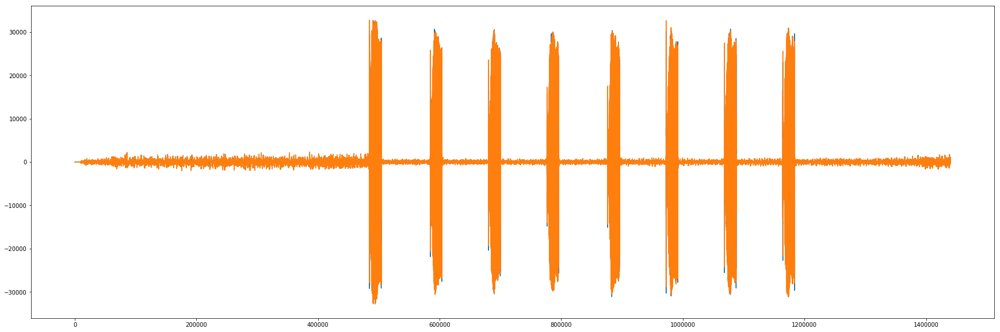

In [231]:
plt.figure(figsize=(30,10))
plt.plot(data)

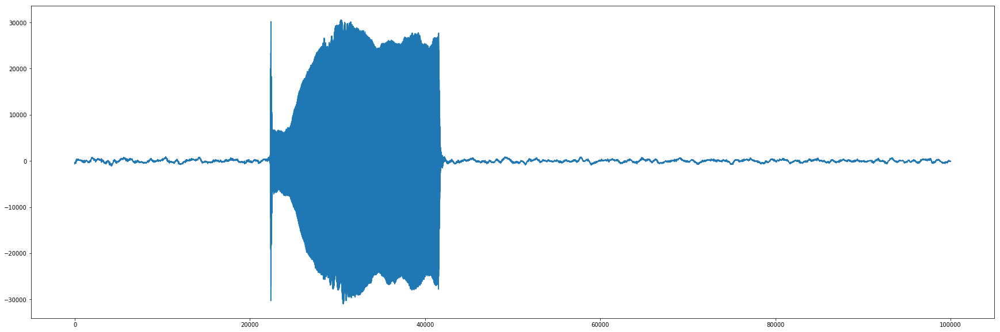

In [232]:
plt.figure(figsize=(30,10))
plt.plot(data_left[950000:1000000+50000])

# Calculate audio start/end times

In [233]:
def calc_start_end(aud_t):
    #for aud_t in aud_timestamps:
    audio_start = aud_t.split('-')[0]
    audio_end = aud_t.split('-')[1]

    audio_start = datetime.datetime.strptime(audio_start, '%Y%m%d_%H:%M:%S.%f')
    audio_end = datetime.datetime.strptime(audio_end, '%Y%m%d_%H:%M:%S.%f')
    return audio_start, audio_end

In [234]:
aud_timestamps

['20210319_16:08:41.71-20210319_16:08:51.754',
 '20210319_16:10:10.94-20210319_16:10:21.618',
 '20210319_16:10:32.28-20210319_16:10:42.733',
 '20210319_16:11:12.53-20210319_16:11:24.905',
 '20210319_16:13:09.67-20210319_16:13:20.501',
 '20210319_16:14:29.20-20210319_16:14:39.089',
 '20210319_16:14:50.81-20210319_16:15:00.936',
 '20210319_16:15:18.95-20210319_16:15:29.569',
 '20210319_16:15:55.45-20210319_16:16:06.526',
 '20210319_16:16:17.31-20210319_16:16:28.467',
 '20210319_16:16:48.01-20210319_16:16:57.684',
 '20210319_16:17:22.71-20210319_16:17:32.688',
 '20210319_16:17:45.50-20210319_16:17:57.538',
 '20210319_16:18:28.92-20210319_16:18:39.756',
 '20210319_16:19:25.19-20210319_16:19:34.669',
 '20210319_16:21:29.44-20210319_16:21:39.483',
 '20210319_16:21:59.83-20210319_16:22:09.240',
 '20210319_16:23:03.68-20210319_16:23:13.559',
 '20210319_16:23:44.40-20210319_16:23:54.126',
 '20210319_16:26:08.70-20210319_16:26:18.258',
 '20210319_16:26:51.27-20210319_16:27:02.682']

# Remove sweep timestamps outside audio start/end timestamps

In [235]:
def clear_sweep_timestamps(sweep_timestamps):
    swp = []
    for t in sweep_timestamps:
        print(t)
        if t < audio_endtime:
            swp.append(t)
    return swp

# Generate sweep signal

In [236]:
from scipy.signal import chirp

def generate_sweep():
#     if samplerate == 96000:
#         t = np.linspace(0, 0.1, 9600)
#     if samplerate == 48000:
#         t = np.linspace(0, 1, 4800)    
#     if samplerate == 44100:
#         t = np.linspace(0, 1, 4410)
        
#     #t = np.linspace(0, 1, 9600)
#     generated_sweep = chirp(t=t, f0=18000, t1=1, f1=21000, method='linear')   
    x = 0
    if samplerate == 96000:
        x = 9600
    if samplerate == 192000:
        x = 19200
    
    
    f1 = 18000        # start frequency
    f2 = 21000       # end frequency
    fs = samplerate#96000      # sampling frequency
    T = 0.1          # time duration of the sweep
    t = float(x)/samplerate

    a = (f2 - f1)/float(T)

    t = np.arange(0,np.round(fs*T-1)/fs,1/fs)  # time axis
    sweep = np.sin(2*np.pi*((a*t**2)/2 + (f1*t)))
    #s = np.sin(2*np.pi*f1*np.exp(t)) 
    return sweep

# Generate sweep signal

generated_sweep = generate_sweep()

# Bandpass filter

In [237]:
from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

def filter_signal(sweep_signal):
    #filtered_sweep_signals = []
    #print sweep_signals
    #for sig in sweep_signals:
    filtered_sweep_signals = butter_bandpass_filter(sweep_signal,17000,22000,samplerate)
    return filtered_sweep_signals

# Convolution

In [238]:
def convolution(data,generated_sweep):
    conv = []
    
    conv = scipy.signal.fftconvolve(data, generated_sweep[::-1])#thilina comment- changed from generated_sweep[::-1] to generated_sweep[::-1]*itr.max()

    #cut = []
    #max_cor_pos = []

    #for i in range(0,len(conv)):
    #    cut.append(conv[i][conv[i].argmax()-2000:conv[i].argmax()+2000])
        
    return conv

# Envelop calculation

In [239]:
def get_envelop(inputSignal):
    
    # Taking the absolute value
    
    absoluteSignal = []
    for sample in inputSignal:
        absoluteSignal.append (abs (sample))
    
    # Peak detection
    
    intervalLength = 40 # Experiment with this number, it depends on your sample frequency and highest "whistle" frequency
    outputSignal = []
    
    for baseIndex in range (intervalLength, len (absoluteSignal)):
        maximum = 0
        for lookbackIndex in range (intervalLength):
            maximum = max (absoluteSignal [baseIndex - lookbackIndex], maximum)
        outputSignal.append (maximum)
    
    return outputSignal

In [240]:
from scipy.signal import hilbert
def calc_envelop(cut):
    analytic_signal = hilbert(cut)
    amplitude_envelop = np.abs(analytic_signal)
    return amplitude_envelop

In [115]:
def make_folder_structure():
    if not os.path.exists("processed/" + "/ir"):
        os.mkdir("processed/" + "/ir",0o777)

    if not os.path.exists("processed/" + "/ir/" + date):
        os.mkdir("processed/" + "/ir/" + date,0o777)
        
    if not os.path.exists("processed/" + "/ir/" + date + "/left"):
        os.mkdir("processed/" + "/ir/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "/ir/" + date + "/right"):
        os.mkdir("processed/" + "/ir/" + date + "/right",0o777)
        
    if not os.path.exists("processed/" + "/ir_raw"):
        os.mkdir("processed/" + "/ir_raw",0o777)

    if not os.path.exists("processed/" + "/ir_raw/" + date):
        os.mkdir("processed/" + "/ir_raw/" + date,0o777)
        
    if not os.path.exists("processed/" + "/ir_raw/" + date + "/left"):
        os.mkdir("processed/" + "/ir_raw/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "/ir_raw/" + date + "/right"):
        os.mkdir("processed/" + "/ir_raw/" + date + "/right",0o777)
        
    if not os.path.exists("processed/" + "mfcc/"):
        os.mkdir("processed/" + "mfcc/",0o777)
        
    if not os.path.exists("processed/" + "spectrum/"):
        os.mkdir("processed/" + "spectrum/",0o777)
        
    if not os.path.exists("processed/" + "mfcc/" + date):
        os.mkdir("processed/" + "mfcc/" + date,0o777)
        
    if not os.path.exists("processed/" + "spectrum/" + date):
        os.mkdir("processed/" + "spectrum/" + date,0o777)
        
    if not os.path.exists("processed/" + "mfcc/" + date + "/left"):
        os.mkdir("processed/" + "mfcc/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "mfcc/" + date + "/right"):
        os.mkdir("processed/" + "mfcc/" + date + "/right",0o777)
        
    if not os.path.exists("processed/" + "spectrum/" + date + "/left"):
        os.mkdir("processed/" + "spectrum/" + date + "/left",0o777)
                
    if not os.path.exists("processed/" + "spectrum/" + date + "/right"):
        os.mkdir("processed/" + "spectrum/" + date + "/right",0o777)
        
    if not os.path.exists("processed/" + "fft/" ):
        os.mkdir("processed/" + "fft/" ,0o777)
        
    if not os.path.exists("processed/" + "fft/" + date ):
        os.mkdir("processed/" + "fft/" + date ,0o777)
        
    if not os.path.exists("processed/" + "fft/" + date + "/left"):
        os.mkdir("processed/" + "fft/" + date + "/left",0o777)

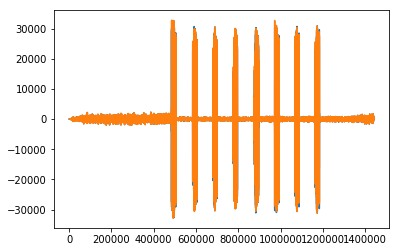

In [242]:
plt.plot(data)

In [243]:
def extract_mfcc_feat(imp_res):
    sample_rate = 192000
    lbp_set = pd.DataFrame()
    mfcc_set = pd.DataFrame()
    for index, row in imp_res.iterrows():
        signal = np.array(row)
        #formants = get_formants(signal)
        mfcc = calc_mfcc(sample_rate,signal)
        mfcc_set = pd.concat([mfcc_set,pd.DataFrame(mfcc.flatten()).T],axis=0)
        #lbp = lbp_feat_calc(mfcc)
        #lbp_set = pd.concat([lbp_set,lbp], axis=0)
        #formant_set = pd.concat([formant_set, formants,axis=0])
    #lbp_set.index = imp_res.index
    mfcc_set.index = imp_res.index
    return mfcc_set

In [244]:
def extract_spectral_feat(imp_res):
    spectrum_set = pd.DataFrame()
    for index, row in imp_res.iterrows():
        signal = np.array(row)
        f = calculate_spectrum(signal)
        spectrum_set = pd.concat([spectrum_set, f],axis=0)

    spectrum_set.index = imp_res.index
    return spectrum_set

In [245]:
import pylab as pl

def calculate_spectrum(signal):
    rate = samplerate
    t = np.arange(0, 10, 1/rate)
    x = signal
    p = 20*np.log10(np.abs(np.fft.rfft(x)))
    f = np.linspace(0, rate/2, len(p))
    #print(len(p))
    #print(len(f))
    #print(f)
    #plt.plot(p[500:750])
    spectrum = pd.DataFrame(p)
    spectrum.index = f
    #display(spectrum[18000:21000])
    #spectrum[18000:21000].plot()
    #plot(f[18000:21000], p[18000:21000])
    #plt.show()
    return spectrum[18000:21000].T

In [246]:
from tqdm import tqdm
from pathlib import Path
import gc
gc.enable()
count = 0
for ss in tqdm(selected_session):
    #print(mem())
    for audio_file in wav_filelist:
        if datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') >= ss[0] and datetime.datetime.strptime(audio_file.split(".")[0],'%Y%m%d_%H%M%S_%f') < ss[1]:
            audio_name = os.path.splitext(audio_file)[0]
            samplerate, data = wavfile.read(stereo_file_path + audio_file)
            data_left = data[:, 0]
            data_right = data[:, 1]
            break
    if audio_file == "20210310_155757_416.wav":
        continue
    #print("|" + "*"*(count+1) + ' '*(len(selected_session)-1-count)+ "| " +str(format(round((count+1)/len(selected_session))*100,'.3f')) + "% is complete..." ,end="\r")

    print("Calculating impulse responses from audio file " + audio_file)
    
    for aud_t in aud_timestamps:
        audio_start, audio_end = calc_start_end(aud_t)
        if (audio_start) >= ss[0] and (audio_start) < ss[1]:
            break
    
    ss_sweep_timestamps = []
    for sw in sweep_timestamps:
        if sw >= ss[0] and sw < ss[1]:
            ss_sweep_timestamps.append(sw)
    
    
    for data in [data_left,data_right]:
        corr = []
        corr_raw = []
        if (data == data_left).all():
            stream = "left"
        if (data == data_right).all():
            stream = "right"
            
        data = filter_signal(data_left)
        
        print("\t Calculating the impulse responses of the " + stream + " stream")
        norm_data = data #if add normalize_data(data) if it is necessary to normalize the data before calculating the impulse response
        
        generated_sweep = generate_sweep()

        if samplerate == 192000:
            start = 20000#45000
        if samplerate == 96000:
            start = 35000#35000
        if samplerate == 48000:
            start = 10000
            
        my_file_ir = Path("processed/mfcc/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3])
        my_file_ir_raw = Path("processed/spectrum/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3])
        if my_file_ir.is_file() and my_file_ir_raw.is_file():
            print("\t \t File already exists...")
            break
        else:       
            for ss_sw in ss_sweep_timestamps:
                sweep_sample = int((ss_sw - audio_start).total_seconds()*samplerate)
                #print(sweep_sample)

                if samplerate == 96000:
                    sweep = norm_data[sweep_sample - start:sweep_sample]#norm_data[sweep_sample - 11400:sweep_sample-6990]
                if samplerate == 192000:
                    sweep =norm_data[sweep_sample+25000:sweep_sample+55000]#for s20+ ultra norm_data[sweep_sample:sweep_sample+start]#for note s20
                #print("Generated length = ", len(generated_sweep))
                #print("Recorded sweep length = ", len(sweep))
                #plt.figure(figsize=(30,10))
                #plt.plot(sweep)
                #plt.show()

                conv = np.correlate(sweep,generated_sweep[::1],'same')
                conv_cut = conv[conv.argmax():]
                envelop = calc_envelop(conv_cut)
                #envelop2 = get_envelop(conv_cut)
                corr_raw.append(conv_cut)
                corr.append(envelop)
        nc_raw = []
        nc = []
        for i in corr_raw:
            nc_raw.append(i[:6000]/max(i[:6000]))
        for i in corr:
            nc.append(i[:6000]/max(i[:6000]))
            
        trimmed_ir_raw = pd.DataFrame(nc_raw)
        trimmed_ir = pd.DataFrame(nc)
        
        mfcc_feat = extract_mfcc_feat(trimmed_ir_raw)
        spec_feat = extract_spectral_feat(trimmed_ir_raw)
        
        make_folder_structure()
        
        #Save data
        mfcc_feat.to_csv("processed/mfcc/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)
        spec_feat.to_csv("processed/spectrum/" + date + "/" + stream + "/" + ss[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + ss[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)
        
        gc.collect()
        #break
    count = count + 1
    #break

  0%|          | 0/21 [00:00<?, ?it/s]

Calculating impulse responses from audio file 20210319_160841_727.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


  5%|▍         | 1/21 [01:00<20:08, 60.42s/it]

Calculating impulse responses from audio file 20210319_161010_953.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 10%|▉         | 2/21 [01:46<17:47, 56.20s/it]

Calculating impulse responses from audio file 20210319_161032_301.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 14%|█▍        | 3/21 [03:00<18:24, 61.34s/it]

Calculating impulse responses from audio file 20210319_161112_544.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 19%|█▉        | 4/21 [04:01<17:22, 61.30s/it]

Calculating impulse responses from audio file 20210319_161309_690.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 24%|██▍       | 5/21 [04:46<15:02, 56.41s/it]

Calculating impulse responses from audio file 20210319_161429_216.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 29%|██▊       | 6/21 [05:32<13:20, 53.36s/it]

Calculating impulse responses from audio file 20210319_161450_827.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 33%|███▎      | 7/21 [06:24<12:19, 52.83s/it]

Calculating impulse responses from audio file 20210319_161518_960.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 38%|███▊      | 8/21 [07:23<11:52, 54.83s/it]

Calculating impulse responses from audio file 20210319_161555_466.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 43%|████▎     | 9/21 [08:21<11:08, 55.68s/it]

Calculating impulse responses from audio file 20210319_161617_317.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 48%|████▊     | 10/21 [09:09<09:48, 53.55s/it]

Calculating impulse responses from audio file 20210319_161648_025.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 52%|█████▏    | 11/21 [09:47<08:08, 48.88s/it]

Calculating impulse responses from audio file 20210319_161722_729.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 57%|█████▋    | 12/21 [10:33<07:10, 47.81s/it]

Calculating impulse responses from audio file 20210319_161745_512.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 62%|██████▏   | 13/21 [11:41<07:10, 53.85s/it]

Calculating impulse responses from audio file 20210319_161828_930.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 67%|██████▋   | 14/21 [12:37<06:22, 54.68s/it]

Calculating impulse responses from audio file 20210319_161925_206.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 71%|███████▏  | 15/21 [13:39<05:40, 56.79s/it]

Calculating impulse responses from audio file 20210319_162129_455.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 76%|███████▌  | 16/21 [14:34<04:41, 56.20s/it]

Calculating impulse responses from audio file 20210319_162159_848.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 81%|████████  | 17/21 [15:38<03:54, 58.69s/it]

Calculating impulse responses from audio file 20210319_162303_694.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 86%|████████▌ | 18/21 [16:44<03:02, 60.92s/it]

Calculating impulse responses from audio file 20210319_162344_411.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 90%|█████████ | 19/21 [17:47<02:02, 61.41s/it]

Calculating impulse responses from audio file 20210319_162608_712.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


 95%|█████████▌| 20/21 [18:32<00:56, 56.64s/it]

Calculating impulse responses from audio file 20210319_162651_287.wav
	 Calculating the impulse responses of the left stream
	 Calculating the impulse responses of the right stream


100%|██████████| 21/21 [19:42<00:00, 60.40s/it]


In [55]:
from tqdm import tqdm
print("Sample rate = ", samplerate)
corr1 = []
corr2 = []

data = data_left
#data = filter_signal(data)#bandpass filter
norm_data = data#normalize_data(data)

#generate sweep
generated_sweep = generate_sweep()

if samplerate == 192000:
    start = 20000#45000
if samplerate == 96000:
    start = 35000#35000
if samplerate == 48000:
    start = 10000


    
for sw in tqdm(sweep_timestamps):
    audio_start, audio_end = calc_start_end(sw)

    sweep_sample = int((sw - audio_start).total_seconds()*samplerate)
    print(sweep_sample)
    
    if samplerate == 96000:
        sweep = norm_data[sweep_sample - start:sweep_sample]#norm_data[sweep_sample - 11400:sweep_sample-6990]
    if samplerate == 192000:
        sweep =norm_data[sweep_sample+25000:sweep_sample+55000]#for s20+ ultra norm_data[sweep_sample:sweep_sample+start]#for note s20
    print("Generated length = ", len(generated_sweep))
    print("Recorded sweep length = ", len(sweep))
    
    plt.figure(figsize=(30,10))
    plt.plot(sweep)
    plt.show()
    #conv = convolution(sweep,generated_sweep)
    conv = np.correlate(sweep,generated_sweep[::1],'same')
    #conv = np.convolve(sweep,generated_sweep[::1],'full')
    #conv = signal.correlate(sweep,generated_sweep, mode='full') / 128
    
    conv_cut = conv[conv.argmax():]
    #conv_cut = conv[len(generated_sweep):]
    
    envelop1 = calc_envelop(conv_cut)
    #envelop2 = get_envelop(conv_cut)
    corr1.append(envelop1)
    #corr2.append(envelop2)
    plt.figure(figsize=(30,10))
    plt.plot(conv)
    plt.show()
    #break
    
# nc = []
# for i in corr1:
#     nc.append(i[:2000]/max(i[:2000]))

  0%|          | 0/8 [00:00<?, ?it/s]

Sample rate =  192000


AttributeError: 'datetime.datetime' object has no attribute 'split'

In [96]:
sweep_timestamps

[datetime.datetime(2021, 3, 2, 18, 23, 33, 520000),
 datetime.datetime(2021, 3, 2, 18, 23, 34, 40000),
 datetime.datetime(2021, 3, 2, 18, 23, 34, 546000),
 datetime.datetime(2021, 3, 2, 18, 23, 35, 51000),
 datetime.datetime(2021, 3, 2, 18, 23, 35, 558000),
 datetime.datetime(2021, 3, 2, 18, 23, 36, 63000),
 datetime.datetime(2021, 3, 2, 18, 23, 36, 571000),
 datetime.datetime(2021, 3, 2, 18, 23, 37, 76000),
 datetime.datetime(2021, 3, 2, 18, 23, 37, 580000),
 datetime.datetime(2021, 3, 2, 18, 23, 38, 88000),
 datetime.datetime(2021, 3, 2, 18, 23, 38, 592000),
 datetime.datetime(2021, 3, 2, 18, 23, 39, 96000),
 datetime.datetime(2021, 3, 2, 18, 23, 39, 604000),
 datetime.datetime(2021, 3, 2, 18, 23, 40, 109000),
 datetime.datetime(2021, 3, 2, 18, 23, 40, 614000),
 datetime.datetime(2021, 3, 2, 18, 23, 41, 119000),
 datetime.datetime(2021, 3, 2, 18, 23, 41, 624000),
 datetime.datetime(2021, 3, 2, 18, 23, 42, 130000),
 datetime.datetime(2021, 3, 2, 18, 23, 42, 635000),
 datetime.datetime

In [955]:
nc = []
for i in corr1:
    nc.append(i[:6000]/max(i[:6000]))#max(i[:6000]))

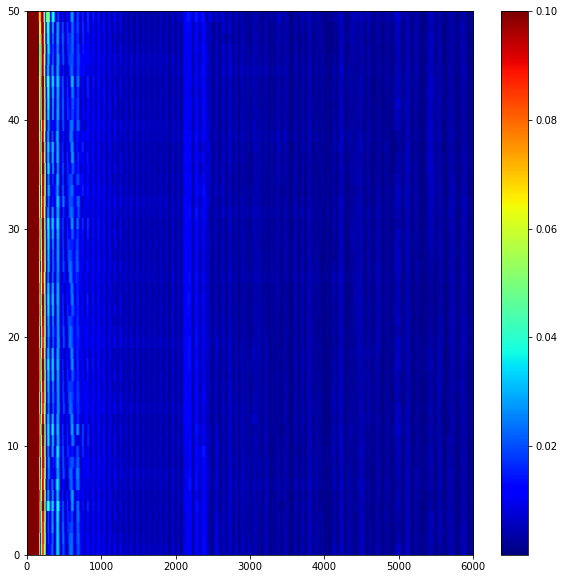

In [956]:
plt.figure(figsize=(10,10))
plt.imshow(pd.DataFrame(nc),cmap='jet', vmax=0.1, interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

In [957]:
trimmed_ir = pd.DataFrame(nc)

In [958]:
selected_session[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + selected_session[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3]

'20210224_18:08:37.805-20210224_18:09:11.272'

In [959]:
trimmed_ir.to_csv("processed/ir/" + selected_session[0].strftime("%Y%m%d_%H:%M:%S.%f")[:-3] + "-" + selected_session[1].strftime("%Y%m%d_%H:%M:%S.%f")[:-3], header=False,index=False)  

In [960]:
if not os.path.exists("processed/" + "/ir"):
    os.mkdir("processed/" + "/ir",0o777)
    
if not os.path.exists("processed/" + "/ir/" + date):
    os.mkdir("processed/" + "/ir/" + date,0o777)

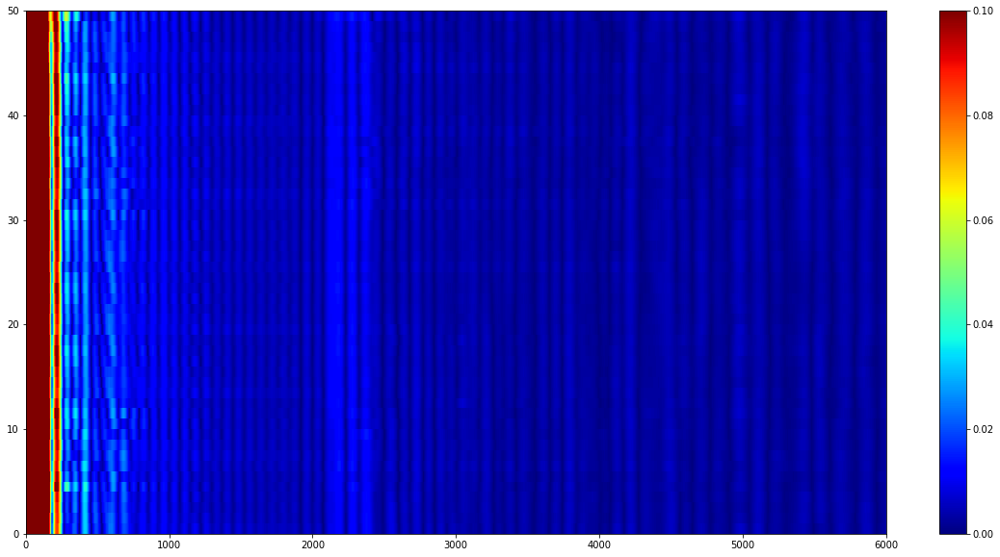

In [961]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc),vmax=0.1, vmin=0.0, cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

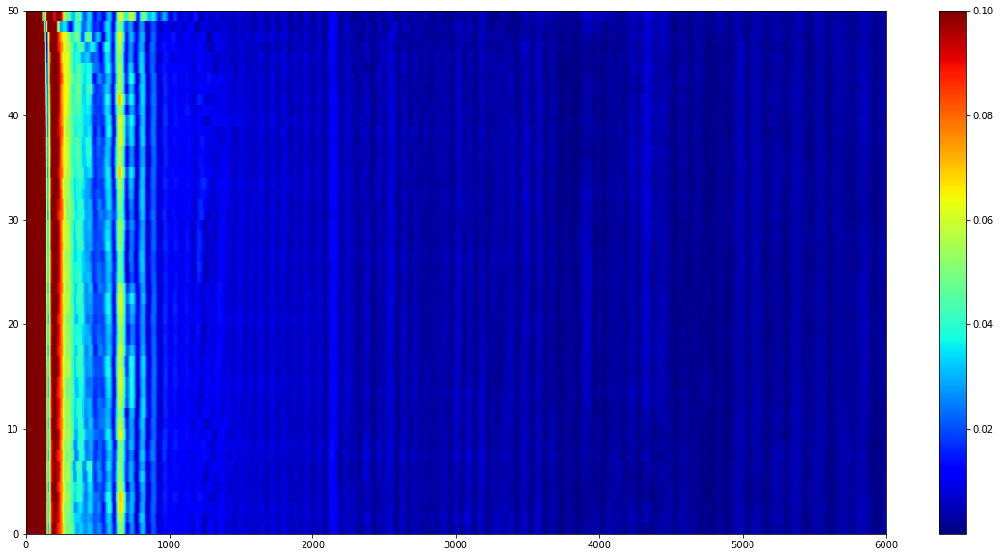

In [826]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc),vmax=0.1, cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

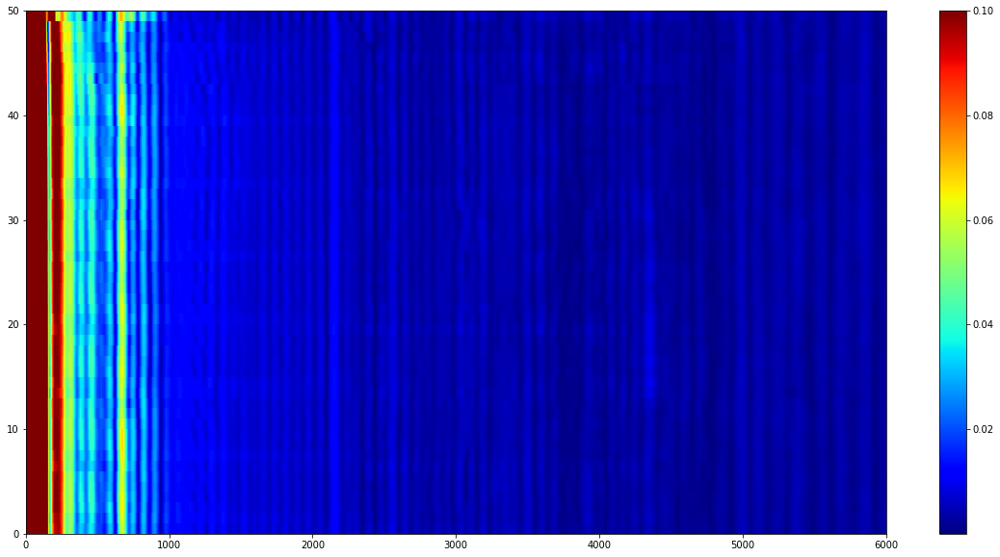

In [780]:
plt.figure(figsize=(20,10))
plt.imshow(pd.DataFrame(nc),vmax=0.1, cmap='jet', interpolation='nearest', origin='upper', extent=[0,len(nc[0]),0,len(nc)], aspect='auto')
plt.colorbar()

<Figure size 432x288 with 0 Axes>

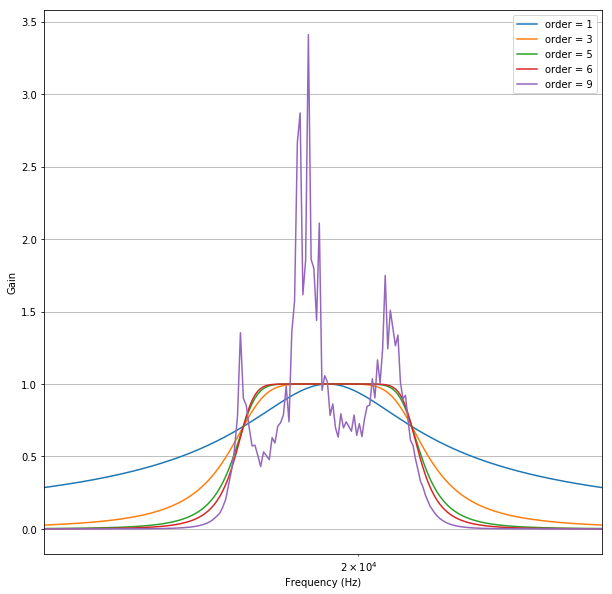

In [732]:
from scipy.signal import freqz  
# Sample rate and desired cutoff frequencies (in Hz).
fs = 192000
# Plot the frequency response for a few different orders.
plt.figure(1)
plt.figure(figsize=(10,10))
plt.clf()
res = []
for order in [1, 3, 5, 6, 9]:
    b, a = butter_bandpass(18000, 21000, fs, order=order)
    w, h = freqz(b, a, worN=2000)#np.logspace(-4, 3, 2000))
    plt.semilogx((fs * 0.5 / np.pi) * w, abs(h), label="order = %d" % order) 
    res.append(h)
    #plt.plot(h)
    #fig,ax = subplots()
    #plt.scatter(h.real,h.imag)
    #plt.show()
plt.xlim([15000,25000])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Gain')
plt.grid(True)
plt.legend(loc='best')

# plt.figure(2)
# plt.clf()
# for order in [1, 3, 5, 6, 9]:
#     b, a = butter_bandpass(18000, 21000, fs, order=order)
#     w, h = freqz(b, a, worN=2000)#np.logspace(-4, 3, 2000))
#     plt.semilogx((fs * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)  
# plt.xlabel('Frequency (Hz)')
# plt.ylabel('Gain')
# plt.grid(True)
# plt.legend(loc='best')

plt.show()

In [156]:
data_left

array([  0,   0,   0, ...,  66, 431, 114], dtype=int16)

In [157]:
data_right

array([  0,   0,   0, ...,  90, 466, 135], dtype=int16)

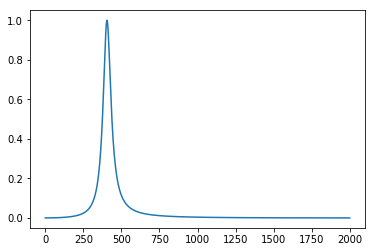

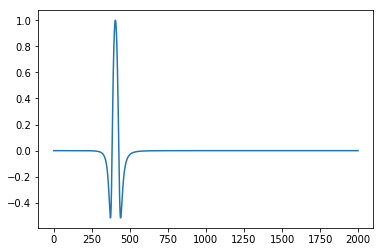

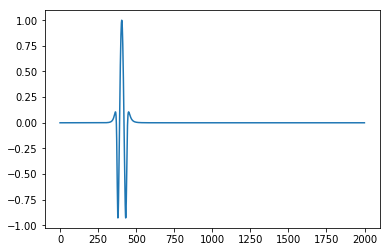

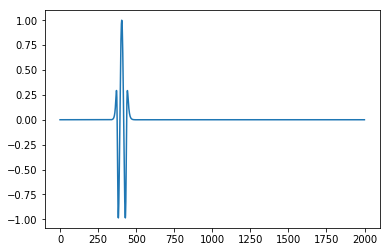

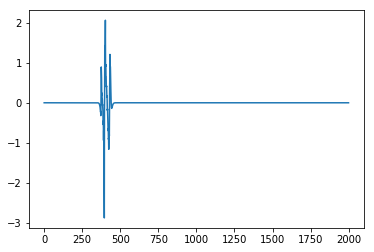

In [2489]:
for x in res:
    plt.plot(x)
    plt.show()

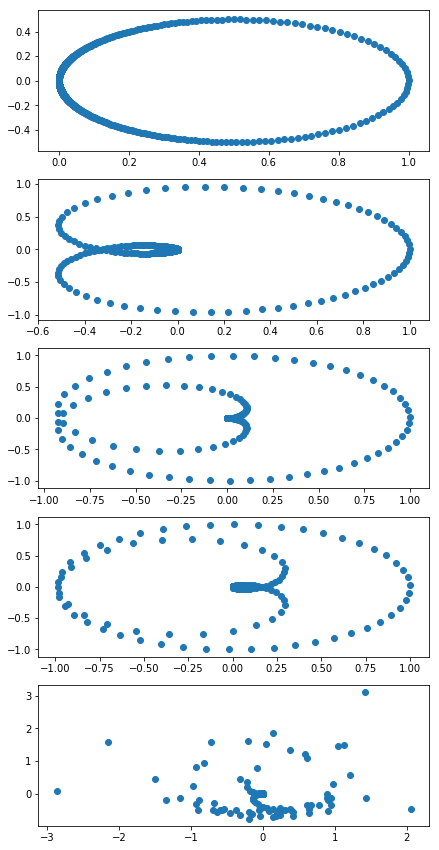

In [2495]:
fig,ax = subplots(5,figsize=(7,15))
c=0
for x in res:
    ax[c].scatter(x.real,x.imag)
    c=c+1

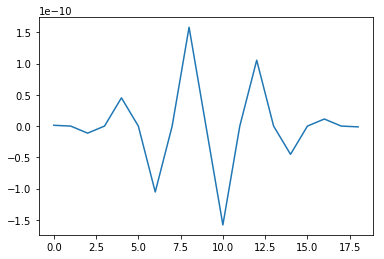

In [2472]:
plt.plot(b)

In [2475]:
h

array([ 1.73037895e-23+0.00000000e+00j, -1.97892972e-23+9.28845532e-25j,
       -1.60759308e-22-1.96305154e-26j, ...,
       -1.03571912e-31-2.79395315e-33j, -3.36011316e-31+1.66297890e-33j,
       -4.13759667e-32-1.99938279e-33j])

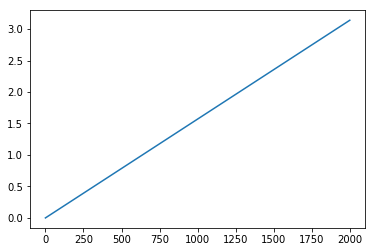

In [2477]:
plt.plot(w) #[0, pi) (radians/sample)